# <span style='color: blue'>P5 - Segmentez des clients d'un site e-commerce</span>

![logo_olist.png](logo_olist.png)

In [1]:
# Chargement des librairies
from datetime import datetime
import warnings
warnings.filterwarnings("ignore", message=".*The 'nopython' keyword.*")
import datetime as dt
import numpy as np
import pandas as pd
import sys
import time

# Librairies personnelles
import fonctions_data
import fonctions_segmentation

# Data visualisation
import matplotlib
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import statistics

# Pré processing
from sklearn.preprocessing import PowerTransformer, StandardScaler, \
    MinMaxScaler

# Réduction dimension
from sklearn.manifold import TSNE, Isomap
from sklearn.decomposition import PCA

# Clustering
from sklearn.cluster import KMeans
from sklearn import mixture, preprocessing
import hdbscan
from kmodes.kprototypes import KPrototypes

# Clustering Visualisation
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

# Clustering Metrics
from sklearn import metrics
from sklearn.metrics import davies_bouldin_score, silhouette_score, silhouette_samples


# Warnings
import warnings
warnings.filterwarnings('ignore')

# Versions
print('Version des librairies utilisées :')
print('Python                : ' + sys.version)
print('NumPy                 : ' + np.version.full_version)
print('Pandas                : ' + pd.__version__)
print('Matplotlib            : ' + mpl.__version__)
print('Seaborn               : ' + sns.__version__)

now = datetime.now().isoformat()
print('Lancé le           : ' + now)

Version des librairies utilisées :
Python                : 3.8.8 (default, Apr 13 2021, 15:08:03) [MSC v.1916 64 bit (AMD64)]
NumPy                 : 1.24.3
Pandas                : 1.5.3
Matplotlib            : 3.7.1
Seaborn               : 0.12.2
Lancé le           : 2023-11-11T13:53:14.820457


## <span style='background:lightblue'>2. Organisation du dataset</span>

### <span style='background:aquamarine'>2.1 Chargement du dataset</span>

In [2]:
# Chargement de la table des clients OLIST
data = pd.read_csv('OLIST_dataset_client_clean.csv')
data.set_index('customer_unique_id', inplace=True)
# Copie au cas où
data_clients = data.copy()

In [3]:
# Taille : nombre de lignes/colonnes
nRow, nVar = data.shape
print(f'Le jeu de données contient {nRow} lignes et {nVar} variables.')

Le jeu de données contient 91458 lignes et 20 variables.


In [4]:
# Contenu des 3 premières lignes
data.head(4)

,customer_city,rfm_recence,rfm_frequence,rfm_montant,note_avis_mean,date_premier_achat,premier_achat_jour,date_dernier_achat,dernier_achat_annee,dernier_achat_mois,dernier_achat_jour,dernier_achat_heure,dernier_achat_jour_prefere,nbr_commandes,nbr_articles_mean,panier_moyen,moyen_paiement_prefere,echeance_paiement_mean,frais_port_mean,cat_produit_prefere
customer_unique_id,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,cajamar,112.0,1.0,141.90,5.0,2018-05-10 10:56:27,112,2018-05-10 10:56:27,2018,5,10,10,3,1,1.0,129.90,credit_card,8.0,12.00,home
0000b849f77a49e4a4ce2b2a4ca5be3f,osasco,115.0,1.0,27.19,4.0,2018-05-07 11:11:27,115,2018-05-07 11:11:27,2018,5,7,11,0,1,1.0,18.90,credit_card,1.0,8.29,health_beauty
0000f46a3911fa3c0805444483337064,sao jose,537.0,1.0,86.22,3.0,2017-03-10 21:05:03,537,2017-03-10 21:05:03,2017,3,10,21,4,1,1.0,69.00,credit_card,8.0,17.22,office
0000f6ccb0745a6a4b88665a16c9f078,belem,321.0,1.0,43.62,4.0,2017-10-12 20:29:41,321,2017-10-12 20:29:41,2017,10,12,20,3,1,1.0,25.99,credit_card,4.0,17.63,electronics


In [4]:
# Nombre aléatoire pour la reproductibilité des résultats
seed = 21

### <span style='background:aquamarine'>2.2 Variables quantitatives standardisées</span>

In [5]:
# Copie du jeu de données
df_acp = data.copy()
df_acp.shape

(91458, 20)

In [6]:
# Sélection des variables numériques
cols_num = df_acp.select_dtypes(include=[np.number]).columns.to_list()
df_acp = df_acp[cols_num]
df_acp.shape

(91458, 15)

In [7]:
# Standardisation StandardScaler - variable non transformées en log
# -----------------------------------------------------------------------
# Préparation des données
X = df_acp.values
col_acp = df_acp.columns

# Standardisation avec StandardScaler (centre, réduit et rend plus la
# distribution plus normale)
# On centre et réduit les données
std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

# Dataframe
X_scaled = pd.DataFrame(X_scaled,
                        index=df_acp.index,
                        columns=col_acp)

### <span style='background:aquamarine'>2.2 Variables quantitatives standardisées en log</span>

In [8]:
# Copie du jeu de données
df_acp_log = data.copy()
df_acp_log.shape

(91458, 20)

In [9]:
# Sélection des variables numériques
cols_num_log = df_acp_log.select_dtypes(include=[np.number]).columns.to_list()
df_acp_log = df_acp_log[cols_num_log]
df_acp_log.shape

(91458, 15)

In [11]:
# Statistiques descriptives
fonctions_data.stat_descriptives(df_acp_log)

,Variable name,Mean,Median,Skew,Kurtosis,Variance,Stdev,min,25%,50%,75%,max
0,rfm_recence,237.078058,218.00,0.451155,-0.659537,23270.776026,152.547619,1.00,114.00,218.00,345.00,695.00
1,rfm_frequence,1.237563,1.00,15.910699,812.792018,0.713021,0.844406,1.00,1.00,1.00,1.00,75.00
2,rfm_montant,212.338235,112.84,71.627964,10408.196180,398609.945786,631.355641,9.59,63.86,112.84,202.76,109312.64
3,note_avis_mean,4.154728,5.00,-1.479433,0.963995,1.636346,1.279197,1.00,4.00,5.00,5.00,5.00
4,premier_achat_jour,239.682466,220.00,0.433755,-0.682499,23427.245616,153.059615,1.00,115.00,220.00,350.00,696.00
5,dernier_achat_annee,2017.551969,2018.00,-0.273007,-1.760524,0.252722,0.502715,2016.00,2017.00,2018.00,2018.00,2018.00
6,dernier_achat_mois,6.039843,6.00,0.205697,-0.960671,10.341521,3.215824,1.00,3.00,6.00,8.00,12.00
7,dernier_achat_jour,15.510158,15.00,0.022546,-1.175677,75.097455,8.665879,1.00,8.00,15.00,23.00,31.00
8,dernier_achat_heure,14.789455,15.00,-0.601299,0.184909,28.273434,5.317277,0.00,11.00,15.00,19.00,23.00
9,dernier_achat_jour_prefere,2.755844,3.00,0.168459,-1.167788,3.870629,1.967391,0.00,1.00,3.00,4.00,6.00


**Transformation logarithmique des variables**

In [10]:
# Transformation en logarithme pour avoir le même poids
col_to_log = cols_num_log
df_acp_log[col_to_log] = df_acp[col_to_log].apply(np.log1p, axis=1)

In [12]:
# Statistiques descriptives
fonctions_data.stat_descriptives(df_acp_log)

,Variable name,Mean,Median,Skew,Kurtosis,Variance,Stdev,min,25%,50%,75%,max
0,rfm_recence,5.160845,5.389072,-1.215410,1.315368,8.750393e-01,0.935435,0.693147,4.744932,5.389072,5.846439,6.545350
1,rfm_frequence,0.773785,0.693147,3.463535,16.235906,4.719615e-02,0.217247,0.693147,0.693147,0.693147,0.693147,4.330733
2,rfm_montant,4.813242,4.734794,0.750297,1.019521,8.249216e-01,0.908252,2.359910,4.172231,4.734794,5.316943,11.601976
3,note_avis_mean,1.594256,1.791759,-1.867659,2.256631,1.121359e-01,0.334867,0.693147,1.609438,1.791759,1.791759,1.791759
4,premier_achat_jour,5.175225,5.398163,-1.230339,1.364610,8.666312e-01,0.930930,0.693147,4.753590,5.398163,5.860786,6.546785
5,dernier_achat_annee,7.610136,7.610358,-0.273069,-1.760253,6.202882e-08,0.000249,7.609367,7.609862,7.610358,7.610358,7.610358
6,dernier_achat_mois,1.826245,1.945910,-0.611231,-0.504044,2.829409e-01,0.531922,0.693147,1.386294,1.945910,2.197225,2.564949
7,dernier_achat_jour,2.605392,2.772589,-0.973285,0.163261,5.026153e-01,0.708954,0.693147,2.197225,2.772589,3.178054,3.465736
8,dernier_achat_heure,2.655970,2.772589,-2.980122,10.577882,3.228998e-01,0.568243,0.000000,2.484907,2.772589,2.995732,3.178054
9,dernier_achat_jour_prefere,1.147564,1.386294,-0.591013,-0.824089,4.090070e-01,0.639537,0.000000,0.693147,1.386294,1.609438,1.945910


**Standardisation des variables transformées**

In [11]:
# Standardisation StandardScaler - variable transformées en log
# -----------------------------------------------------------------------
# Préparation des données
X_log = df_acp_log.values
col_acp_log = df_acp_log.columns

# Standardisation avec StandardScaler (centre, réduit et rend plus la
# distribution plus normale)
# On centre et réduit les données
std_scale = preprocessing.StandardScaler().fit(X_log)
X_scaled_log = std_scale.transform(X_log)

# Dataframe
X_scaled_log = pd.DataFrame(X_scaled_log,
                        index=df_acp_log.index,
                        columns=col_acp_log)

### <span style='background:aquamarine'>2.3 Transformation des variables quantitatives + qualitatives encodées en log</span>

In [12]:
# Copie du jeu de données
df_acp_cat = data.copy()

# Suppression des variables date de première et dernière commande
df_acp_cat.drop(columns=['date_premier_achat', 'date_dernier_achat'],
                inplace=True)

In [13]:
# Sélection des variables numériques
cols_num_cat = df_acp_cat.select_dtypes(include=[np.number]) \
    .columns.to_list()

**Transformation logarithmique**

In [14]:
# Transformation en logarithme pour avoir le même poids
col_cat_log = cols_num_cat
df_acp_cat[col_cat_log] = df_acp_cat[col_cat_log].apply(np.log1p, axis=1)

In [15]:
# Standardisation StandardScaler - variable transformées en log
# -----------------------------------------------------------------------
# Préparation des données
X_cat_log = df_acp_cat[cols_num_cat].values
features_acp_cat = df_acp_cat[cols_num_cat].columns

# Standardisation avec StandardScaler (centre, réduit et rend plus la
# distribution plus normale)
scaler = StandardScaler()
X_scaled_cat = scaler.fit_transform(X_cat_log)

# Dataframe
X_scaled_cat = pd.DataFrame(X_scaled_cat,
                            index=df_acp_cat[col_cat_log].index,
                            columns=features_acp_cat)

**Encodage**

In [16]:
# Encodage du moyen de paiement préféré- binarisation variable catégorielle
encod_paiement = pd.get_dummies(df_acp_cat['moyen_paiement_prefere'])
X_scaled_cat = X_scaled_cat.join(encod_paiement)

In [17]:
# Encodage de la catégorie préférée- binarisation variable catégorielle
encod_cat_pref = pd.get_dummies(df_acp_cat['cat_produit_prefere'])
X_scaled_cat = X_scaled_cat.join(encod_cat_pref)

## <span style='background:lightblue'>3. Réduction de dimensions</span>

### <span style='background:aquamarine'>3.1 ACP</span>

<span style='background:gold'>**3.1.1 ACP sur les variables quantitatives**</span>

<span style='background:lavender'>**Variables sans  transformation logarithmique, et standardisation**</span>

In [18]:
# Reprise des 15 variables numériques
N_COMP = 15

# Analyse en composante principale
pca = decomposition.PCA(n_components=N_COMP)
pca.fit(X_scaled)

PCA(n_components=15)

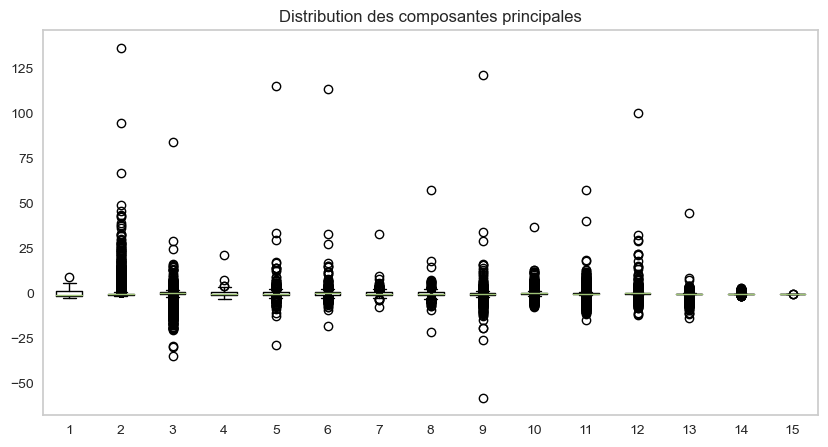

In [22]:
# Composantes principales de l'ACP
C = pca.transform(X_scaled)
plt.figure(figsize=(10, 5))
plt.boxplot(C)
plt.title('Distribution des composantes principales')
plt.grid(False)
plt.show()

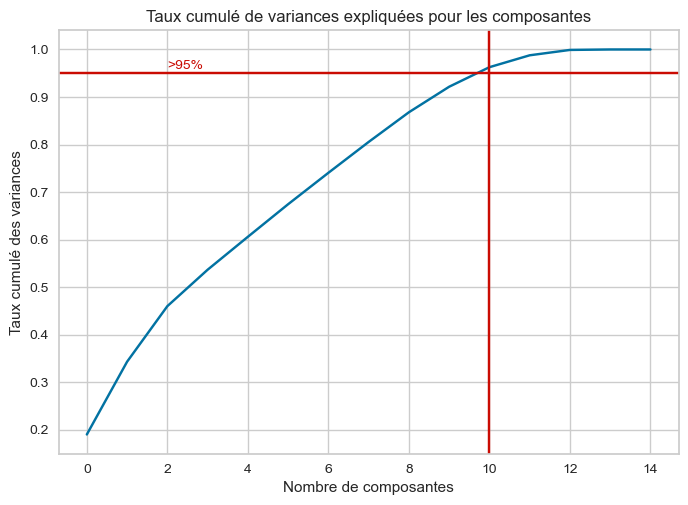

In [23]:
# quel est le pourcentage de variance préservée par chacune de
# nos composantes?
variances = pca.explained_variance_ratio_

# quelle est la somme cumulée de chacune de ces variances?
meilleur_dims = np.cumsum(variances)

#  on va trouver le moment où on attient 95% ou 99% entre réduire au maxi
# où garder au maxi
plt.plot(meilleur_dims)
# argmax pour > 95 %
best = np.argmax(meilleur_dims > 0.95)
plt.axhline(y=0.95, color='r')
plt.text(2, 0.96, '>95%', color='r', fontsize=10)
plt.axvline(x=best, color='r')
plt.title('Taux cumulé de variances expliquées pour les composantes')
plt.xlabel('Nombre de composantes')
plt.ylabel('Taux cumulé des variances')
plt.show()

In [ ]:
# Matrice des coefficients des composantes principales
fig, ax = plt.subplots(figsize=(8, 4))
palette = sns.diverging_palette(240, 10, n=15)
ax = sns.heatmap(df_acp, annot=True, fmt='.2f',
                 cmap=palette, vmin=-1, vmax=1, center=0)
plt.title('Coefficient des composantes principales', fontsize=14)
plt.show()

**Affichage valeurs propres**

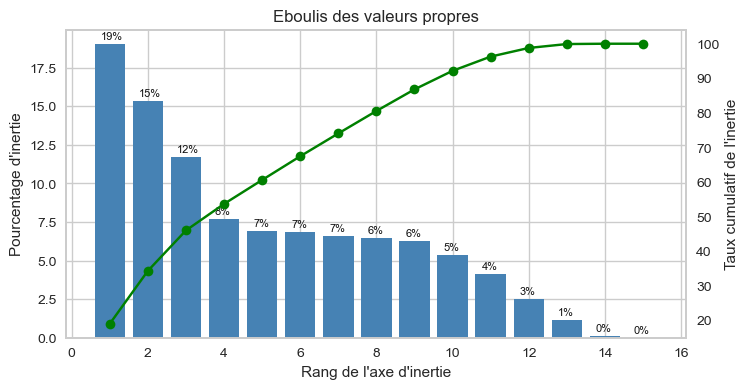

In [24]:
fonctions_data.aff_eboulis_plot(pca)

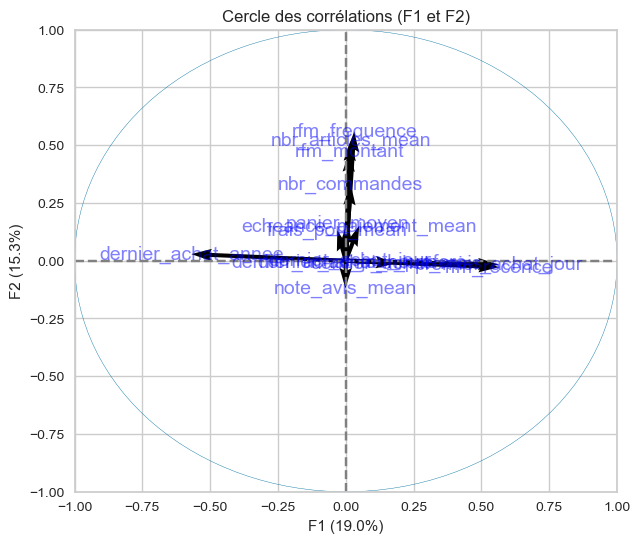

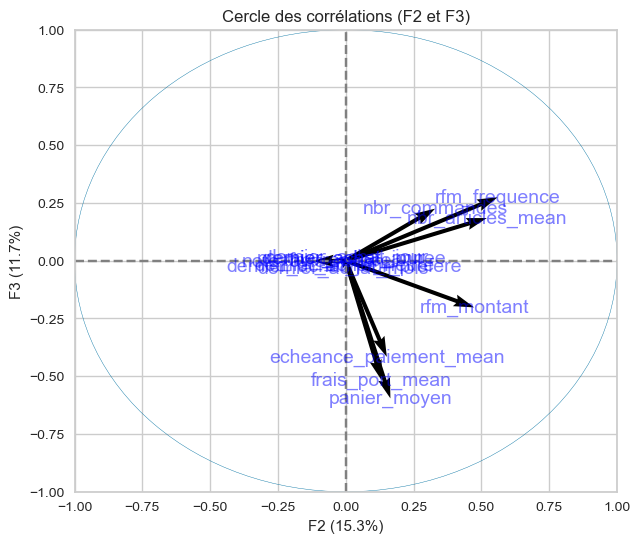

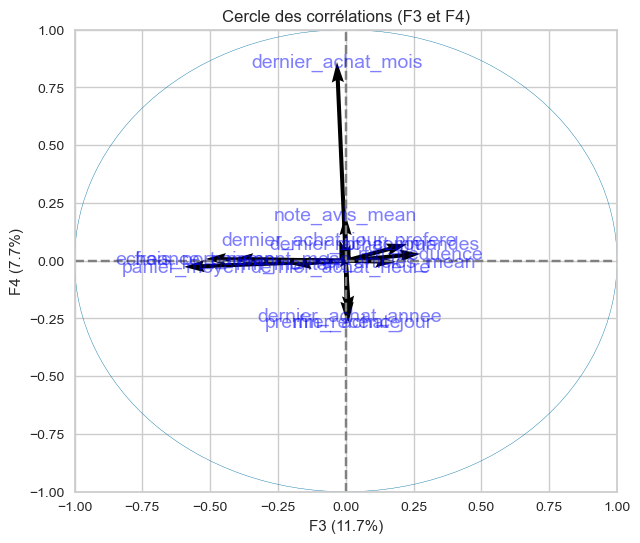

In [27]:
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
import numpy as np
import pandas as pd

# Cercle des correlations
pcs = pca.components_
liste_tuples_comp = [(0, 1), (1, 2), (2, 3)]
fonctions_data.affiche_cercle(pcs, N_COMP, pca, liste_tuples_comp, labels=np.array(col_acp), label_rotation=0, lims=None)

- Il faut conserver les 10 variables pour expliquer plus de 90% de la variance.
- La première dimension représente les commandes récentes, cients fidèles.
- La seconde dimension représente les clients dépensiers avec des commandes fréquentes et des montants corrects.
- La troisième dimension montre que l'importance du nombre de commande, d'article et du montant du panier moyen.
- La quatrième dimension représente l'importance de la récence d'achat sur le mois en cours.

In [24]:
# ACP avec 10 composantes
n_comp = 10
pca = PCA(n_components=n_comp, random_state=seed)
pca.fit(X_scaled)
X_projected_acp = pca.transform(X_scaled)

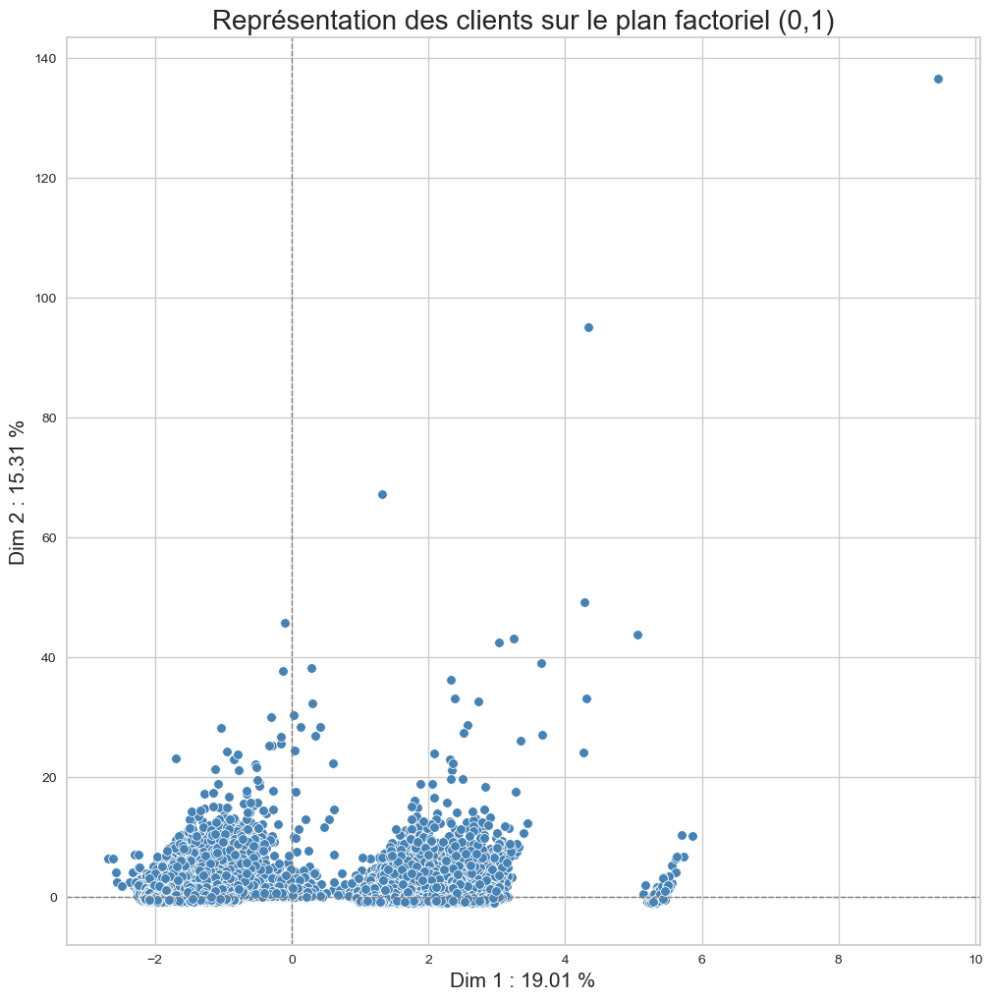

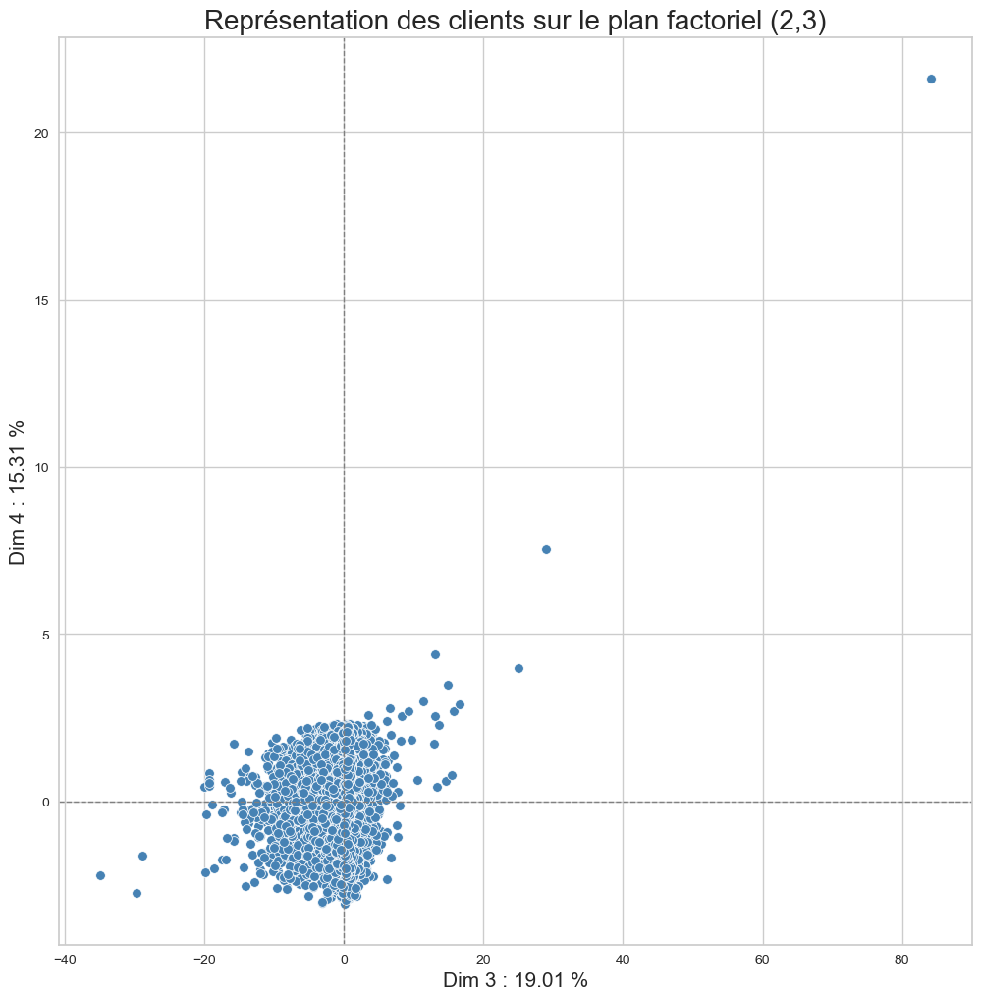

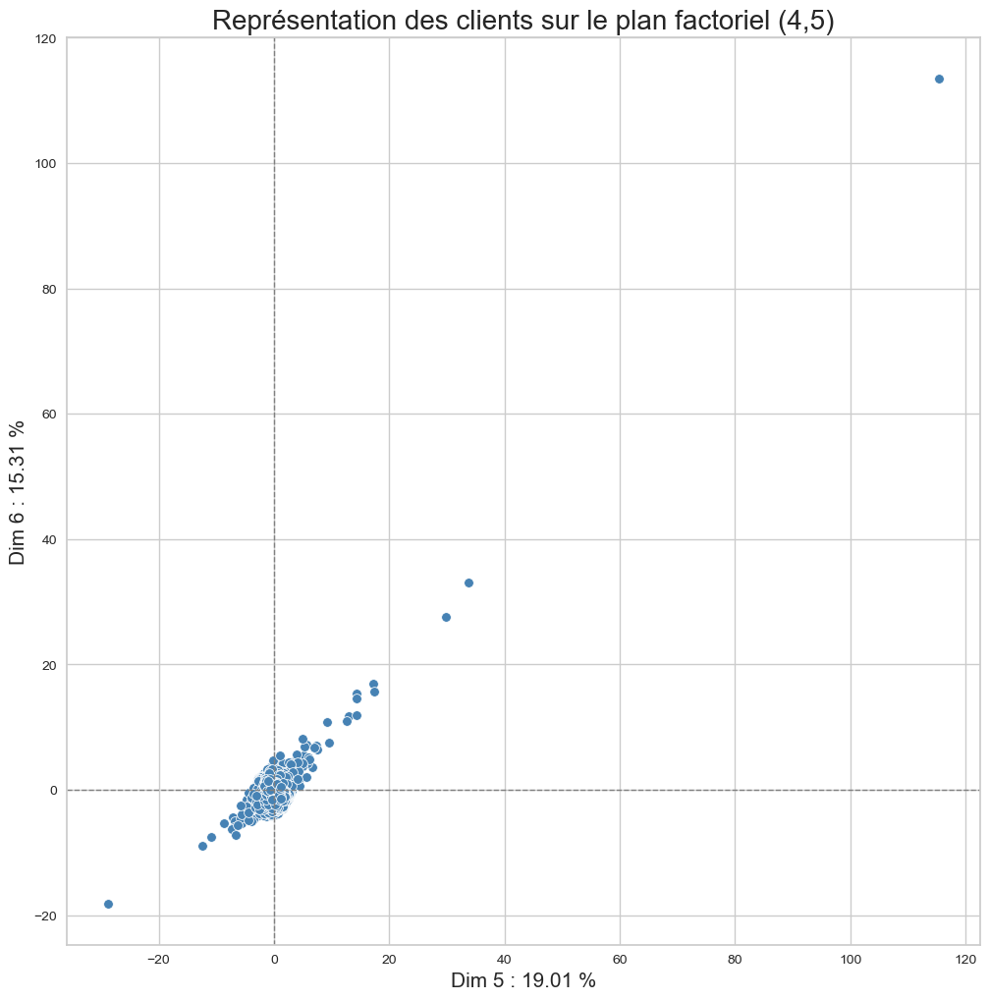

In [26]:
liste_plans_fact = [(0, 1), (2, 3), (4, 5)]
fonctions_data.projeter_plans_factoriels(X_projected_acp, pca,
                                     liste_plans_fact)

<span style='background:lavender'>**Variables avec log et standardisation**</span>

In [25]:
# Reprise des 15 variables numériques
N_COMP = 15

# Analyse en composante principale
pca = decomposition.PCA(n_components=N_COMP)
pca.fit(X_scaled_log)

PCA(n_components=15)

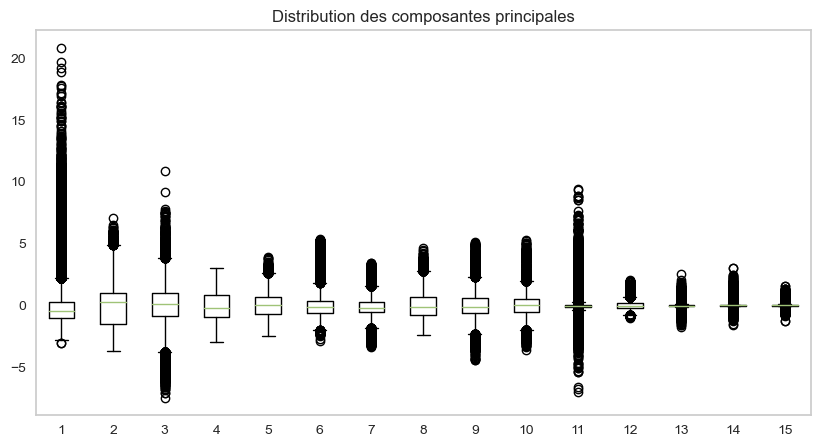

In [30]:
# Composantes principales de l'ACP
C = pca.transform(X_scaled_log)
plt.figure(figsize=(10, 5))
plt.boxplot(C)
plt.title('Distribution des composantes principales')
plt.grid(False)
plt.show()

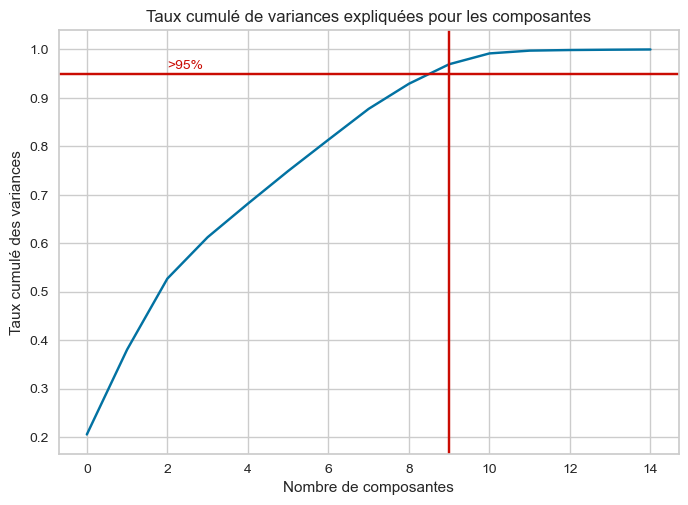

In [31]:
# quel est le pourcentage de variance préservée par chacune de
# nos composantes?
variances = pca.explained_variance_ratio_

# quelle est la somme cumulée de chacune de ces variances?
meilleur_dims = np.cumsum(variances)

#  on va trouver le moment où on attient 95% ou 99% entre réduire au maxi
# où garder au maxi
plt.plot(meilleur_dims)
# argmax pour > 95 %
best = np.argmax(meilleur_dims > 0.95)
plt.axhline(y=0.95, color='r')
plt.text(2, 0.96, '>95%', color='r', fontsize=10)
plt.axvline(x=best, color='r')
plt.title('Taux cumulé de variances expliquées pour les composantes')
plt.xlabel('Nombre de composantes')
plt.ylabel('Taux cumulé des variances')
plt.show()

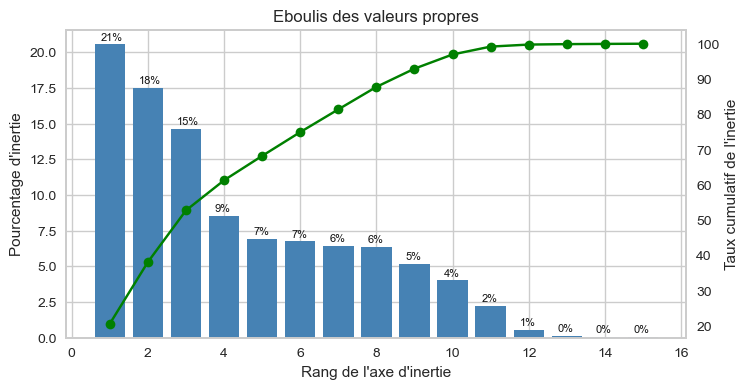

In [32]:
fonctions_data.aff_eboulis_plot(pca)

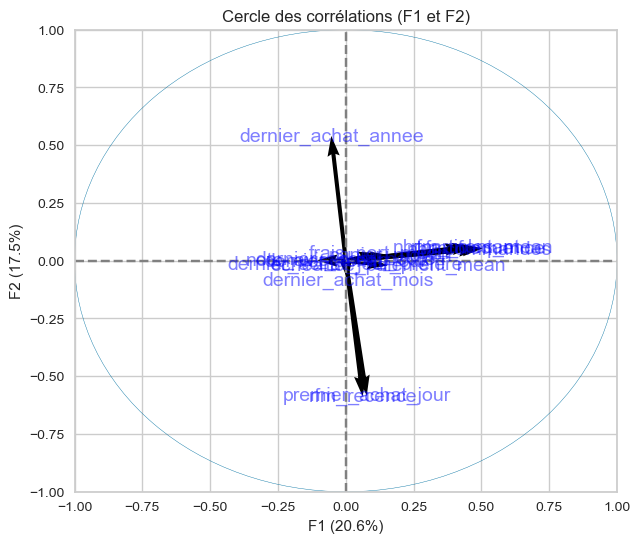

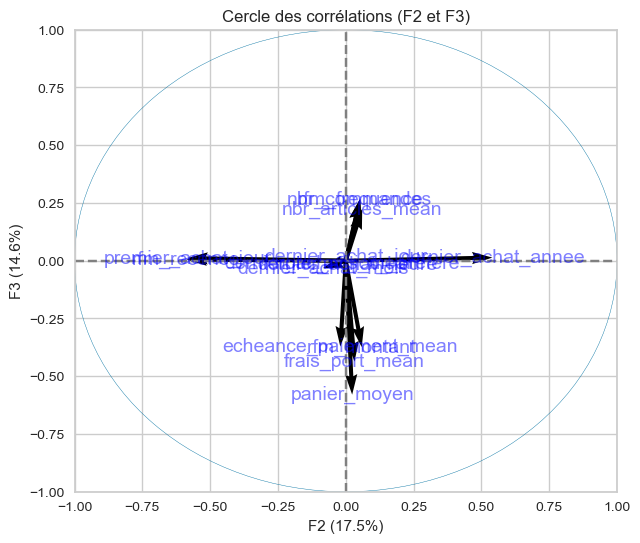

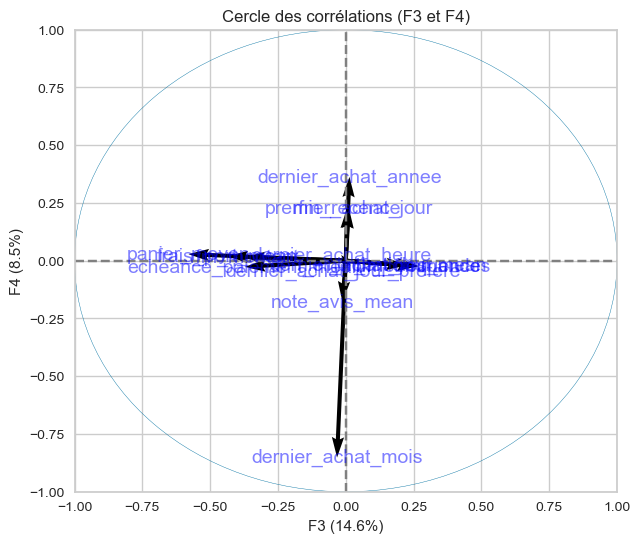

In [33]:
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
import numpy as np
import pandas as pd

# Cercle des correlations
pcs = pca.components_
liste_tuples_comp = [(0, 1), (1, 2), (2, 3)]
fonctions_data.affiche_cercle(pcs, N_COMP, pca, liste_tuples_comp, labels=np.array(col_acp), label_rotation=0, lims=None)

- Il faut conserver les **9 variables** pour **expliquer plus de 90% de la variance**.
- La première dimension représente les commandes récentes, cients fidèles.
- La seconde dimension représente les clients dépensiers avec des commandes fréquentes et des montants corrects.
- La troisième dimension montre que l'importance du nombre de commande, d'article et du montant du panier moyen.
- La quatrième dimension représente les commandes récentes sur le mois en cours et l'année.

In [26]:
# ACP avec 10 composantes
n_comp = 10
pca = PCA(n_components=n_comp, random_state=seed)
pca.fit(X_scaled_log)
X_projected_acp = pca.transform(X_scaled_log)

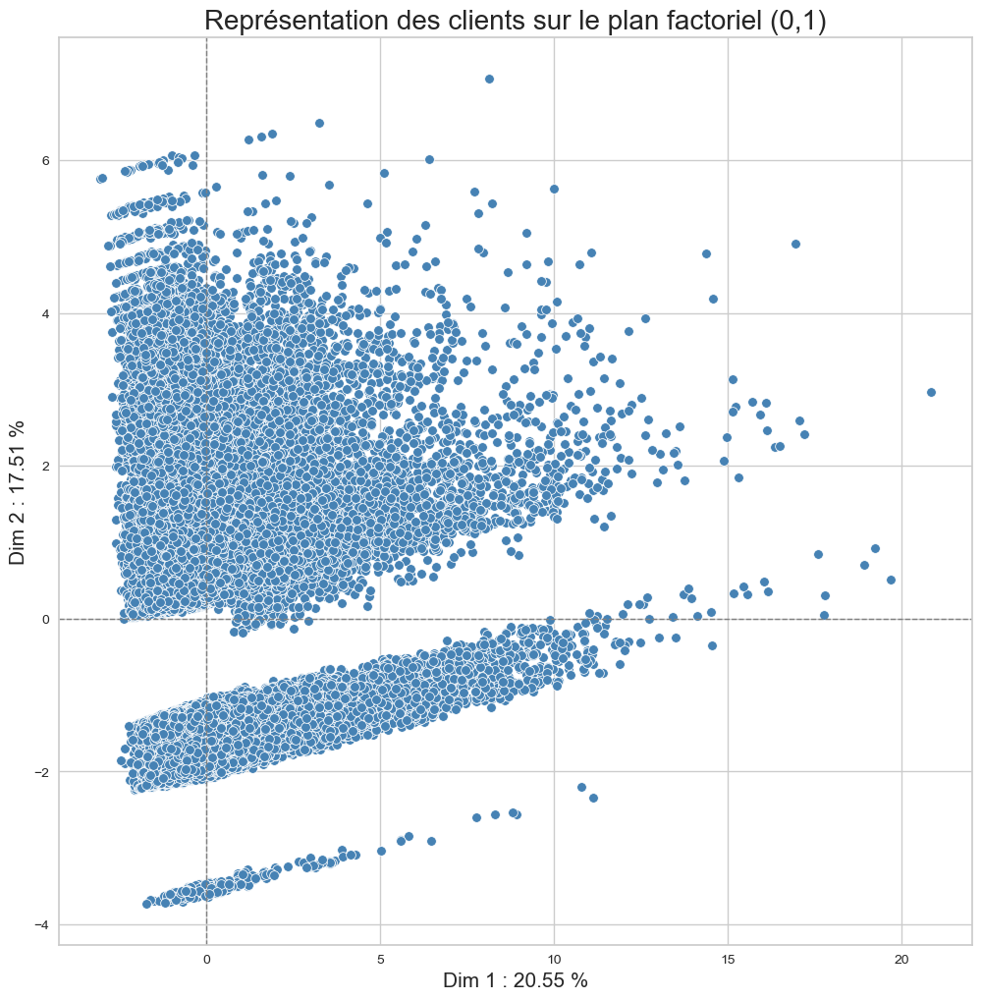

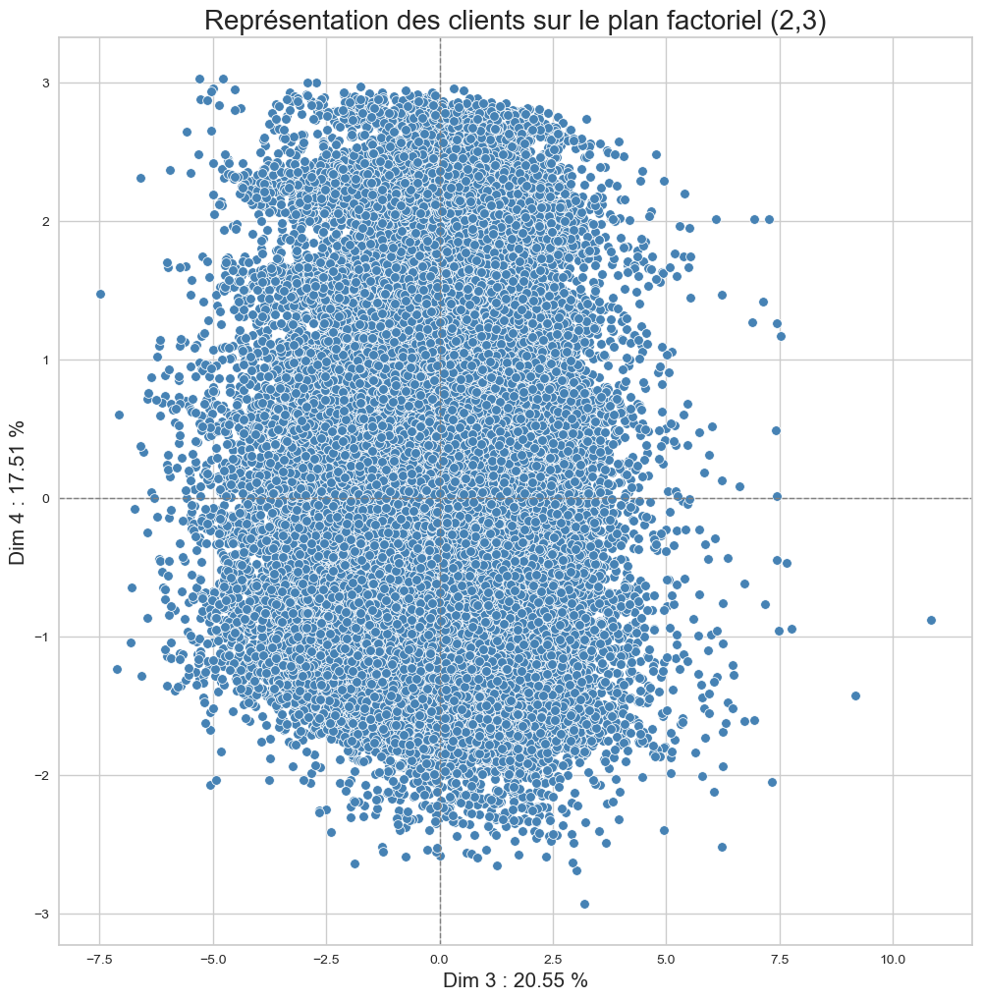

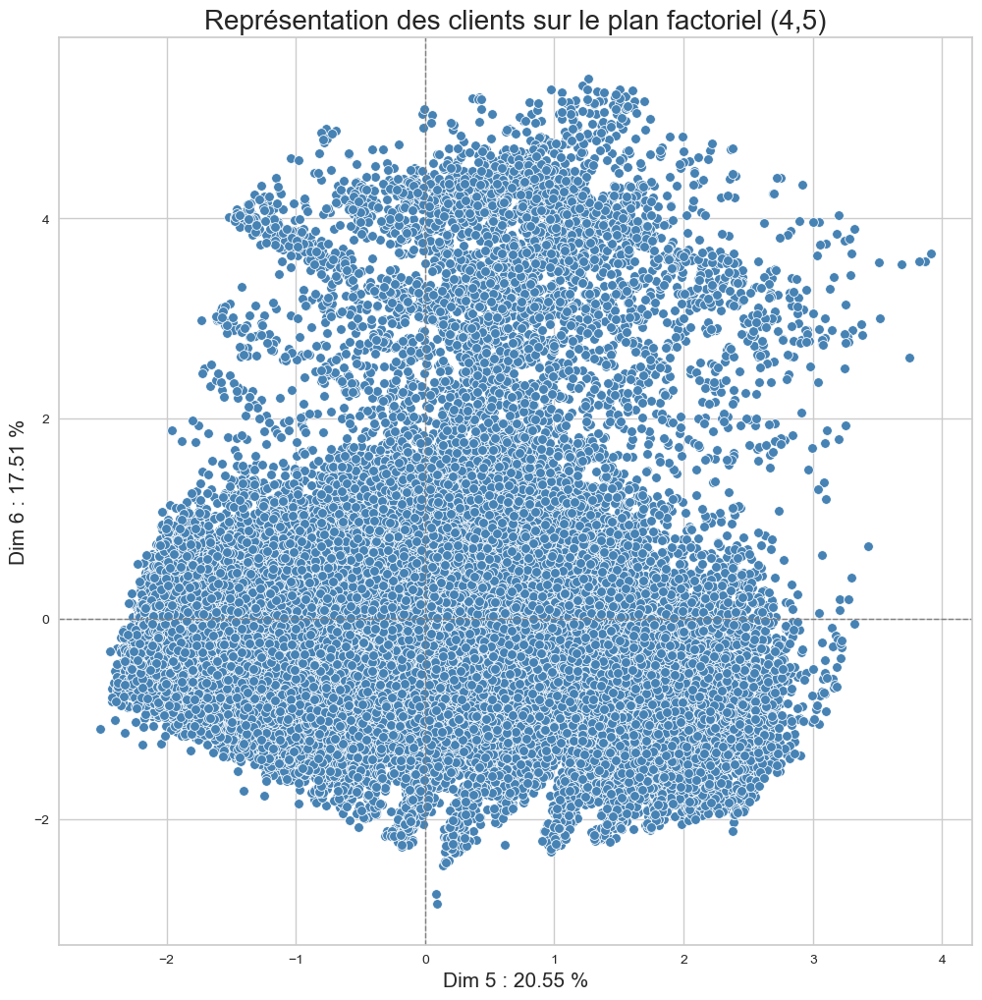

In [35]:
liste_plans_fact = [(0, 1), (2, 3), (4, 5)]
fonctions_data.projeter_plans_factoriels(X_projected_acp, pca,
                                     liste_plans_fact)

<span style='background:gold'>**3.1.2 ACP sur les variables qualitatives**</span>

<span style='background:lavender'>**Variables avec log, encodage et standardisation**</span>

In [27]:
# Reprise des  variables catégorielles
N_COMP = 32

# Analyse en composante principale
pca = decomposition.PCA(n_components=N_COMP)
pca.fit(X_scaled_cat)

PCA(n_components=32)

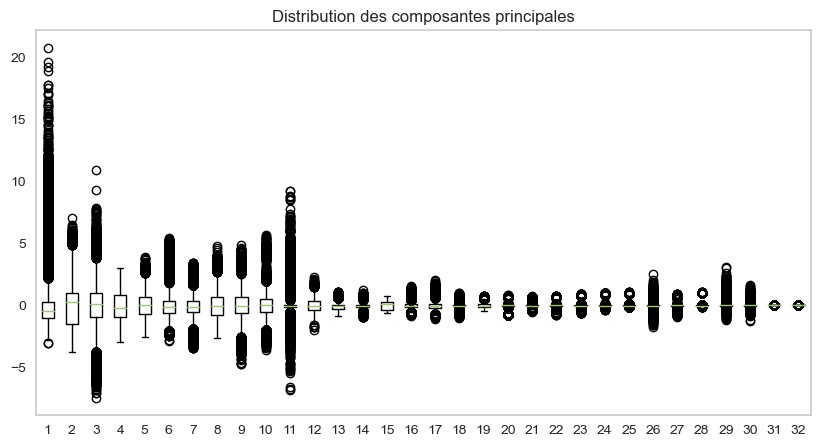

In [25]:
# Composantes principales de l'ACP
C = pca.transform(X_scaled_cat)
plt.figure(figsize=(10, 5))
plt.boxplot(C)
plt.title('Distribution des composantes principales')
plt.grid(False)
plt.show()

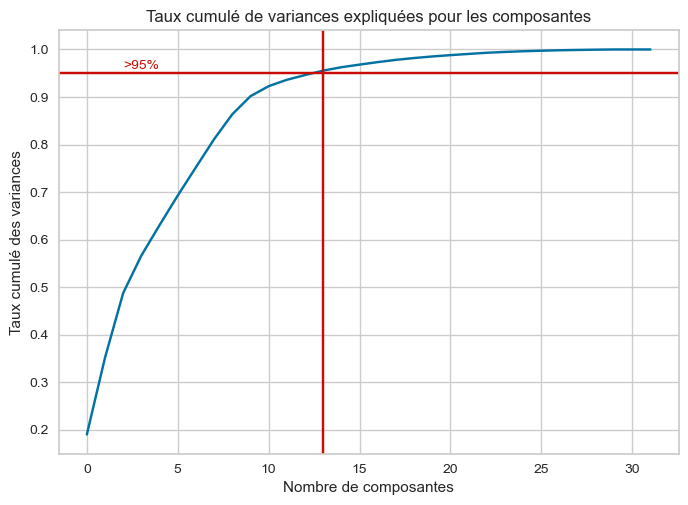

In [23]:
# quel est le pourcentage de variance préservée par chacune de
# nos composantes?
variances = pca.explained_variance_ratio_

# quelle est la somme cumulée de chacune de ces variances?
meilleur_dims = np.cumsum(variances)

#  on va trouver le moment où on attient 95% ou 99% entre réduire au maxi
# où garder au maxi
plt.plot(meilleur_dims)
# argmax pour > 95 %
best = np.argmax(meilleur_dims > 0.95)
plt.axhline(y=0.95, color='r')
plt.text(2, 0.96, '>95%', color='r', fontsize=10)
plt.axvline(x=best, color='r')
plt.title('Taux cumulé de variances expliquées pour les composantes')
plt.xlabel('Nombre de composantes')
plt.ylabel('Taux cumulé des variances')
plt.show()

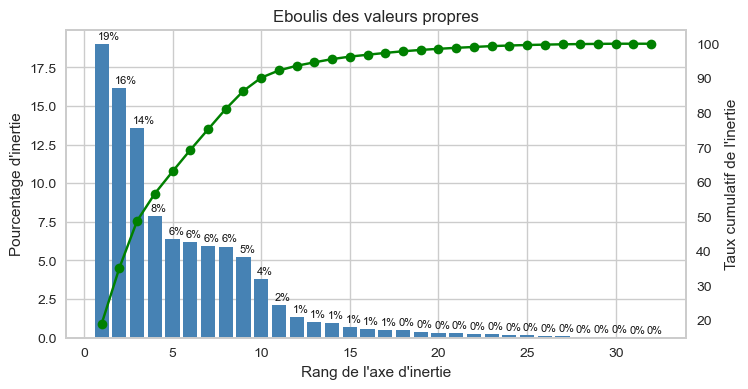

In [24]:
fonctions_data.aff_eboulis_plot(pca)

In [25]:
# # Cercle des correlations
# pcs = pca.components_
# liste_tuples_comp = [(0, 1), (1, 2), (2, 3)]
# fonctions_data.affiche_cercle(pcs, N_COMP, pca, liste_tuples_comp, labels=np.array(cols_num_cat), label_rotation=0, lims=None)

In [28]:
# ACP avec 9 composantes
n_comp_log = 9
pca_log = PCA(n_components=n_comp_log)
pca_log.fit(X_scaled_log)
X_projected_log_acp = pca_log.transform(X_scaled_log)

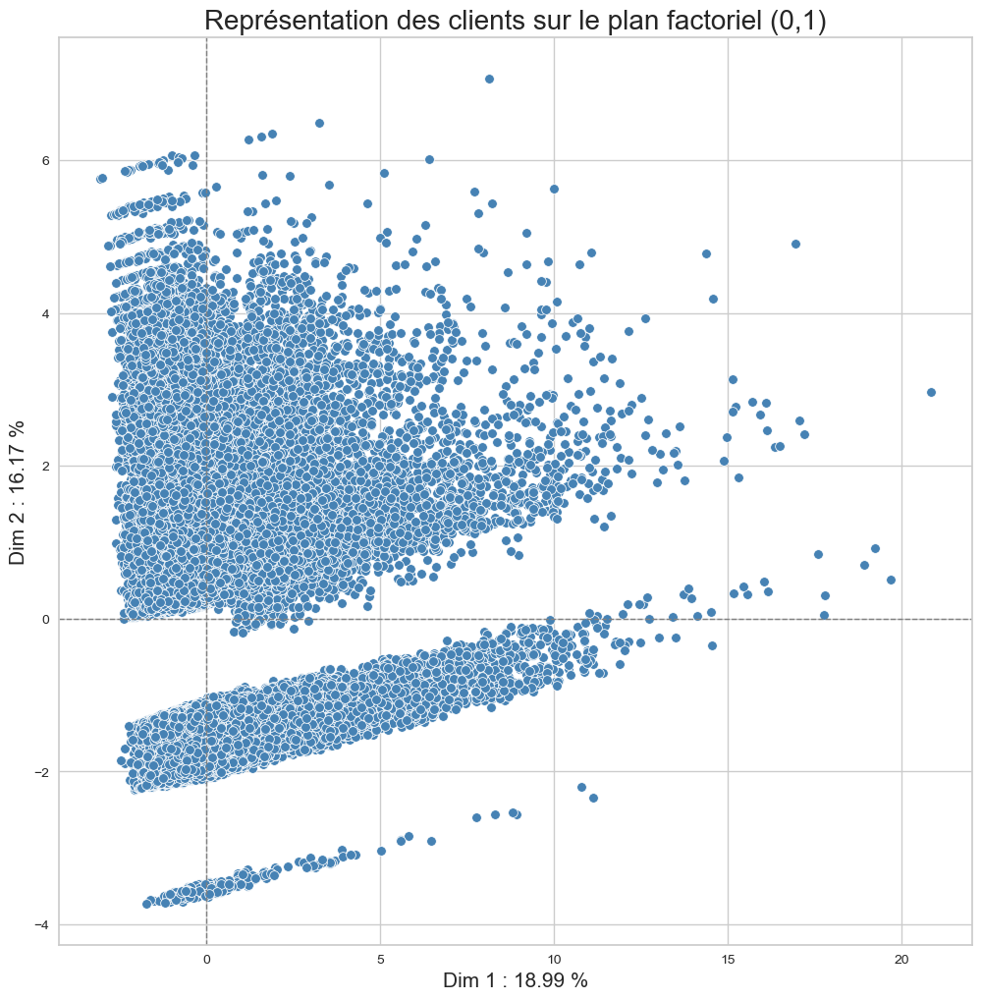

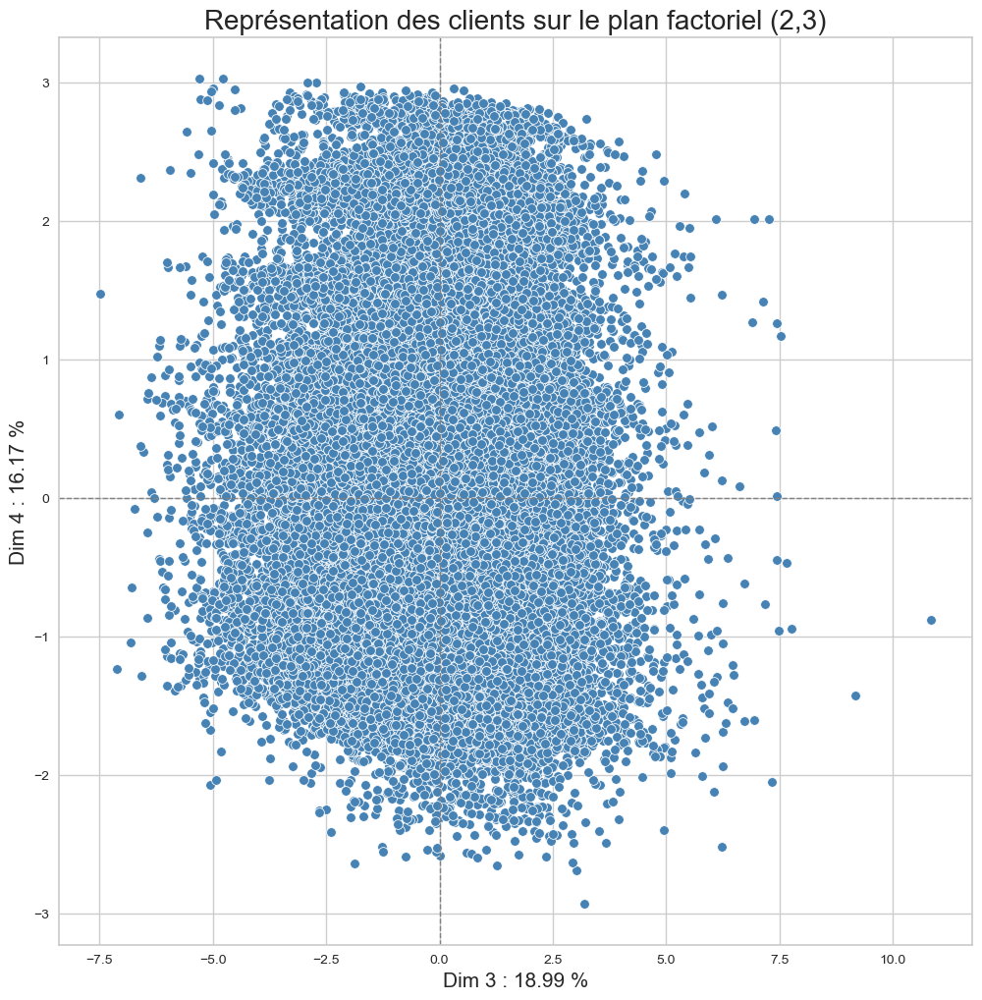

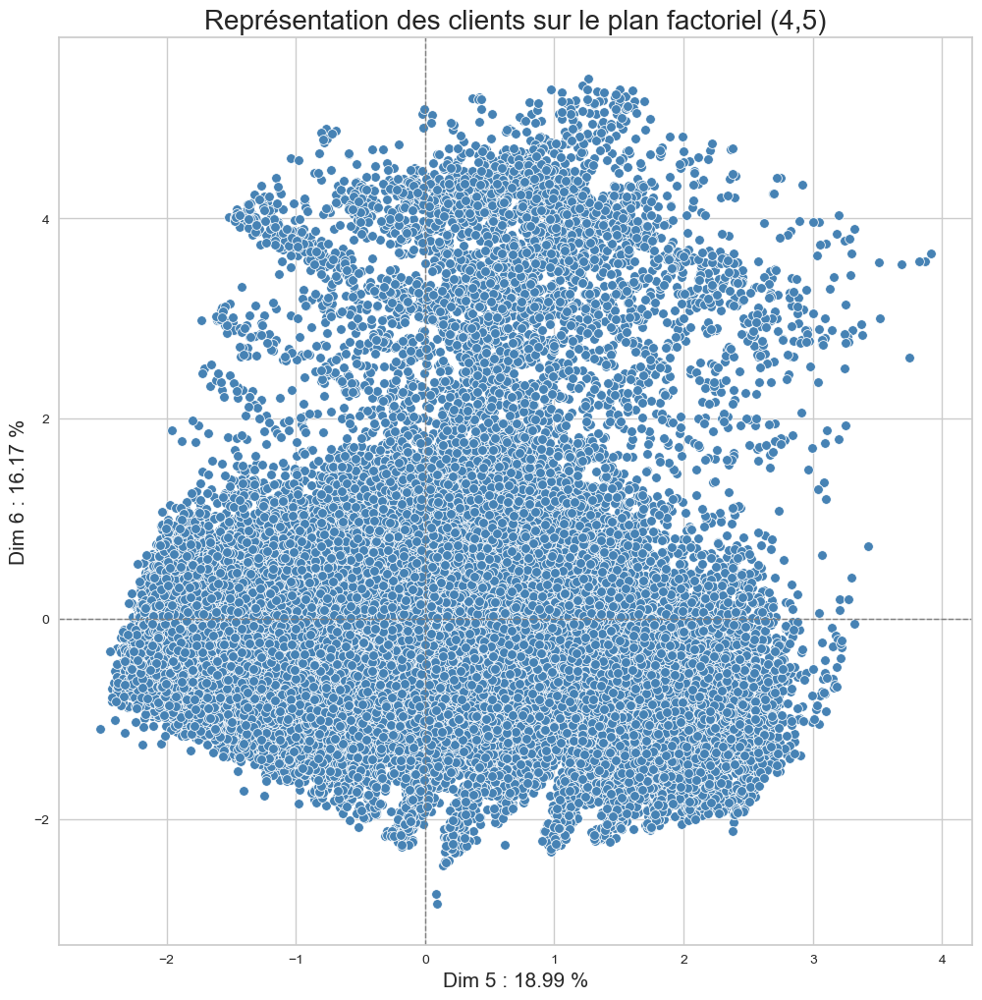

In [27]:
liste_plans_fact = [(0, 1), (2, 3), (4, 5)]
fonctions_data.projeter_plans_factoriels(X_projected_log_acp, pca,
                                     liste_plans_fact)

**Bilan :**

L'analyse en composante principale avec les données quantitatives transformées en logarithme, sans l'ajout des données qualitatives, donne des projections plus homogènes et plus distantes. Elle sera utilisée pour la suite de l'analyse.
L'ajout des variables catégorielles encodées n'apportent rien de plus, ce n'est pas une suprise car pour le moyen de paiement 97% des clients paient en carte de crédit à débit différé et pour les catégories de produits préférés, 96% des clients n'effectuent qu'une seule commande.

In [29]:
# Constitution du dataframe de travail avec la projections des 9
# composantes de l'ACP
df_clients_acp = pd.DataFrame(X_projected_log_acp,
                              index=df_acp_log.index,
                              columns=["F"+str(i+1)for i in range(9)])
df_clients_acp.shape

(91458, 9)

### <span style='background:aquamarine'>3.2 t-SNE</span>

<span style='background:gold'>**3.2.1. TSNE sans initialisation PCA**</span>

In [68]:
# t-SNE tuning deu paramètre perplexity sans initialisation PCA
top_depart = time.time()
results_list = list()
tsne_results = []
for i in [5, 10, 20, 30, 40, 50]:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=300,
                random_state=seed)
    tsne_results = tsne.fit_transform(X_scaled)
    results_list.append(tsne_results)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 91458 samples in 0.395s...
[t-SNE] Computed neighbors for 91458 samples in 115.847s...
[t-SNE] Computed conditional probabilities for sample 1000 / 91458
[t-SNE] Computed conditional probabilities for sample 2000 / 91458
[t-SNE] Computed conditional probabilities for sample 3000 / 91458
[t-SNE] Computed conditional probabilities for sample 4000 / 91458
[t-SNE] Computed conditional probabilities for sample 5000 / 91458
[t-SNE] Computed conditional probabilities for sample 6000 / 91458
[t-SNE] Computed conditional probabilities for sample 7000 / 91458
[t-SNE] Computed conditional probabilities for sample 8000 / 91458
[t-SNE] Computed conditional probabilities for sample 9000 / 91458
[t-SNE] Computed conditional probabilities for sample 10000 / 91458
[t-SNE] Computed conditional probabilities for sample 11000 / 91458
[t-SNE] Computed conditional probabilities for sample 12000 / 91458
[t-SNE] Computed conditional probabilities for s

[t-SNE] Computed conditional probabilities for sample 60000 / 91458
[t-SNE] Computed conditional probabilities for sample 61000 / 91458
[t-SNE] Computed conditional probabilities for sample 62000 / 91458
[t-SNE] Computed conditional probabilities for sample 63000 / 91458
[t-SNE] Computed conditional probabilities for sample 64000 / 91458
[t-SNE] Computed conditional probabilities for sample 65000 / 91458
[t-SNE] Computed conditional probabilities for sample 66000 / 91458
[t-SNE] Computed conditional probabilities for sample 67000 / 91458
[t-SNE] Computed conditional probabilities for sample 68000 / 91458
[t-SNE] Computed conditional probabilities for sample 69000 / 91458
[t-SNE] Computed conditional probabilities for sample 70000 / 91458
[t-SNE] Computed conditional probabilities for sample 71000 / 91458
[t-SNE] Computed conditional probabilities for sample 72000 / 91458
[t-SNE] Computed conditional probabilities for sample 73000 / 91458
[t-SNE] Computed conditional probabilities for s

[t-SNE] KL divergence after 250 iterations with early exaggeration: 107.887535
[t-SNE] KL divergence after 300 iterations: 5.066075
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 91458 samples in 0.425s...
[t-SNE] Computed neighbors for 91458 samples in 192.574s...
[t-SNE] Computed conditional probabilities for sample 1000 / 91458
[t-SNE] Computed conditional probabilities for sample 2000 / 91458
[t-SNE] Computed conditional probabilities for sample 3000 / 91458
[t-SNE] Computed conditional probabilities for sample 4000 / 91458
[t-SNE] Computed conditional probabilities for sample 5000 / 91458
[t-SNE] Computed conditional probabilities for sample 6000 / 91458
[t-SNE] Computed conditional probabilities for sample 7000 / 91458
[t-SNE] Computed conditional probabilities for sample 8000 / 91458
[t-SNE] Computed conditional probabilities for sample 9000 / 91458
[t-SNE] Computed conditional probabilities for sample 10000 / 91458
[t-SNE] Computed conditional probabilities for sampl

[t-SNE] Computed conditional probabilities for sample 29000 / 91458
[t-SNE] Computed conditional probabilities for sample 30000 / 91458
[t-SNE] Computed conditional probabilities for sample 31000 / 91458
[t-SNE] Computed conditional probabilities for sample 32000 / 91458
[t-SNE] Computed conditional probabilities for sample 33000 / 91458
[t-SNE] Computed conditional probabilities for sample 34000 / 91458
[t-SNE] Computed conditional probabilities for sample 35000 / 91458
[t-SNE] Computed conditional probabilities for sample 36000 / 91458
[t-SNE] Computed conditional probabilities for sample 37000 / 91458
[t-SNE] Computed conditional probabilities for sample 38000 / 91458
[t-SNE] Computed conditional probabilities for sample 39000 / 91458
[t-SNE] Computed conditional probabilities for sample 40000 / 91458
[t-SNE] Computed conditional probabilities for sample 41000 / 91458
[t-SNE] Computed conditional probabilities for sample 42000 / 91458
[t-SNE] Computed conditional probabilities for s

[t-SNE] Computed conditional probabilities for sample 55000 / 91458
[t-SNE] Computed conditional probabilities for sample 56000 / 91458
[t-SNE] Computed conditional probabilities for sample 57000 / 91458
[t-SNE] Computed conditional probabilities for sample 58000 / 91458
[t-SNE] Computed conditional probabilities for sample 59000 / 91458
[t-SNE] Computed conditional probabilities for sample 60000 / 91458
[t-SNE] Computed conditional probabilities for sample 61000 / 91458
[t-SNE] Computed conditional probabilities for sample 62000 / 91458
[t-SNE] Computed conditional probabilities for sample 63000 / 91458
[t-SNE] Computed conditional probabilities for sample 64000 / 91458
[t-SNE] Computed conditional probabilities for sample 65000 / 91458
[t-SNE] Computed conditional probabilities for sample 66000 / 91458
[t-SNE] Computed conditional probabilities for sample 67000 / 91458
[t-SNE] Computed conditional probabilities for sample 68000 / 91458
[t-SNE] Computed conditional probabilities for s

In [69]:
# --------------------------------------------------------------------
# -- SCATTERPLOT DE VISUALISATION DE TRANSFORMATION T-SNE en 2D
# --------------------------------------------------------------------
def affiche_tsne(results_list, liste_param):
    '''
    Affiche les résultats de la transformation Lt-SNE
    Parameters
    ----------
    results_list : iste des résultats de la transformation t-SNE, obligatoire.
    liste_param : liste des valeurs de l'hyper paramètre perplexity testées,
                  obligatoire.
    Returns
    -------
    None.
    '''
    i = 0

    # Visualisation en 2D des différents résultats selon la perplexité
    plt.subplots(3, 2, figsize=[15, 20])

    for resultat_tsne in results_list:

        # Perplexité=5
        plt.subplot(3, 2, i + 1)
        tsne_results_i = results_list[i]
        sns.scatterplot(x=tsne_results_i[:, 0], y=tsne_results_i[:, 1],
                        alpha=.1)
        plt.title('t-SNE avec perplexité=' + str(liste_param[i]))
        plt.plot()

        i += 1

    plt.show()

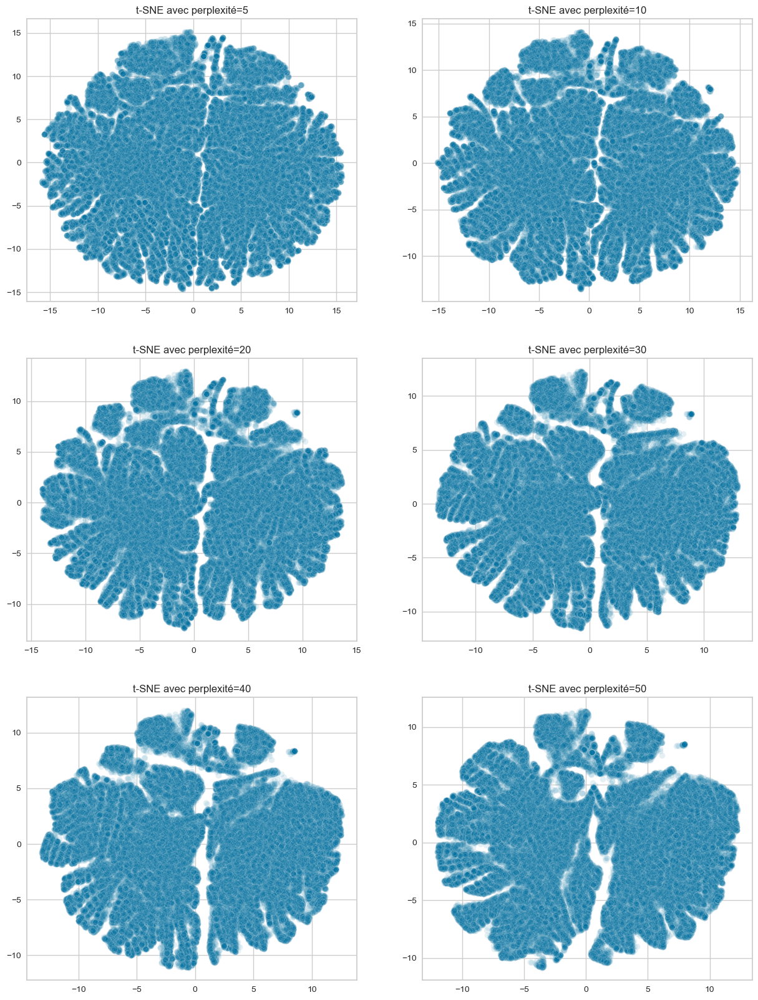

In [70]:
# Visualisation en 2D des différents résultats selon la perplexité
liste_param = [5, 10, 20, 30, 40, 50]
affiche_tsne(results_list, liste_param)

In [33]:
# Projection t-SNE en 2D avec les données quantitatives transformées
# en logarithme
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300,
            random_state=seed)
tsne_log = tsne.fit_transform(X_scaled_log)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 91458 samples in 0.609s...
[t-SNE] Computed neighbors for 91458 samples in 317.178s...
[t-SNE] Computed conditional probabilities for sample 1000 / 91458
[t-SNE] Computed conditional probabilities for sample 2000 / 91458
[t-SNE] Computed conditional probabilities for sample 3000 / 91458
[t-SNE] Computed conditional probabilities for sample 4000 / 91458
[t-SNE] Computed conditional probabilities for sample 5000 / 91458
[t-SNE] Computed conditional probabilities for sample 6000 / 91458
[t-SNE] Computed conditional probabilities for sample 7000 / 91458
[t-SNE] Computed conditional probabilities for sample 8000 / 91458
[t-SNE] Computed conditional probabilities for sample 9000 / 91458
[t-SNE] Computed conditional probabilities for sample 10000 / 91458
[t-SNE] Computed conditional probabilities for sample 11000 / 91458
[t-SNE] Computed conditional probabilities for sample 12000 / 91458
[t-SNE] Computed conditional probabilities for 

In [26]:
# Projection t-SNE en 2D avec les données quantitatives transformées
# en logarithme + qualitatives
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300,
            random_state=seed)
tsne_cat = tsne.fit_transform(X_scaled_cat)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 91458 samples in 0.014s...
[t-SNE] Computed neighbors for 91458 samples in 22.767s...
[t-SNE] Computed conditional probabilities for sample 1000 / 91458
[t-SNE] Computed conditional probabilities for sample 2000 / 91458
[t-SNE] Computed conditional probabilities for sample 3000 / 91458
[t-SNE] Computed conditional probabilities for sample 4000 / 91458
[t-SNE] Computed conditional probabilities for sample 5000 / 91458
[t-SNE] Computed conditional probabilities for sample 6000 / 91458
[t-SNE] Computed conditional probabilities for sample 7000 / 91458
[t-SNE] Computed conditional probabilities for sample 8000 / 91458
[t-SNE] Computed conditional probabilities for sample 9000 / 91458
[t-SNE] Computed conditional probabilities for sample 10000 / 91458
[t-SNE] Computed conditional probabilities for sample 11000 / 91458
[t-SNE] Computed conditional probabilities for sample 12000 / 91458
[t-SNE] Computed conditional probabilities for s

In [39]:
# # Visualisation pour les variables quantitatives + qualitatives
# plt.figure(figsize=[6, 6])
# sns.set_style('white')

# sns.scatterplot(tsne_cat[:, 0], tsne_cat[:, 1])
# plt.show()

## <span style='background:lightblue'>4. Clustering de partitions</span>

### <span style='background:aquamarine'>4.1 K-Means</span>

<span style='background:gold'>**4.1.1 Tuning hyperparamètre k : nombre de clusters optimal**</span>

In [34]:
# Dataframe de sauvegarde des résultats des métriques KMeans
df_metrique_kmeans = pd.DataFrame()

Pour n_clusters = 7 
 Le silhouette score moyen est de : 0.21060911908926952 
 Le score de Gini moyen est de : 0.381155868482143 
 Le temps d'entrainement du modèle est de : 2.0201703707377114 (s)


Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
Quant non log,2,10,k-means++,0.238428,1125886.904347,1.766771,0.315128,1.204388
Quant non log,3,10,k-means++,0.244293,1029851.601258,1.537483,0.315640,1.579169
Quant non log,4,10,k-means++,0.248742,957816.865117,1.478815,0.323075,1.752284
Quant non log,5,10,k-means++,0.201626,908365.410772,1.714003,0.498442,1.970284
Quant non log,6,10,k-means++,0.201961,833185.904975,1.429889,0.314131,2.046172
Quant non log,7,10,k-means++,0.128604,797484.802292,1.771623,0.520518,3.568726


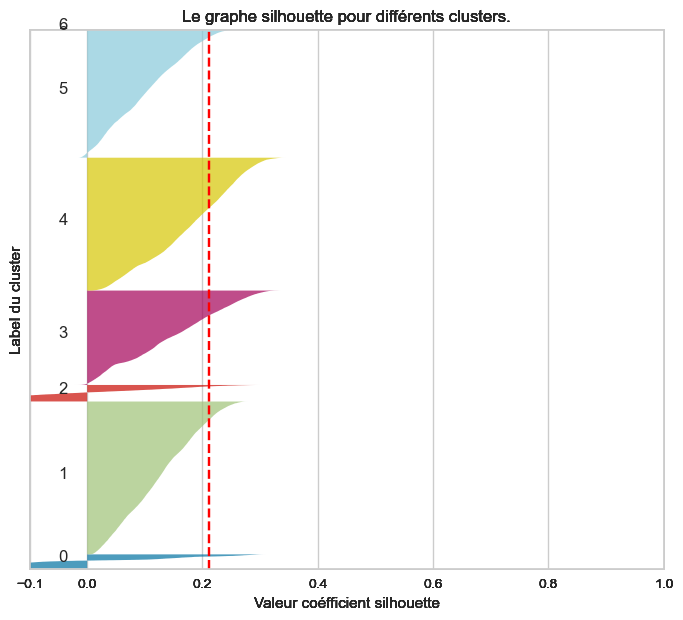

In [64]:
# Métriques pour les données quantitatives standardisées, non transformées
# en logarithme
# Paramètres à tester
nb_clusters = range(2, 8)
n_init = [10]
init = ['k-means++']
# Métriques avec les différentes combinaisons des paramètres
df_metrique_kmeans = \
    fonctions_segmentation.calcul_metrique_kmeans(X_scaled, df_metrique_kmeans,
                                              'Quant non log', seed,
                                              nb_clusters, n_init, init)
df_metrique_kmeans.style.hide_index()

Pour n_clusters = 7 
 Le silhouette score moyen est de : 0.16483595989697106 
 Le score de Gini moyen est de : 0.4066908731147257 
 Le temps d'entrainement du modèle est de : 2.841939091682434 (s)


Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
Quant non log,2,10,k-means++,0.238428,1125886.904347,1.766771,0.315128,1.204388
Quant non log,3,10,k-means++,0.244293,1029851.601258,1.537483,0.315640,1.579169
Quant non log,4,10,k-means++,0.248742,957816.865117,1.478815,0.323075,1.752284
Quant non log,5,10,k-means++,0.201626,908365.410772,1.714003,0.498442,1.970284
Quant non log,6,10,k-means++,0.201961,833185.904975,1.429889,0.314131,2.046172
Quant non log,7,10,k-means++,0.128604,797484.802292,1.771623,0.520518,3.568726
Quant log,2,10,k-means++,0.170831,1165149.960015,2.162736,0.315106,2.187180
Quant log,3,10,k-means++,0.184061,985511.584337,1.782202,0.349004,2.376618
Quant log,4,10,k-means++,0.168720,911011.607109,1.792926,0.401984,2.783605
Quant log,5,10,k-means++,0.157901,844260.782824,1.748135,0.374985,4.035331


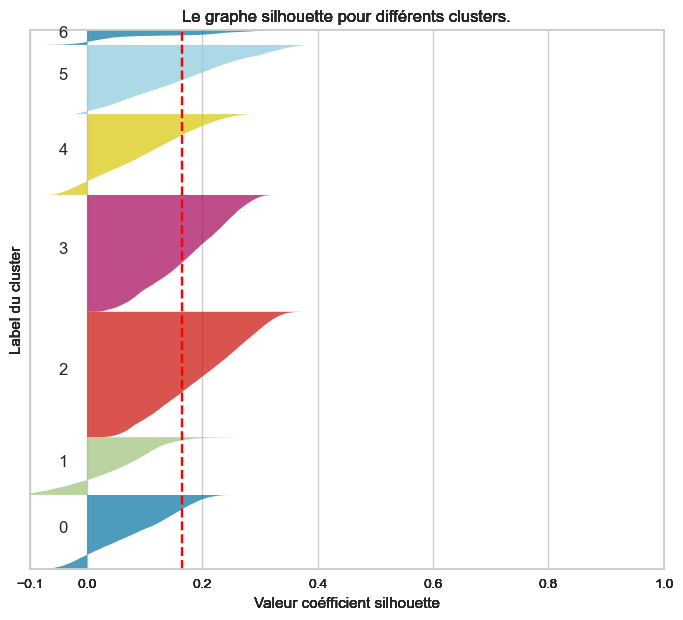

In [65]:
# Métriques pour les données quantitatives standardisées, transformées
# en logarithme
# Paramètres à tester
nb_clusters = range(2, 8)
n_init = [10]
init = ['k-means++']
# Métriques avec les différentes combinaisons des paramètres
df_metrique_kmeans = \
    fonctions_segmentation.calcul_metrique_kmeans(X_scaled_log, df_metrique_kmeans,
                                              'Quant log', seed,
                                              nb_clusters, n_init, init)
df_metrique_kmeans.style.hide_index()

Pour n_clusters = 7 
 Le silhouette score moyen est de : 0.14810836788076448 
 Le score de Gini moyen est de : 0.3981811398312513 
 Le temps d'entrainement du modèle est de : 3.791174372037252 (s)


Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
Quant non log,2,10,k-means++,0.238428,1125886.904347,1.766771,0.315128,1.204388
Quant non log,3,10,k-means++,0.244293,1029851.601258,1.537483,0.315640,1.579169
Quant non log,4,10,k-means++,0.248742,957816.865117,1.478815,0.323075,1.752284
Quant non log,5,10,k-means++,0.201626,908365.410772,1.714003,0.498442,1.970284
Quant non log,6,10,k-means++,0.201961,833185.904975,1.429889,0.314131,2.046172
Quant non log,7,10,k-means++,0.128604,797484.802292,1.771623,0.520518,3.568726
Quant log,2,10,k-means++,0.170831,1165149.960015,2.162736,0.315106,2.187180
Quant log,3,10,k-means++,0.184061,985511.584337,1.782202,0.349004,2.376618
Quant log,4,10,k-means++,0.168720,911011.607109,1.792926,0.401984,2.783605
Quant log,5,10,k-means++,0.157901,844260.782824,1.748135,0.374985,4.035331


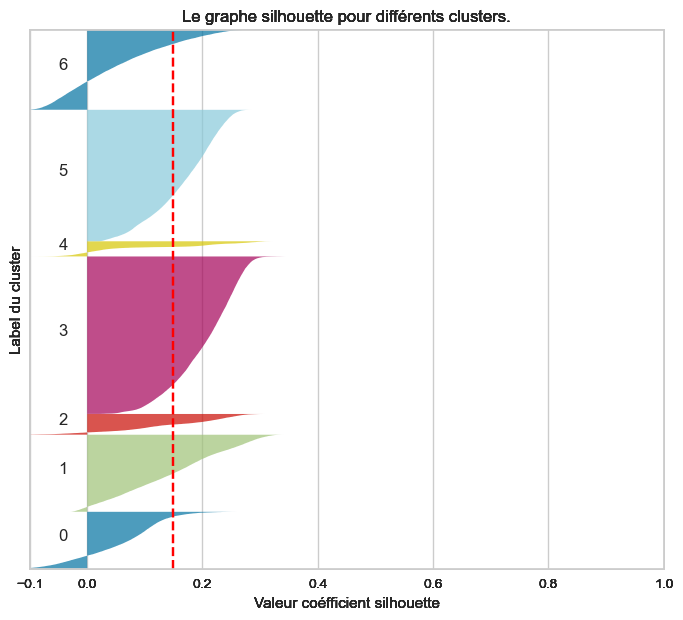

In [66]:
# Métriques pour les données quantitatives standardisées, transformées
# en logarithme + données qualitatives
# Paramètres à tester
nb_clusters = range(2, 8)
n_init = [10]
init = ['k-means++']
# Métriques avec les différentes combinaisons des paramètres
df_metrique_kmeans = \
    fonctions_segmentation.calcul_metrique_kmeans(X_scaled_cat,df_metrique_kmeans,'Quant log + Qual', seed,
                                              nb_clusters, n_init, init)
df_metrique_kmeans.style.hide_index()

In [67]:
# Tri par silhouette : silhouette proche de 1 : bonne assignation
df_metrique_kmeans.sort_values(by=['Type_données', 'coef_silh'],
                              ascending=[True, False])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
7,Quant log,3,10,k-means++,0.184061,9.855116e+05,1.782202,0.349004,2.376618
6,Quant log,2,10,k-means++,0.170831,1.165150e+06,2.162736,0.315106,2.187180
8,Quant log,4,10,k-means++,0.168720,9.110116e+05,1.792926,0.401984,2.783605
10,Quant log,6,10,k-means++,0.165479,7.973917e+05,1.624180,0.506023,3.267460
9,Quant log,5,10,k-means++,0.157901,8.442608e+05,1.748135,0.374985,4.035331
11,Quant log,7,10,k-means++,0.142024,7.661256e+05,1.849366,0.493044,2.401440
13,Quant log + Qual,3,10,k-means++,0.163591,1.100139e+06,1.906593,0.317645,2.994239
12,Quant log + Qual,2,10,k-means++,0.152982,1.279948e+06,2.299722,0.315106,2.251612
14,Quant log + Qual,4,10,k-means++,0.147988,1.024879e+06,1.911094,0.322786,3.753446
17,Quant log + Qual,7,10,k-means++,0.143834,8.717026e+05,1.776392,0.537514,5.074084


- coefficient de silhouette : 3 clusters

In [69]:
# Tri par indice de Davies-Bouldin : proche de 0
df_metrique_kmeans.sort_values(by=['Type_données', 'davies_bouldin'],
                              ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
4,Quant non log,6,10,k-means++,0.201961,8.331859e+05,1.429889,0.314131,2.046172
2,Quant non log,4,10,k-means++,0.248742,9.578169e+05,1.478815,0.323075,1.752284
1,Quant non log,3,10,k-means++,0.244293,1.029852e+06,1.537483,0.315640,1.579169
3,Quant non log,5,10,k-means++,0.201626,9.083654e+05,1.714003,0.498442,1.970284
0,Quant non log,2,10,k-means++,0.238428,1.125887e+06,1.766771,0.315128,1.204388
5,Quant non log,7,10,k-means++,0.128604,7.974848e+05,1.771623,0.520518,3.568726
16,Quant log + Qual,6,10,k-means++,0.143068,9.111424e+05,1.761941,0.455599,4.575833
17,Quant log + Qual,7,10,k-means++,0.143834,8.717026e+05,1.776392,0.537514,5.074084
15,Quant log + Qual,5,10,k-means++,0.137187,9.579724e+05,1.892234,0.440437,4.097833
13,Quant log + Qual,3,10,k-means++,0.163591,1.100139e+06,1.906593,0.317645,2.994239


- Indice de Davies-Bouldin : 6 clusters.

In [70]:
# Tri par indice de dispersion : proche de 0
df_metrique_kmeans.sort_values(by=['Type_données', 'dispersion'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
5,Quant non log,7,10,k-means++,0.128604,7.974848e+05,1.771623,0.520518,3.568726
4,Quant non log,6,10,k-means++,0.201961,8.331859e+05,1.429889,0.314131,2.046172
3,Quant non log,5,10,k-means++,0.201626,9.083654e+05,1.714003,0.498442,1.970284
2,Quant non log,4,10,k-means++,0.248742,9.578169e+05,1.478815,0.323075,1.752284
1,Quant non log,3,10,k-means++,0.244293,1.029852e+06,1.537483,0.315640,1.579169
0,Quant non log,2,10,k-means++,0.238428,1.125887e+06,1.766771,0.315128,1.204388
17,Quant log + Qual,7,10,k-means++,0.143834,8.717026e+05,1.776392,0.537514,5.074084
16,Quant log + Qual,6,10,k-means++,0.143068,9.111424e+05,1.761941,0.455599,4.575833
15,Quant log + Qual,5,10,k-means++,0.137187,9.579724e+05,1.892234,0.440437,4.097833
14,Quant log + Qual,4,10,k-means++,0.147988,1.024879e+06,1.911094,0.322786,3.753446


- dispersion: 6/7 clusters

In [71]:
# Tri par indice de Gini : proche de 0
df_metrique_kmeans.sort_values(by=['Type_données', 'indice_gini'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
4,Quant non log,6,10,k-means++,0.201961,8.331859e+05,1.429889,0.314131,2.046172
0,Quant non log,2,10,k-means++,0.238428,1.125887e+06,1.766771,0.315128,1.204388
1,Quant non log,3,10,k-means++,0.244293,1.029852e+06,1.537483,0.315640,1.579169
2,Quant non log,4,10,k-means++,0.248742,9.578169e+05,1.478815,0.323075,1.752284
3,Quant non log,5,10,k-means++,0.201626,9.083654e+05,1.714003,0.498442,1.970284
5,Quant non log,7,10,k-means++,0.128604,7.974848e+05,1.771623,0.520518,3.568726
12,Quant log + Qual,2,10,k-means++,0.152982,1.279948e+06,2.299722,0.315106,2.251612
13,Quant log + Qual,3,10,k-means++,0.163591,1.100139e+06,1.906593,0.317645,2.994239
14,Quant log + Qual,4,10,k-means++,0.147988,1.024879e+06,1.911094,0.322786,3.753446
15,Quant log + Qual,5,10,k-means++,0.137187,9.579724e+05,1.892234,0.440437,4.097833


- Indice de Gini: 6 clusters

**Bilan** :
***
Meilleur hyperparamètre k pour coefficient de silhouette la plus grande et indice de Davies-Bouldin le plus faible possibles.
- coefficient de silhouette : 3 clusters.
- Davies-Bouldin : 6 clusters.
- Indice de Gini: 2 clusters
- Dispersion : 6 clusters

In [72]:
# Constitution des dataframes de visualisation
df_qt_non_log = \
    df_metrique_kmeans[df_metrique_kmeans['Type_données'] == 'Quant non log']
df_qt_log = \
    df_metrique_kmeans[df_metrique_kmeans['Type_données'] == 'Quant log']
df_qt_log_cat = \
    df_metrique_kmeans[df_metrique_kmeans['Type_données'] == 'Quant log + Qual']

**Graphe Elbow**

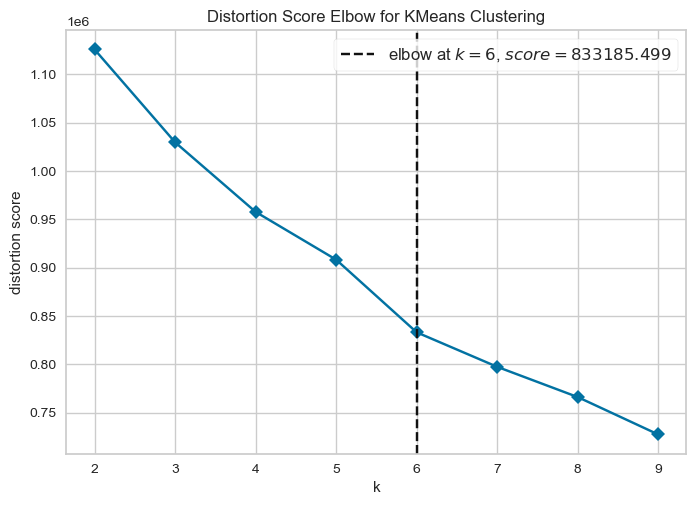

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [73]:
# Instanciation du modèle
model = KMeans(random_state=seed)

# Hyperparamètre k entre 2 et 9
# métrique = distortion ( calcule la somme des distances au carré entre
# chaque point et le centre qui lui est attribué)
visualizer = KElbowVisualizer(model, k=(2, 10), timings=False)

# Entraîne le modèle
visualizer.fit(X_scaled)
visualizer.show()

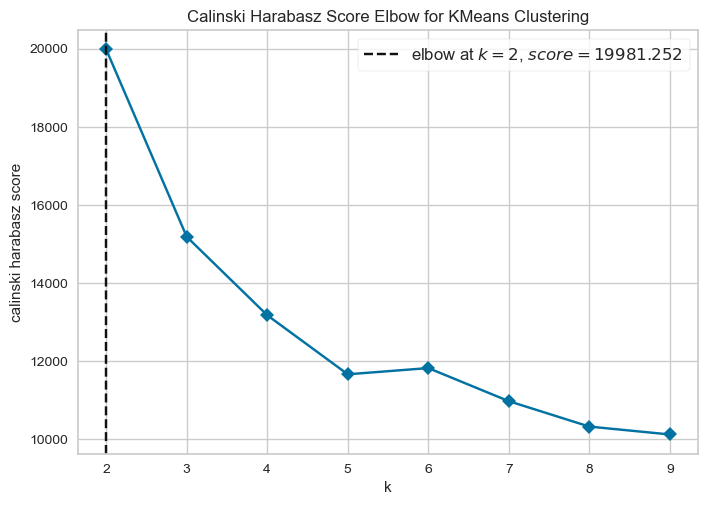

<Axes: title={'center': 'Calinski Harabasz Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='calinski harabasz score'>

In [74]:
# Instanciation du modèle
model = KMeans(random_state=seed)

# Hyperparamètre k entre 2 et 9
# métrique = calinski_harabasz (calcule le rapport de dispersion entre
# et au sein des clusters)
visualizer = KElbowVisualizer(model, k=(2, 10),
                              metric='calinski_harabasz', timings=False)

# Entraîne le modèle
visualizer.fit(X_scaled)
visualizer.show()

- Nombre de clusters optimal autour de 5, 6 ou 7.

***Données qualitatives en logarithme***

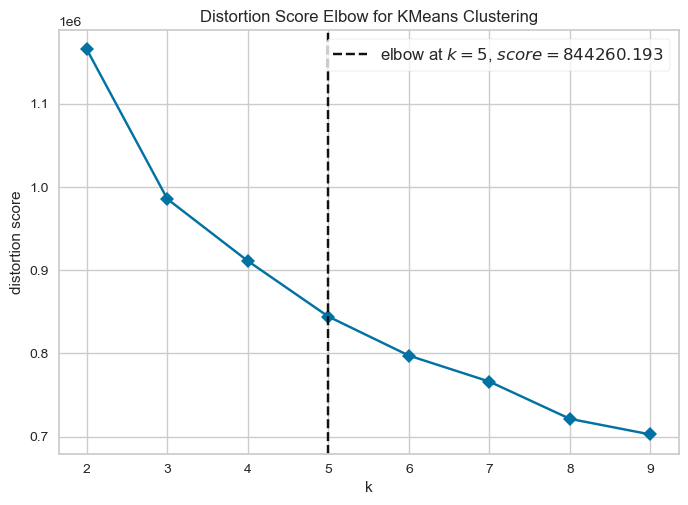

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [75]:
# Instanciation du modèle
model = KMeans(random_state=seed)

# Hyperparamètre k entre 2 et 9
# métrique = distortion ( calcule la somme des distances au carré entre
# chaque point et le centre qui lui est attribué)
visualizer = KElbowVisualizer(model, k=(2, 10), timings=False)

# Entraîne le modèle
visualizer.fit(X_scaled_log)
visualizer.show()

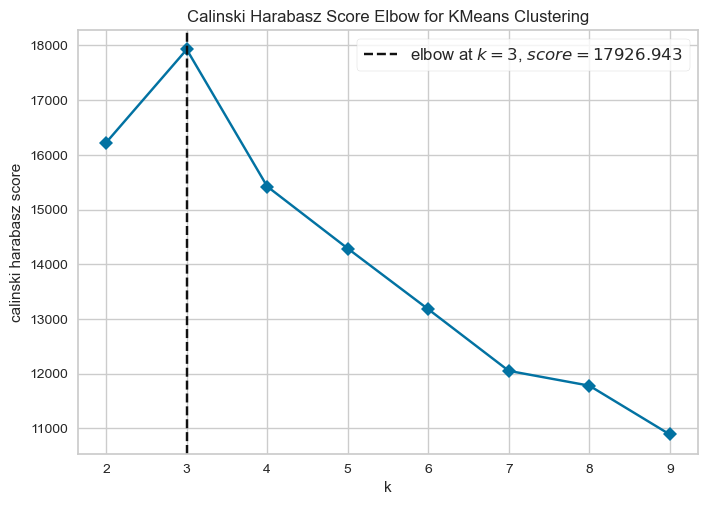

<Axes: title={'center': 'Calinski Harabasz Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='calinski harabasz score'>

In [76]:
# Instanciation du modèle
model = KMeans(random_state=seed)

# Hyperparamètre k entre 2 et 10
# métrique = calinski_harabasz (calcule le rapport de dispersion entre
# et au sein des clusters)
visualizer = KElbowVisualizer(model, k=(2, 10),
                              metric='calinski_harabasz', timings=False)

# Entraîne le modèle
visualizer.fit(X_scaled_log)
visualizer.show()

- Nombre de clusters optimal autour de 3, 4 ou 5.

***Données quantitatives en logarithme + qualitatives encodées***

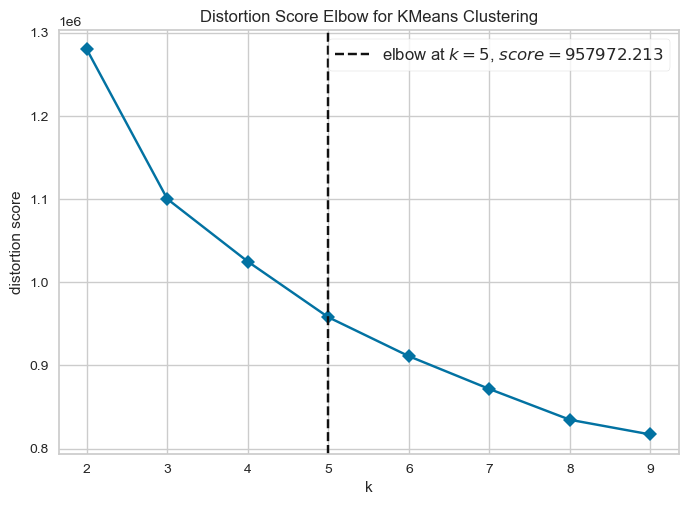

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [77]:
# Instanciation du modèle
model = KMeans(random_state=seed)

# Hyperparamètre k entre 2 et 9
# métrique = distortion ( calcule la somme des distances au carré entre
# chaque point et le centre qui lui est attribué)
visualizer = KElbowVisualizer(model, k=(2, 10), timings=False)

# Entraîne le modèle
visualizer.fit(X_scaled_cat)
visualizer.show()

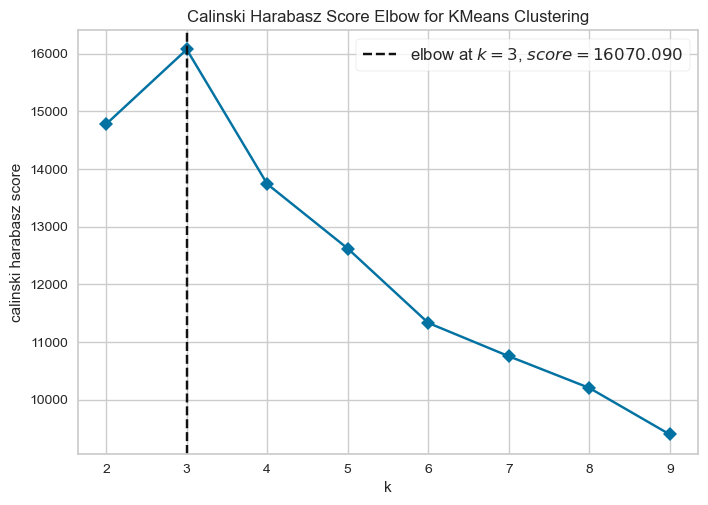

<Axes: title={'center': 'Calinski Harabasz Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='calinski harabasz score'>

In [78]:
# Instanciation du modèle
model = KMeans()

# Hyperparamètre k entre 2 et 9
# métrique = calinski_harabasz (calcule le rapport de dispersion entre
# et au sein des clusters)
visualizer = KElbowVisualizer(model, k=(2, 10),
                              metric='calinski_harabasz', timings=False)

# Entraîne le modèle
visualizer.fit(X_scaled_cat)
visualizer.show()

- Nombre de clusters optimal autour de 3, 4, 5.

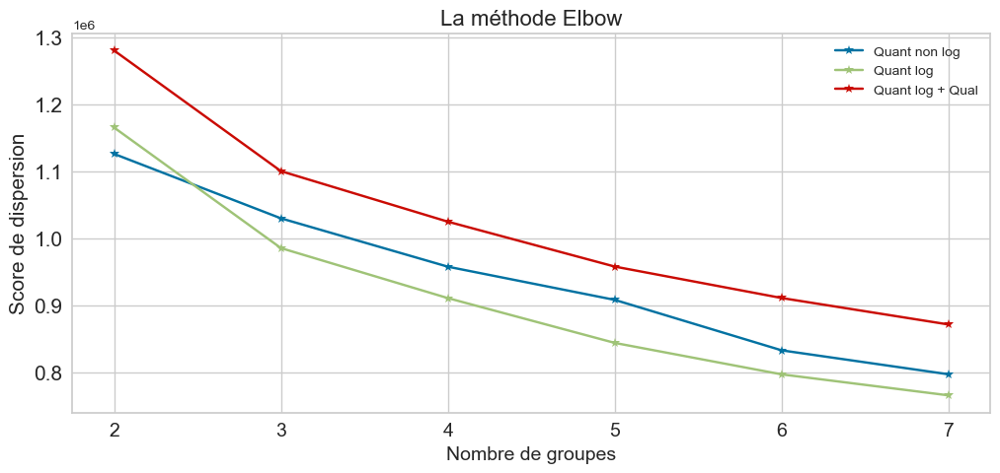

In [81]:
# Trace le graphique des dispersions
plt.figure(figsize=(12, 5))

plt.title('La méthode Elbow', fontsize=16)
plt.plot([i for i in range(2, 8)], df_qt_non_log['dispersion'].to_list(),
         marker='*')
plt.plot([i for i in range(2, 8)], df_qt_log['dispersion'].to_list(),
         marker='*')
plt.plot([i for i in range(2, 8)], df_qt_log_cat['dispersion'].to_list(),
         marker='*')
plt.grid(True)
plt.xlabel('Nombre de groupes', fontsize=14)
plt.ylabel('Score de dispersion', fontsize=15)
plt.xticks([i for i in range(2, 8)], fontsize=14)
plt.yticks(fontsize=15)
plt.legend(labels=['Quant non log', 'Quant log', 'Quant log + Qual'])

plt.show()

- ***Méthode Elbow*** : 
    - Quantitatives non log : 3 ou 4 clusters.
    - Quantitatives log : 3 ou 4 ou 5 clusters, difficile à interpréter.
    - Quantitatives + qualitatives : 3 ou 6

***Silhouette***

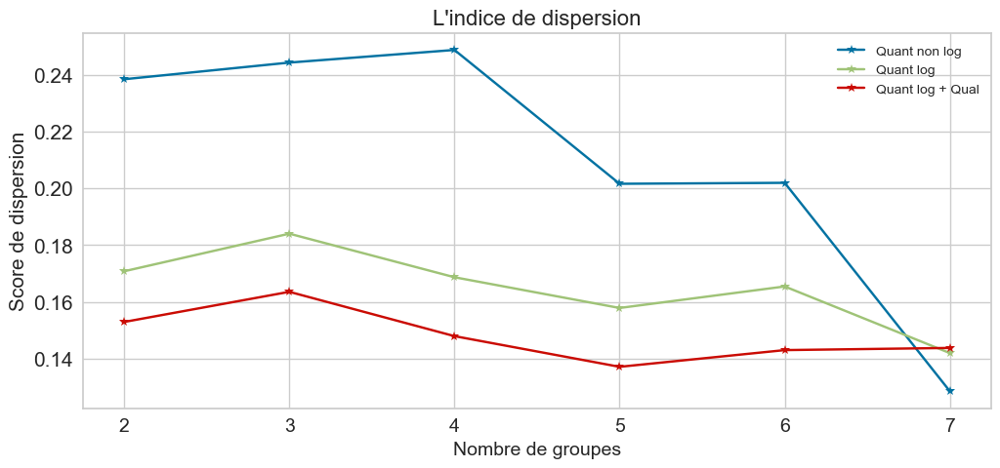

In [88]:
# Trace le graphique des dispersions
plt.figure(figsize=(12, 5))

plt.title('L\'indice de dispersion', fontsize=16)
plt.plot([i for i in range(2, 8)], df_qt_non_log['coef_silh'].to_list(),
         marker='*')
plt.plot([i for i in range(2, 8)], df_qt_log['coef_silh'].to_list(),
         marker='*')
plt.plot([i for i in range(2, 8)], df_qt_log_cat['coef_silh'].to_list(),
         marker='*')
plt.grid(True)
plt.xlabel('Nombre de groupes', fontsize=14)
plt.ylabel('Score de dispersion', fontsize=15)
plt.xticks([i for i in range(2, 8)], fontsize=14)
plt.yticks(fontsize=15)
plt.legend(labels=['Quant non log', 'Quant log', 'Quant log + Qual'])

plt.show()

- ***Coefficient de silhouette*** :
    - Quantitatives non log : 5 ou 6 clusters.
    - Quantitatives log : 4 ou 5 ou 6.
    - Quantitatives + qualitatives : 5 ou 6.

**Davies-Bouldin**

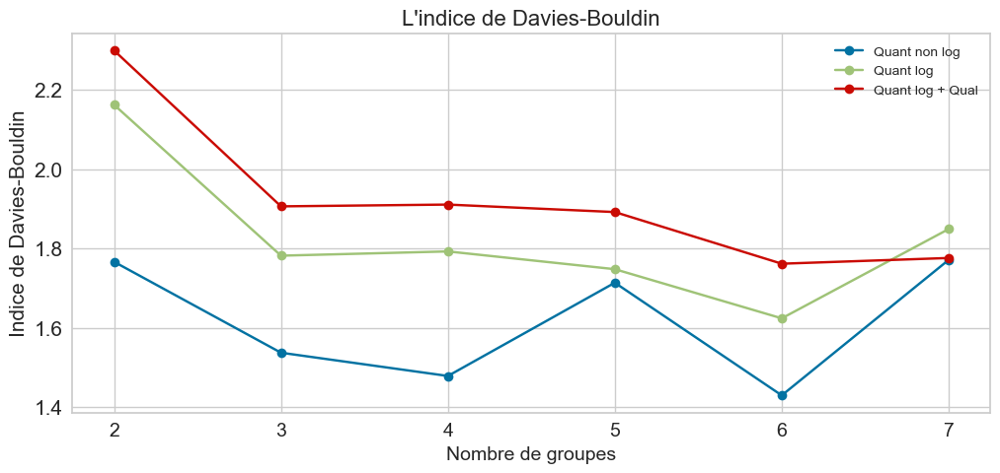

In [83]:
# Trace le graphique des indices de davies-bouldin
plt.figure(figsize=(12, 5))

plt.title('L\'indice de Davies-Bouldin', fontsize=16)
plt.plot([i for i in range(2, 8)],
         df_qt_non_log['davies_bouldin'].to_list(),
         marker='o')
plt.plot([i for i in range(2, 8)],
         df_qt_log['davies_bouldin'].to_list(),
         marker='o')
plt.plot([i for i in range(2, 8)],
         df_qt_log_cat['davies_bouldin'].to_list(),
         marker='o')
plt.grid(True)
plt.xlabel('Nombre de groupes', fontsize=14)
plt.ylabel('Indice de Davies-Bouldin', fontsize=15)
plt.xticks([i for i in range(2, 8)], fontsize=14)
plt.yticks(fontsize=15)
plt.legend(labels=['Quant non log', 'Quant log', 'Quant log + Qual'])

plt.show()

- ***Indice de Davies-Bouldin*** :
    - Quantitatives non log : 4 ou 5 ou 6 clusters.
    - Quantitatives log : 3 ou 4 ou 5 clusters.
    - Quantitatives + qualitatives : 5 ou 6.

**Indice de Gini**

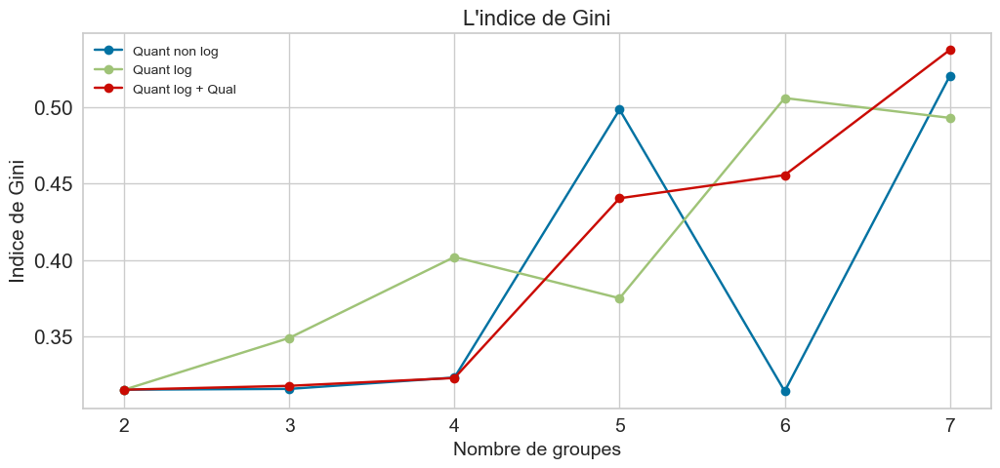

In [87]:
# Trace le graphique des coefficient de silhouette
plt.figure(figsize=(12, 5))

plt.title('L\'indice de Gini', fontsize=16)
plt.plot([i for i in range(2, 8)], df_qt_non_log['indice_gini'].to_list(),
         marker='o')
plt.plot([i for i in range(2, 8)], df_qt_log['indice_gini'].to_list(),
         marker='o')
plt.plot([i for i in range(2, 8)], df_qt_log_cat['indice_gini'].to_list(),
         marker='o')
plt.grid(True)
plt.xlabel('Nombre de groupes', fontsize=14)
plt.ylabel('Indice de Gini', fontsize=15)
plt.xticks([i for i in range(2, 8)], fontsize=14)
plt.yticks(fontsize=15)
plt.legend(labels=['Quant non log', 'Quant log', 'Quant log + Qual'])

plt.show()

- ***Indice de Gini*** :
    - Quantitatives non log : 4 ou 6 clusters.
    - Quantitatives log : 3 clusters.
    - Quantitatives + qualitatives : 4 clusters.

**Bilan** :
***
Les différents indices donnent des nombres de clusters k optimal différents pour les différents types de données :
- quantitatives sans logarithme ou avec logarithme :
  - **Méthode Elbow** : 3 ou 4 clusters.
  - **Coefficient de silhouette** : 4 ou 5 clusters.
  - **Indice de Davies Bouldin** : 4, 5 ou 6 clusters.
  - **Indice de Gini** : 3, 4 ou 6 clusters.
- quantitatives avec logarithme + qualitatives :
  - **Méthode Elbow** : 3 ou 6 clusters.
  - **Coefficient de silhouette** : 5 ou 6 clusters.
  - **Indice de Davies Bouldin** : 5 ou 6 clusters.
  - **Indice de Gini** : 4 clusters.

<span style='background:gold'>**4.1.2 2ème méthode: Résultat du clustering pour différents clusters, avec la t-SNE (visualisation des clusters)**</span>

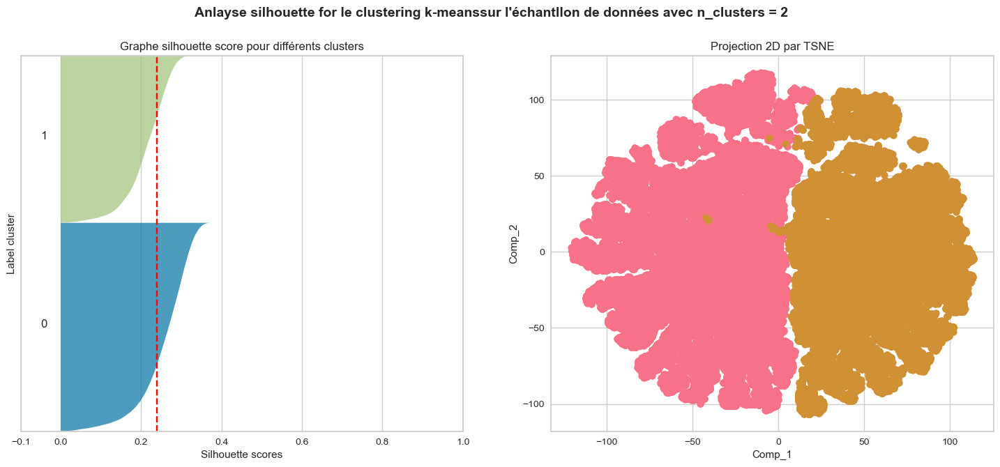

Pour n_clusters = 2 
 Le silhouette score moyen est de : 0.23842849461191662 
 Le temps d'entrainement du modèle est de : 1.8319778442382812 (s) 
 Le score de Gini est de : 0.5


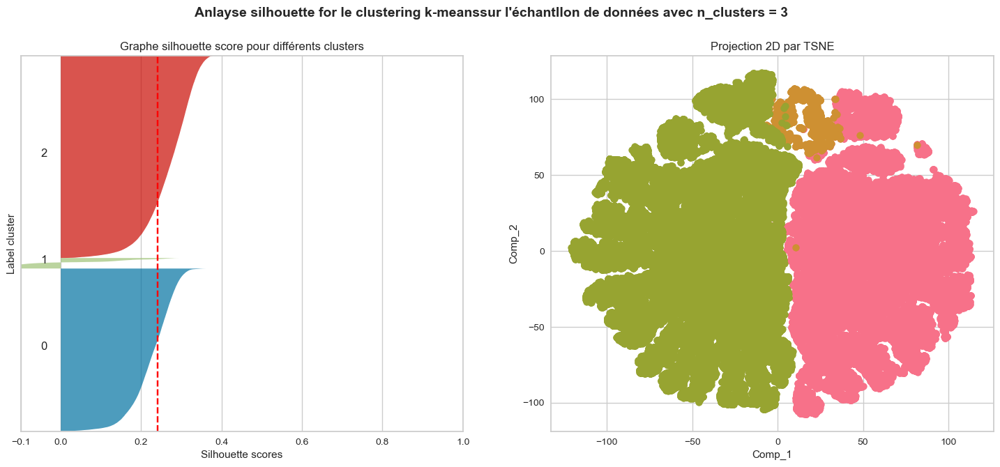

Pour n_clusters = 3 
 Le silhouette score moyen est de : 0.24136070166251689 
 Le temps d'entrainement du modèle est de : 2.3775715827941895 (s) 
 Le score de Gini est de : 0.5425951438547385


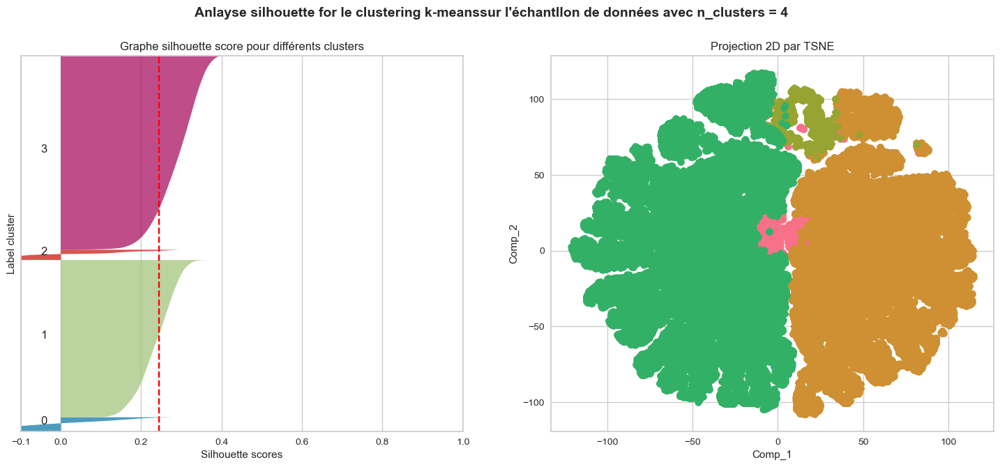

Pour n_clusters = 4 
 Le silhouette score moyen est de : 0.2438212113852912 
 Le temps d'entrainement du modèle est de : 2.1319713592529297 (s) 
 Le score de Gini est de : 0.536602715028878


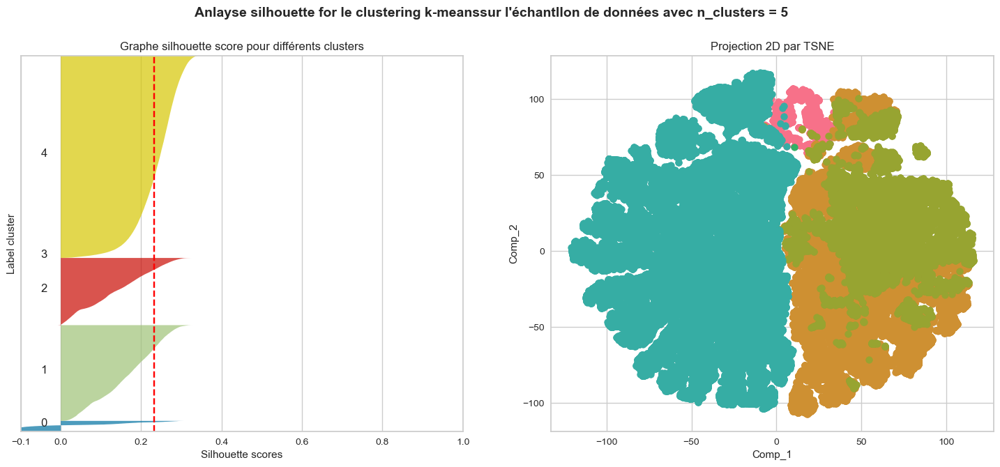

Pour n_clusters = 5 
 Le silhouette score moyen est de : 0.2318499290478889 
 Le temps d'entrainement du modèle est de : 2.0589506030082703 (s) 
 Le score de Gini est de : 0.5442843527447937


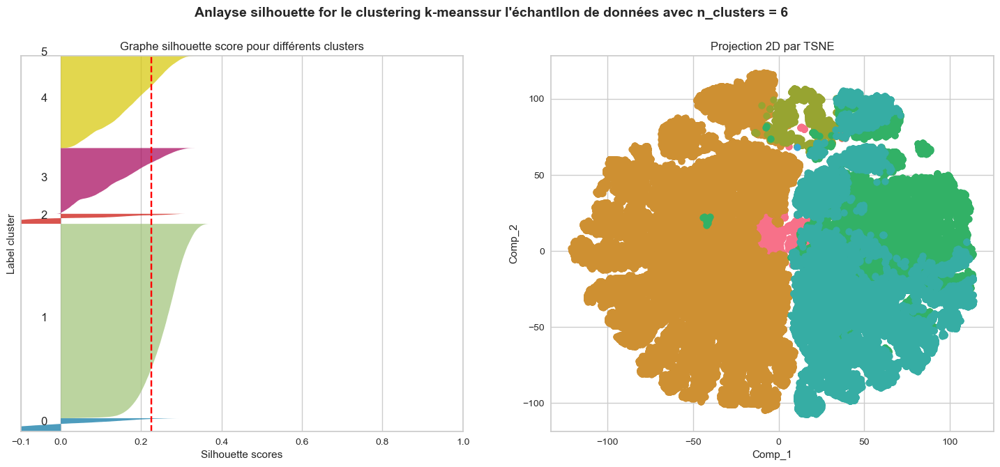

Pour n_clusters = 6 
 Le silhouette score moyen est de : 0.22586815439508462 
 Le temps d'entrainement du modèle est de : 2.017413854598999 (s) 
 Le score de Gini est de : 0.5082339434494523


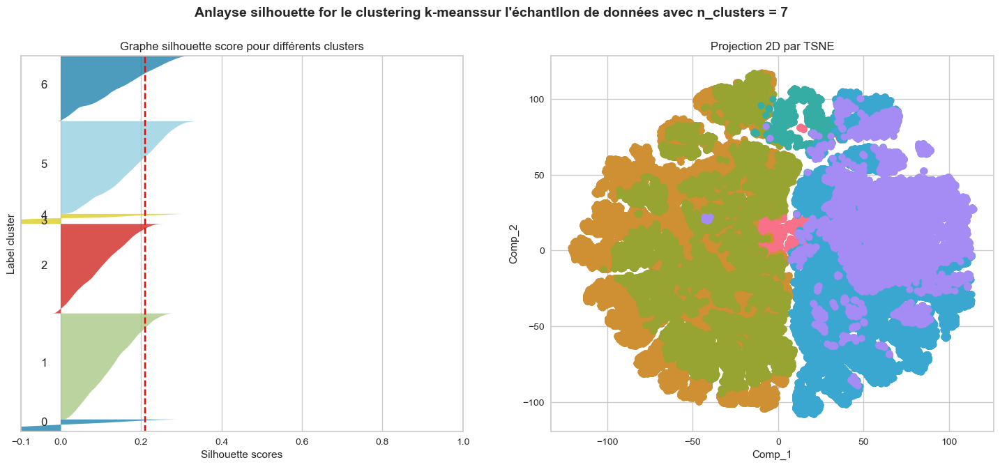

Pour n_clusters = 7 
 Le silhouette score moyen est de : 0.2096582525692902 
 Le temps d'entrainement du modèle est de : 2.0009921391805015 (s) 
 Le score de Gini est de : 0.5010854839431892


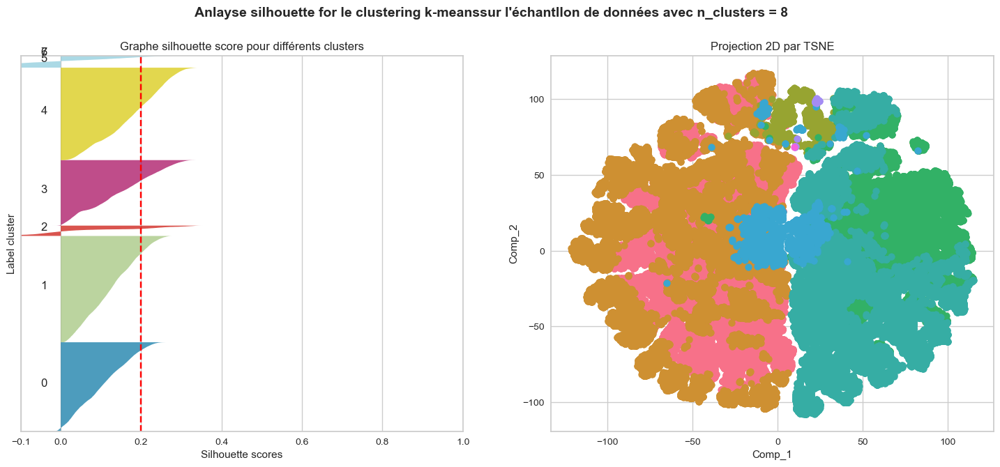

Pour n_clusters = 8 
 Le silhouette score moyen est de : 0.19834234916296176 
 Le temps d'entrainement du modèle est de : 1.9976156439099992 (s) 
 Le score de Gini est de : 0.48225380915339316


([0.23842849461191662,
  0.24429290871311712,
  0.2487422308308398,
  0.195936082035682,
  0.20194105578386753,
  0.12860874344031797,
  0.13044692872499108],
 [0.5,
  0.585190287709477,
  0.5246178573771568,
  0.5673292658925408,
  0.36403230626808664,
  0.46534318641187367,
  0.36926376041461656],
 [1.8319778442382812,
  2.9231653213500977,
  1.6407709121704102,
  1.839888334274292,
  1.851266860961914,
  1.9188835620880127,
  1.9773566722869873])

In [56]:
# Visualisation des clusterings sur les données quantitatives standardisées, non transformées en logarithme

range_nb_clusters = range(2, 9)
fonctions_segmentation.variation_clustering(X_scaled, range_nb_clusters)

**Constatation**:
-  Le meilleur score enregistrée est pour K= 4 Clusters, score silhouette moyen = 0,2438, avec des indices de Gini globalement proches entre elles, globalement (0,5366)
- Nombre de clusters optimaux: **K=4**

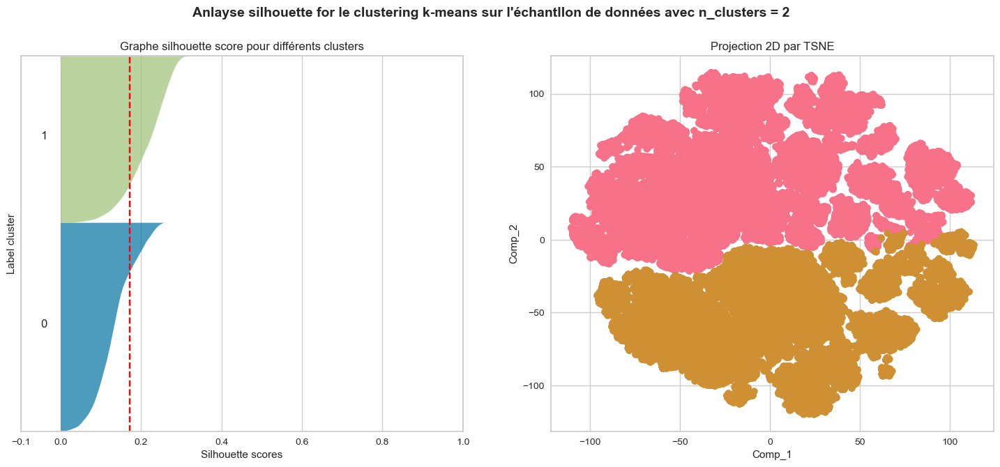

Pour n_clusters = 2 
 Le silhouette score moyen est de : 0.1708309280506169 
 Le temps d'entrainement du modèle est de : 2.2905547618865967 (s) 
 Le score de Gini est de : 0.5


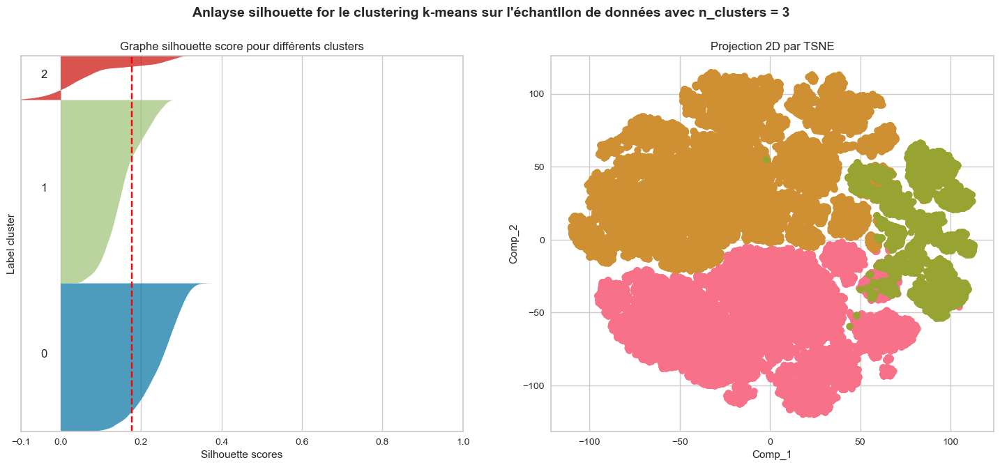

Pour n_clusters = 3 
 Le silhouette score moyen est de : 0.17745372135124304 
 Le temps d'entrainement du modèle est de : 2.228143811225891 (s) 
 Le score de Gini est de : 0.46922175570571556


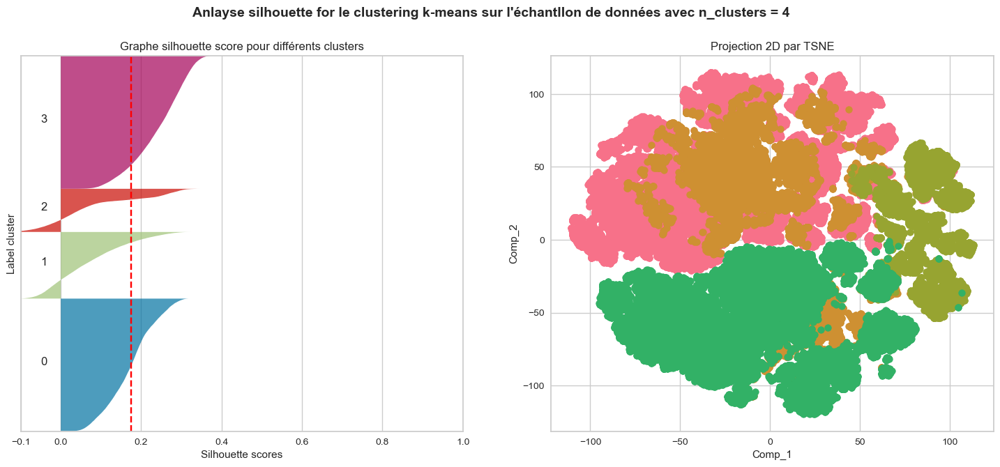

Pour n_clusters = 4 
 Le silhouette score moyen est de : 0.17468390980447235 
 Le temps d'entrainement du modèle est de : 2.364405870437622 (s) 
 Le score de Gini est de : 0.4942730239259794


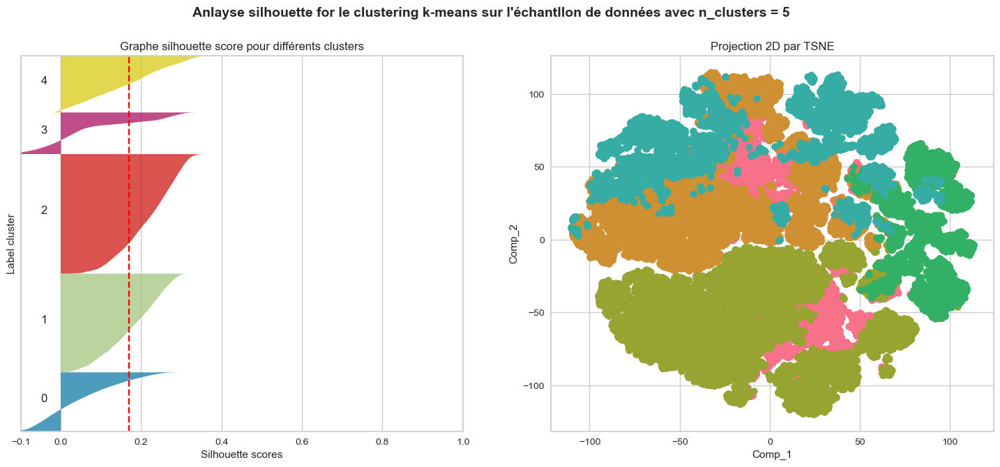

Pour n_clusters = 5 
 Le silhouette score moyen est de : 0.17050791108809424 
 Le temps d'entrainement du modèle est de : 2.642050862312317 (s) 
 Le score de Gini est de : 0.4821799806104077


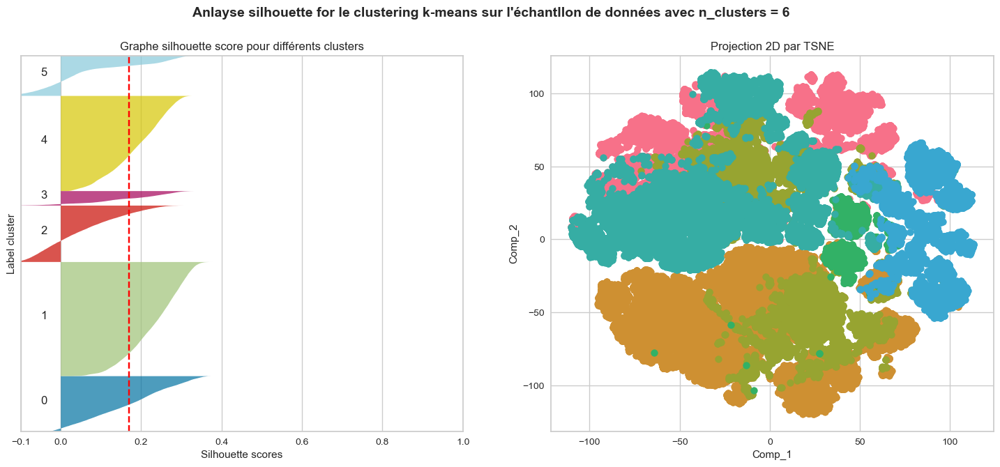

Pour n_clusters = 6 
 Le silhouette score moyen est de : 0.16944027616438354 
 Le temps d'entrainement du modèle est de : 2.7187838554382324 (s) 
 Le score de Gini est de : 0.4760889151304424


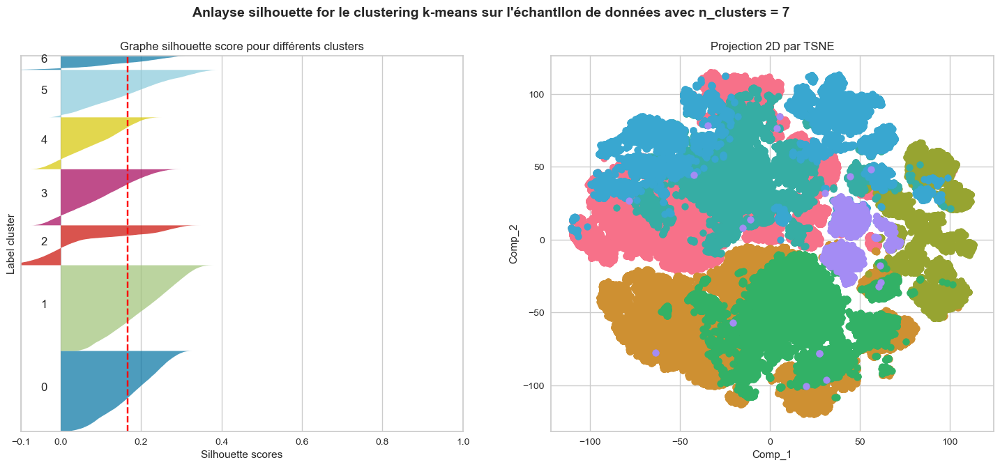

Pour n_clusters = 7 
 Le silhouette score moyen est de : 0.16563637568850328 
 Le temps d'entrainement du modèle est de : 2.8254682620366416 (s) 
 Le score de Gini est de : 0.46935384860498025


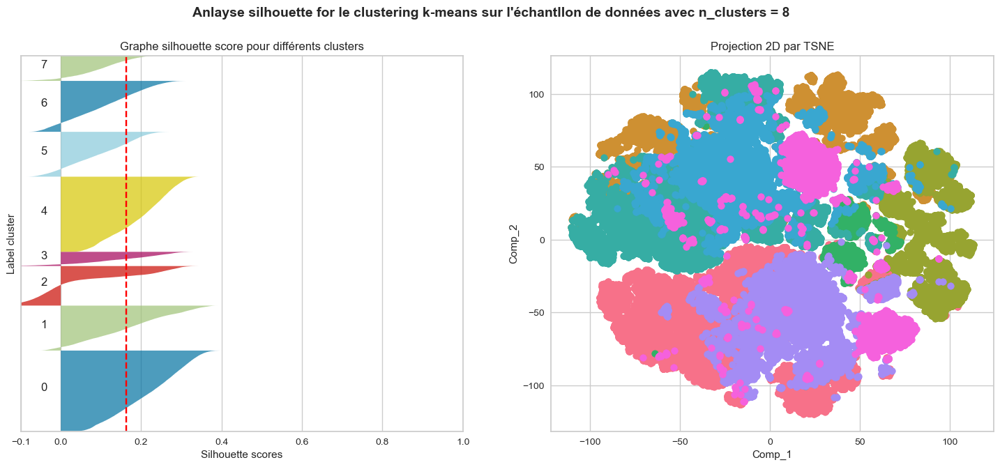

Pour n_clusters = 8 
 Le silhouette score moyen est de : 0.1633692322035616 
 Le temps d'entrainement du modèle est de : 2.9849367822919572 (s) 
 Le score de Gini est de : 0.47347824093227137


([0.1708309280506169,
  0.1840765146518692,
  0.16914428671093093,
  0.15797991493895994,
  0.16516973646954067,
  0.14661687330910197,
  0.14976637129391152],
 [0.5,
  0.4384435114114311,
  0.544375560366507,
  0.44590085066369267,
  0.45172465321058114,
  0.4356785159776697,
  0.4982245948960178],
 [2.2905547618865967,
  2.1657328605651855,
  2.636929988861084,
  3.4749858379364014,
  3.0257158279418945,
  3.3588902950286865,
  3.9417479038238525])

In [24]:
# Visualisation des clusterings sur les données quantitatives standardisées, non transformées en logarithme

range_nb_clusters = range(2, 9)
fonctions_segmentation.variation_clustering(X_scaled_log, range_nb_clusters)

**Constatation**:

- Les meilleurs scores sont enregistrés avec K=3 Clusters, avec le score silhouette moyen le plus élevé: 0,1774, et l'indice de Gini le plus faible: 0,4692
- Nombre de clusters optimaux: **K=3**

<span style='background:gold'>**4.1.2 Segmentation KMeans (variables quantitatives)**</span>

Pour la suite de l'analyse, on utilisera les données quantitatives avec transformations logrithmiques et on va tester la segmentation KMeans avec 3, 4 ou 5 clusters.

La recherche du meilleur score pour le coefficient de silhouette, la dispersion,l'indice de Davies-Boudin, ou l'indice de Gini nous indique de tester la segmentation KMeans avec 3, 4 ou 5 clusters. Ces clusters devront être interprétable pour l'équipe Marketing.

<span style='background:lavender'>**4.1.2.1 Segmentation KMeans - k=3 clusters**</span>

In [89]:
# Dataframe de sauvegarde des résultats des métriques KMeans
df_metrique_kmeans_k_3 = pd.DataFrame()

Pour n_clusters = 3 
 Le silhouette score moyen est de : 0.18406100096630246 
 Le score de Gini moyen est de : 0.3549068060384731 
 Le temps d'entrainement du modèle est de : 7.839265394210815 (s)


Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
Kmeans 3 clusters,3,10,k-means++,0.184061,985511.584337,1.782202,0.349004,1.836211
Kmeans 3 clusters,3,10,random,0.184061,985511.574688,1.782202,0.379132,2.327646
Kmeans 3 clusters,3,20,k-means++,0.184061,985511.584337,1.782202,0.349004,4.177960
Kmeans 3 clusters,3,20,random,0.184061,985511.574688,1.782202,0.379132,4.519541
Kmeans 3 clusters,3,30,k-means++,0.184061,985511.584337,1.782202,0.349004,6.694664
Kmeans 3 clusters,3,30,random,0.184061,985511.574688,1.782202,0.379132,6.617538
Kmeans 3 clusters,3,50,k-means++,0.184061,985511.584337,1.782202,0.349004,10.699630
Kmeans 3 clusters,3,50,random,0.184061,985511.574688,1.782202,0.379132,10.767683
Kmeans 3 clusters,3,70,k-means++,0.184061,985511.584337,1.782202,0.349004,15.439552
Kmeans 3 clusters,3,70,random,0.184063,985511.444651,1.782157,0.287522,15.312228


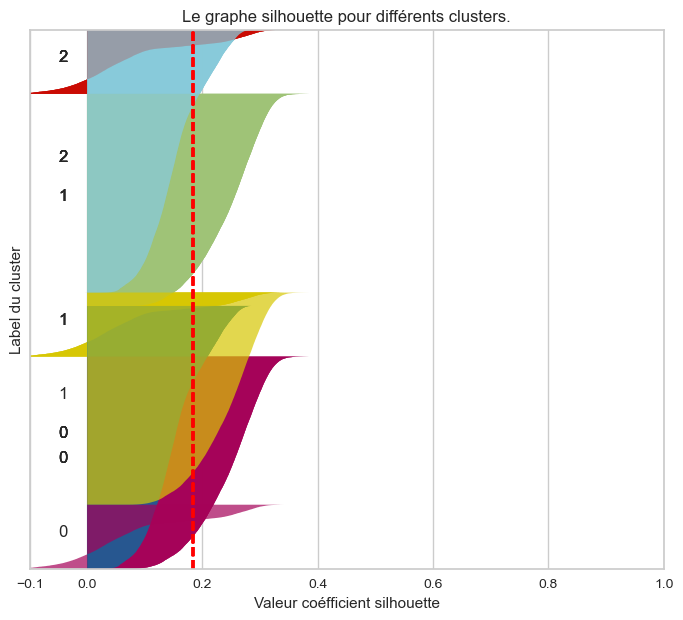

In [92]:
# Tuning hyperparametres n_init et init
# Métriques pour les données quantitatives standardisées, non transformées
# en logarithme
# Paramètres à tester
n_clusters = [3]
n_init = [10, 20, 30, 50, 70]
init = ['k-means++', 'random']
# Métriques avec les différentes combinaisons des paramètres
df_metrique_kmeans_k_3 = \
     calcul_metrique_kmeans(X_scaled_log, df_metrique_kmeans_k_3,
                                              'Kmeans 3 clusters', seed,
                                              n_clusters, n_init, init)
df_metrique_kmeans_k_3.style.hide_index()

In [93]:
# Tri par indice de dispersion : proche de 0
df_metrique_kmeans_k_3.sort_values(by=['Type_données', 'dispersion'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
9,Kmeans 3 clusters,3,70,random,0.184063,985511.444651,1.782157,0.287522,15.312228
1,Kmeans 3 clusters,3,10,random,0.184061,985511.574688,1.782202,0.379132,2.327646
3,Kmeans 3 clusters,3,20,random,0.184061,985511.574688,1.782202,0.379132,4.519541
5,Kmeans 3 clusters,3,30,random,0.184061,985511.574688,1.782202,0.379132,6.617538
7,Kmeans 3 clusters,3,50,random,0.184061,985511.574688,1.782202,0.379132,10.767683
0,Kmeans 3 clusters,3,10,k-means++,0.184061,985511.584337,1.782202,0.349004,1.836211
2,Kmeans 3 clusters,3,20,k-means++,0.184061,985511.584337,1.782202,0.349004,4.177960
4,Kmeans 3 clusters,3,30,k-means++,0.184061,985511.584337,1.782202,0.349004,6.694664
6,Kmeans 3 clusters,3,50,k-means++,0.184061,985511.584337,1.782202,0.349004,10.699630
8,Kmeans 3 clusters,3,70,k-means++,0.184061,985511.584337,1.782202,0.349004,15.439552


In [94]:
# Tri par indice de dispersion : proche de 0
df_metrique_kmeans_k_3.sort_values(by=['Type_données', 'coef_silh'],
                                  ascending=[False, False])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
9,Kmeans 3 clusters,3,70,random,0.184063,985511.444651,1.782157,0.287522,15.312228
0,Kmeans 3 clusters,3,10,k-means++,0.184061,985511.584337,1.782202,0.349004,1.836211
1,Kmeans 3 clusters,3,10,random,0.184061,985511.574688,1.782202,0.379132,2.327646
2,Kmeans 3 clusters,3,20,k-means++,0.184061,985511.584337,1.782202,0.349004,4.177960
3,Kmeans 3 clusters,3,20,random,0.184061,985511.574688,1.782202,0.379132,4.519541
4,Kmeans 3 clusters,3,30,k-means++,0.184061,985511.584337,1.782202,0.349004,6.694664
5,Kmeans 3 clusters,3,30,random,0.184061,985511.574688,1.782202,0.379132,6.617538
6,Kmeans 3 clusters,3,50,k-means++,0.184061,985511.584337,1.782202,0.349004,10.699630
7,Kmeans 3 clusters,3,50,random,0.184061,985511.574688,1.782202,0.379132,10.767683
8,Kmeans 3 clusters,3,70,k-means++,0.184061,985511.584337,1.782202,0.349004,15.439552


In [95]:
# Tri par indice de dispersion : proche de 0
df_metrique_kmeans_k_3.sort_values(by=['Type_données', 'davies_bouldin'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
9,Kmeans 3 clusters,3,70,random,0.184063,985511.444651,1.782157,0.287522,15.312228
0,Kmeans 3 clusters,3,10,k-means++,0.184061,985511.584337,1.782202,0.349004,1.836211
1,Kmeans 3 clusters,3,10,random,0.184061,985511.574688,1.782202,0.379132,2.327646
2,Kmeans 3 clusters,3,20,k-means++,0.184061,985511.584337,1.782202,0.349004,4.177960
3,Kmeans 3 clusters,3,20,random,0.184061,985511.574688,1.782202,0.379132,4.519541
4,Kmeans 3 clusters,3,30,k-means++,0.184061,985511.584337,1.782202,0.349004,6.694664
5,Kmeans 3 clusters,3,30,random,0.184061,985511.574688,1.782202,0.379132,6.617538
6,Kmeans 3 clusters,3,50,k-means++,0.184061,985511.584337,1.782202,0.349004,10.699630
7,Kmeans 3 clusters,3,50,random,0.184061,985511.574688,1.782202,0.379132,10.767683
8,Kmeans 3 clusters,3,70,k-means++,0.184061,985511.584337,1.782202,0.349004,15.439552


In [96]:
# Tri par indice de dispersion : proche de 0
df_metrique_kmeans_k_3.sort_values(by=['Type_données', 'indice_gini'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
9,Kmeans 3 clusters,3,70,random,0.184063,985511.444651,1.782157,0.287522,15.312228
0,Kmeans 3 clusters,3,10,k-means++,0.184061,985511.584337,1.782202,0.349004,1.836211
2,Kmeans 3 clusters,3,20,k-means++,0.184061,985511.584337,1.782202,0.349004,4.177960
4,Kmeans 3 clusters,3,30,k-means++,0.184061,985511.584337,1.782202,0.349004,6.694664
6,Kmeans 3 clusters,3,50,k-means++,0.184061,985511.584337,1.782202,0.349004,10.699630
8,Kmeans 3 clusters,3,70,k-means++,0.184061,985511.584337,1.782202,0.349004,15.439552
1,Kmeans 3 clusters,3,10,random,0.184061,985511.574688,1.782202,0.379132,2.327646
3,Kmeans 3 clusters,3,20,random,0.184061,985511.574688,1.782202,0.379132,4.519541
5,Kmeans 3 clusters,3,30,random,0.184061,985511.574688,1.782202,0.379132,6.617538
7,Kmeans 3 clusters,3,50,random,0.184061,985511.574688,1.782202,0.379132,10.767683


**Constatation** :
***
Les meilleurs scores sont trouvés pour : 
- n_init=70.
- init=random (paramètre par défaut).

In [21]:
%%time
# Instanciation du modèle KMeans pour 3 clusters et  meilleurs paramètres
kmeans_3 = KMeans(n_clusters=3, init='random', random_state=seed)
clusters_km_3 = kmeans_3.fit(X_scaled_log)
kmeans_3_labels = kmeans_3.labels_

CPU times: total: 3.81 s
Wall time: 2.32 s


In [22]:
# Préparation dataframe d'interprétation
# Ajout de l'assignation du cluster au dataframe
data_kmeans = data_clients.copy()
data_kmeans['Cluster_3'] = kmeans_3.labels_

**Distribution clients par cluster**

Clusters,Nb_clients,%
0,35997,39.360000
1,10865,11.880000
2,44596,48.760000


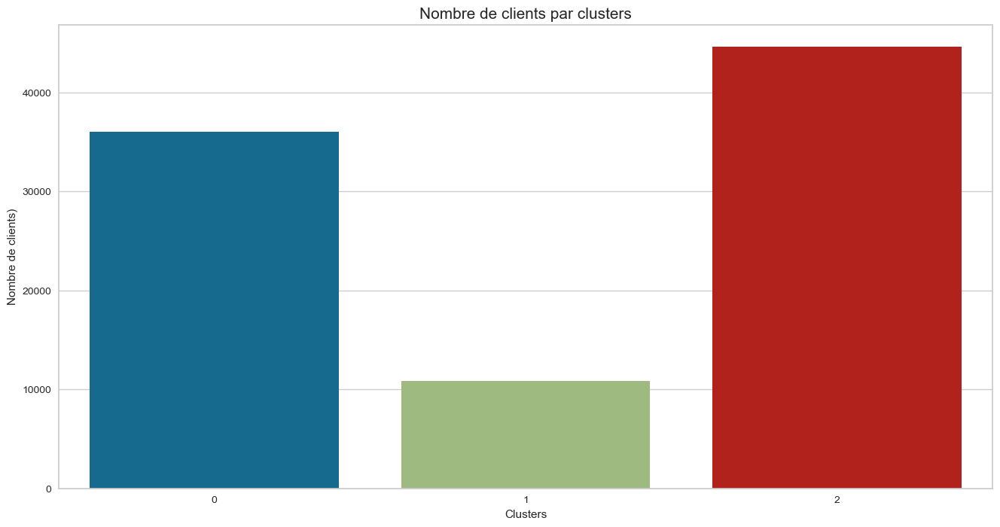

In [23]:
fonctions_segmentation.typage_clients_par_clusters(kmeans_3_labels)

**Projection 2D des clusters**

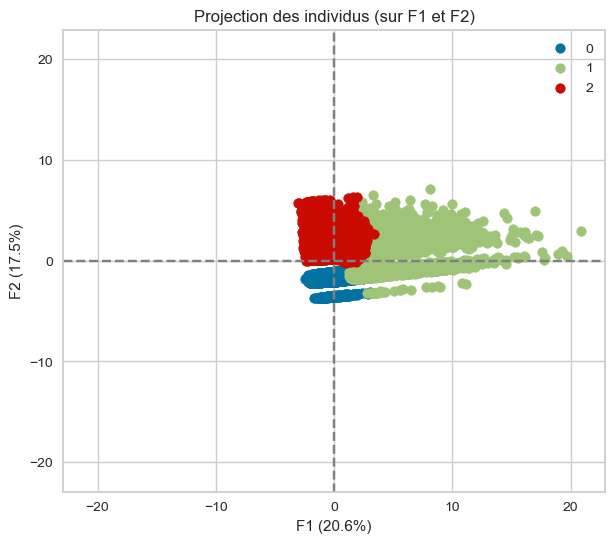

In [32]:
# Visualisation avec ACP
fonctions_data.display_factorial_planes(X_projected_log_acp, n_comp_log,
                                     pca_log, [(0, 1)], alpha=1,
                                     illustrative_var=kmeans_3_labels)

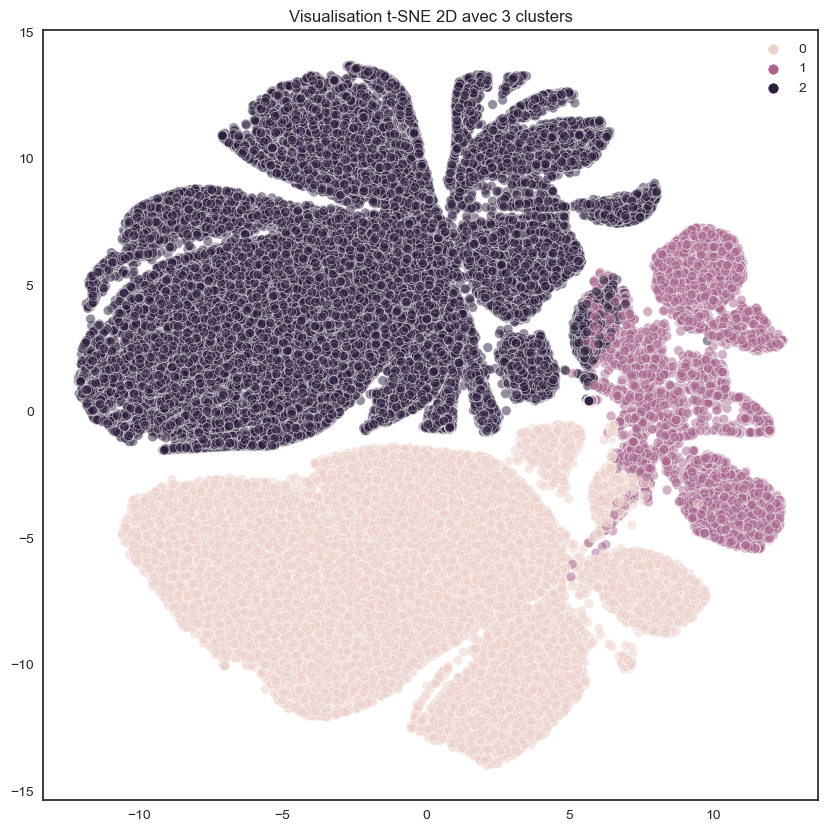

In [36]:
# Visualisation en 2D avec t-SNE

plt.figure(figsize=(10,10))
plot = sns.scatterplot(
                x=tsne_log[:,0], y=tsne_log[:,1],
                hue=kmeans_3_labels,
                legend="full",
                alpha=0.5).set(title = 'Visualisation t-SNE 2D avec 3 clusters')
    

plt.show()

**Analyse des 3 clusters**

In [54]:
summary_table_k3 = data_kmeans.groupby('Cluster_3').agg({'rfm_recence' : 'mean',
                                          'rfm_frequence' : 'mean',
                                          'rfm_montant' : 'mean',
                                          'note_avis_mean' : 'mean',
                                          'premier_achat_jour' : 'median',
                                          'dernier_achat_annee' : 'mean',
                                          'dernier_achat_mois' : 'median',
                                          'nbr_commandes' : 'mean',
                                          'nbr_articles_mean' : 'mean',
                                          'panier_moyen': 'mean',
                                          'echeance_paiement_mean' : 'median',
                                          'frais_port_mean' : 'mean'})

# Aggrégation des données par différentes fonctions
summary_table_k3.reset_index(inplace=True)
summary_table_k3.head()

,Cluster_3,rfm_recence,rfm_frequence,rfm_montant,note_avis_mean,premier_achat_jour,dernier_achat_annee,dernier_achat_mois,nbr_commandes,nbr_articles_mean,panier_moyen,echeance_paiement_mean,frais_port_mean
0,0,379.825263,1.040059,151.604425,4.227172,366.0,2016.993861,9.0,1.193461,1.000236,129.822020,2.0,19.692311
1,1,236.719374,2.734745,664.223369,3.694721,228.0,2017.562080,6.0,14.154717,1.592992,100.232793,2.0,19.265279
2,2,121.942753,1.032223,151.267803,4.208326,125.0,2018.000000,4.0,1.139003,1.000258,128.558079,1.0,20.864796


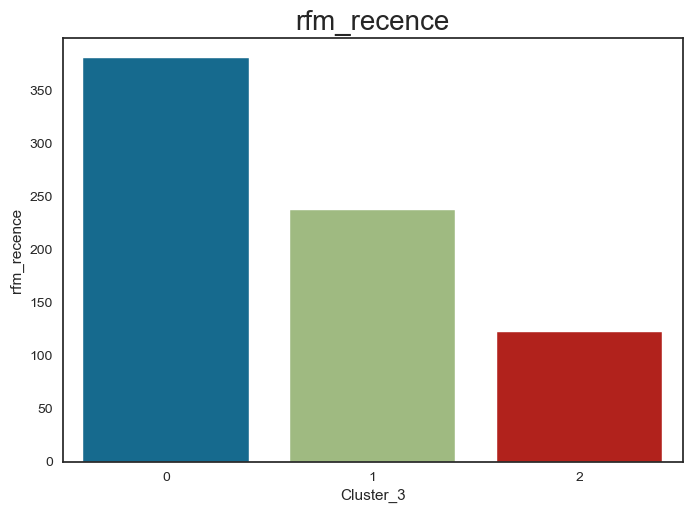

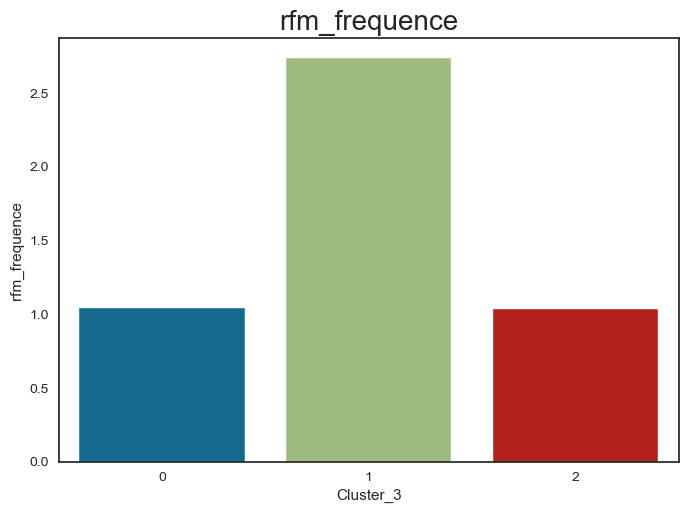

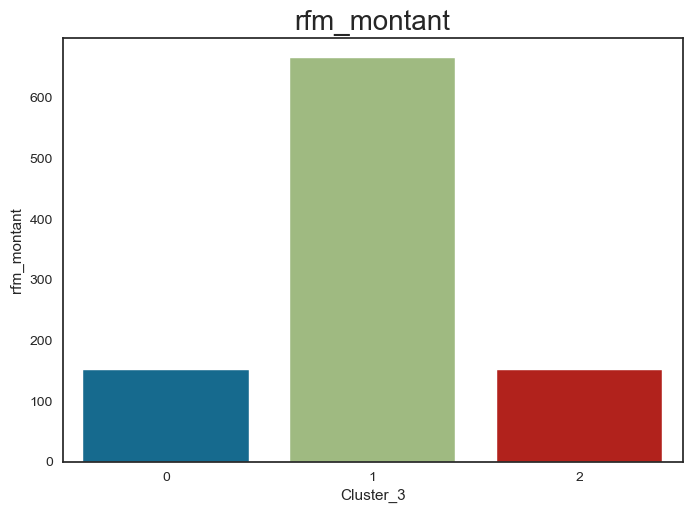

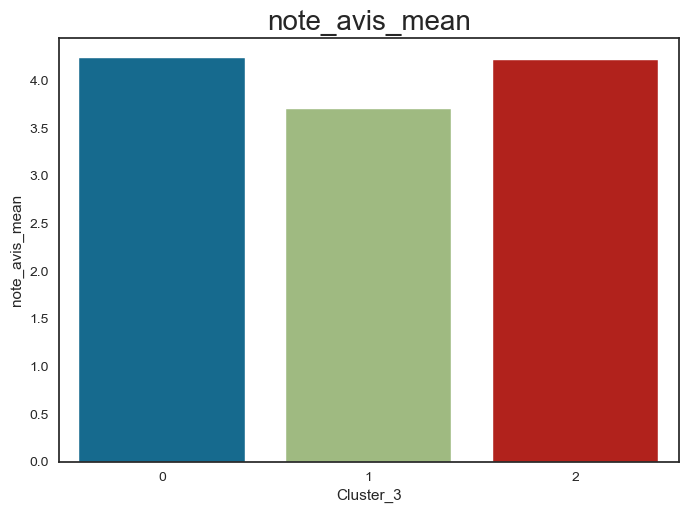

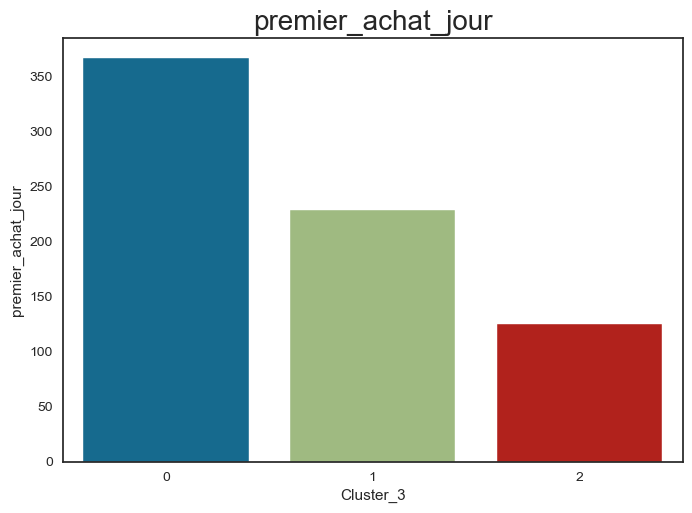

...

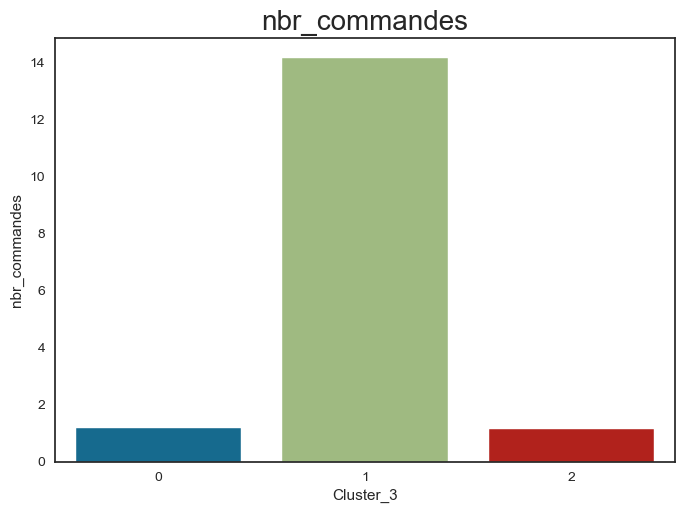

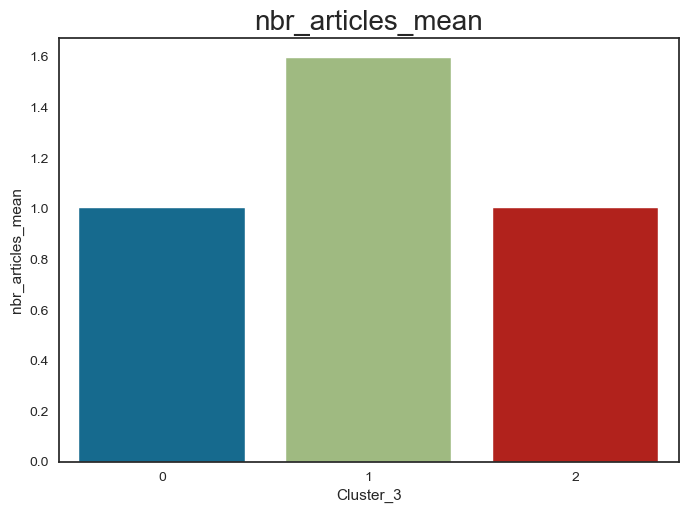

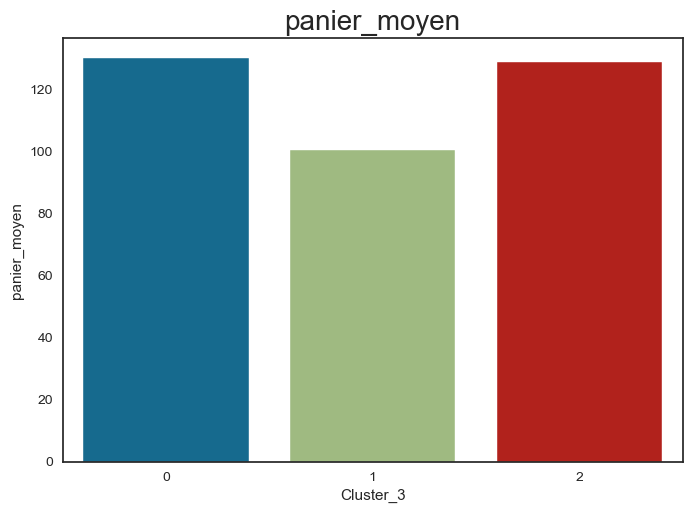

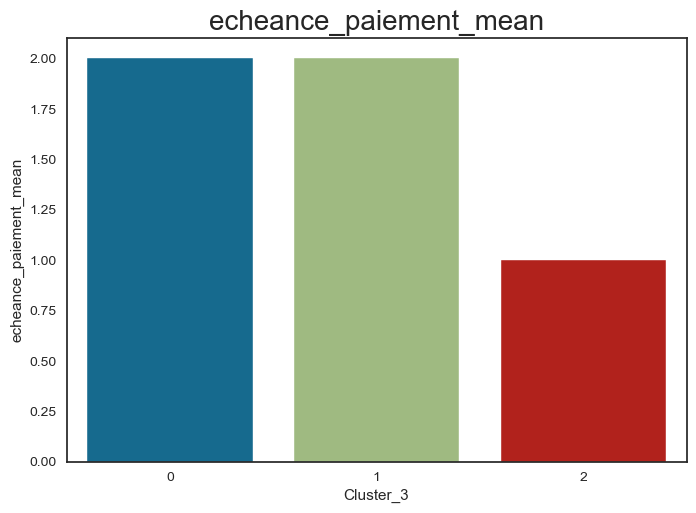

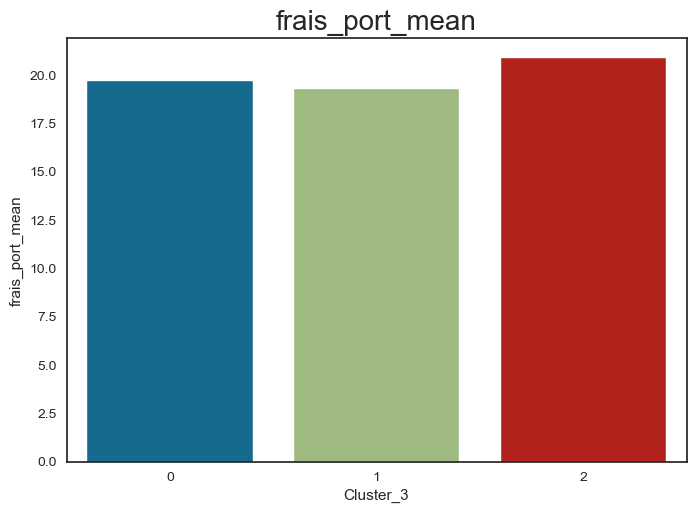

In [57]:
# Visualisation des moyennes des variables par clusters
# from operator import itemgetter

res = summary_table_k3.columns[1:].to_list()
# res = list(map(itemgetter(0), cols))
sns.set_style('white')

for col in res:
    
    sns.barplot(x=summary_table_k3["Cluster_3"], y=summary_table_k3[col])
    plt.title(col, fontsize=20)    
    plt.show()

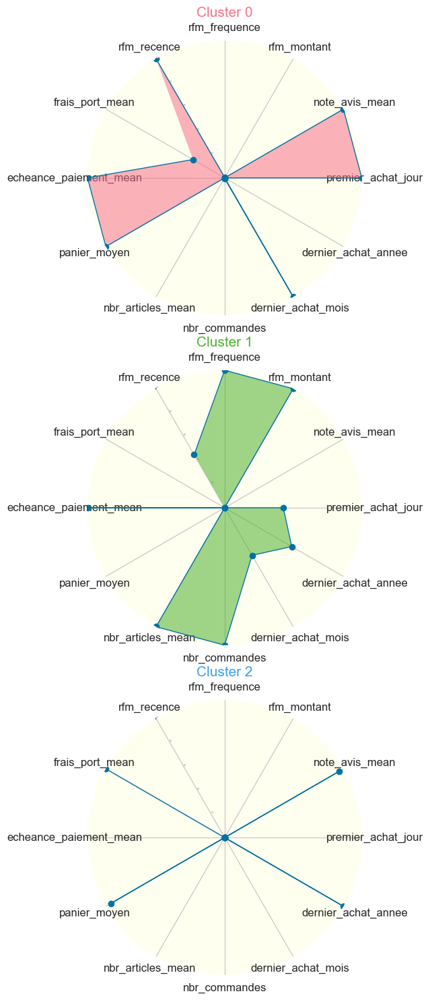

In [58]:
# Liste des couleurs pour chaque segment
palette = sns.color_palette("husl", summary_table_k3.shape[0])
colors = {label: color for label, color in zip(summary_table_k3['Cluster_3'],
                                                 palette.as_hex())}

fonctions_segmentation.affiche_radarplot_par_clusters(summary_table_k3, 'Cluster_3', 3, 1, colors,  sub_plot=[3, 3],  figsize=(36, 18))

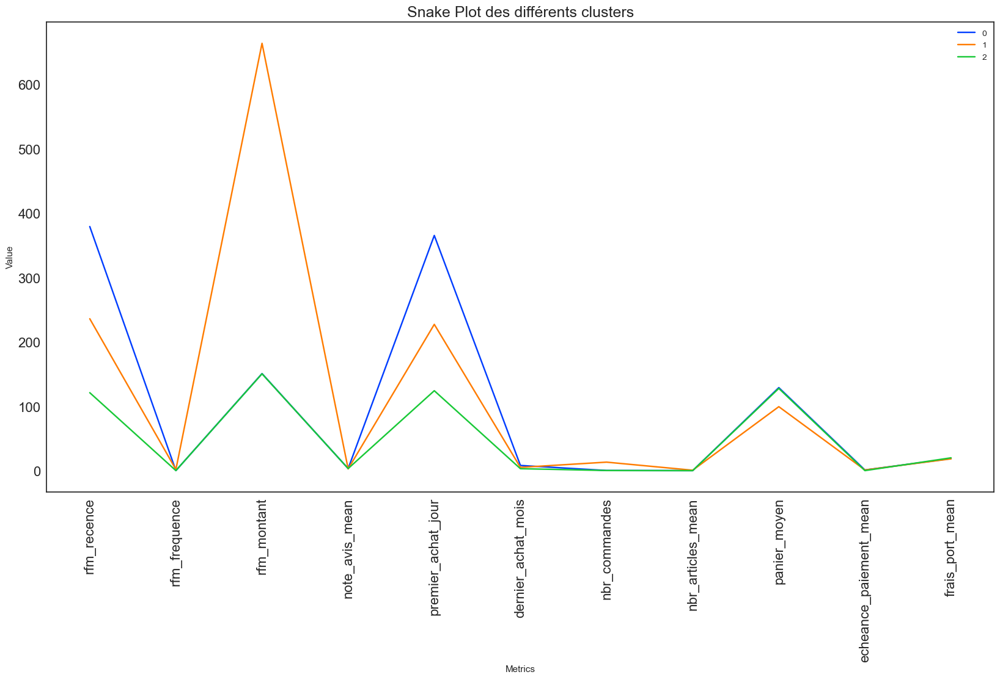

In [59]:

cols_a_interp = summary_table_k3.columns.to_list()
cols_a_interp.remove('dernier_achat_annee')
data_melt = pd.melt(frame=summary_table_k3[cols_a_interp],
                               id_vars=["Cluster_3"],
                               var_name='Metrics', value_name='Value')

# Visualisation : Snake plot des différentes variables moyennes

plt.figure(figsize=(20, 10))

sns.set_style('white')

sns.lineplot(x='Metrics', y='Value', hue='Cluster_3',
             data=data_melt, palette='bright')
plt.title('Snake Plot des différents clusters', fontsize='18')
plt.xticks(rotation=90, fontsize=16)
plt.yticks(fontsize=16)
plt.legend(loc='upper right')

plt.show()

**Bilan** :
***
- **Cluster 2** : commandes anciennes, peu fréquentes et d'un faible montant, dernier achat très anciens ==> **clients presque perdus**.    
- **Cluster 0** : commandes très récentes, peu fréquentes et d'un faible montant ==> **nouveaux clients**.
- **Cluster 1** : commandes récentes, fréquentes et d'un bon montant ==> **meilleurs clients**.

<span style='background:lavender'>**4.1.2.2 Segmentation KMeans - k=4 clusters**</span>

In [60]:
# Dataframe de sauvegarde des résultats des métriques KMeans
df_metrique_kmeans_k_4 = pd.DataFrame()

Pour n_clusters = 4 
 Le silhouette score moyen est de : 0.1690097643254062 
 Le score de Gini moyen est de : 0.3715984386275668 
 Le temps d'entrainement du modèle est de : 9.197619128227235 (s)


Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
Kmeans 3 clusters,4,10,k-means++,0.168720,911011.607109,1.792926,0.401984,2.810699
Kmeans 3 clusters,4,10,random,0.169138,911010.587498,1.801308,0.352107,2.658720
Kmeans 3 clusters,4,20,k-means++,0.168720,911011.607109,1.792926,0.401984,5.181775
Kmeans 3 clusters,4,20,random,0.169072,911005.139844,1.799981,0.363072,4.869115
Kmeans 3 clusters,4,30,k-means++,0.169153,911009.720639,1.801077,0.432142,3.745167
Kmeans 3 clusters,4,30,random,0.169072,911005.139844,1.799981,0.363072,7.745639
Kmeans 3 clusters,4,50,k-means++,0.169115,911006.350977,1.800416,0.322973,13.071344
Kmeans 3 clusters,4,50,random,0.169068,911004.672932,1.799753,0.402779,12.389578
Kmeans 3 clusters,4,70,k-means++,0.169115,911006.350977,1.800416,0.322973,18.250705
Kmeans 3 clusters,4,70,random,0.168922,910998.867068,1.797230,0.352898,17.248516


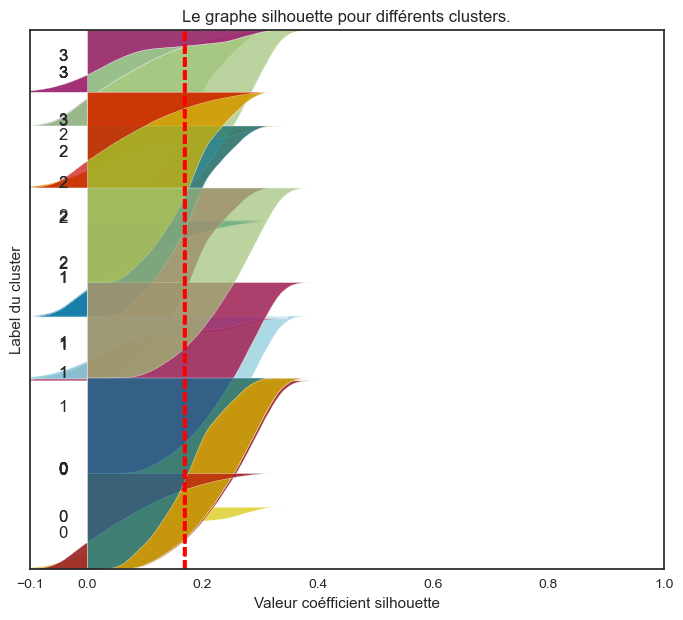

In [74]:
# Tuning hyperparametres n_init et init
# Métriques pour les données quantitatives standardisées, non transformées
# en logarithme
# Paramètres à tester
n_clusters = [4]
n_init = [10, 20, 30, 50, 70]
init = ['k-means++', 'random']
# Métriques avec les différentes combinaisons des paramètres
#fonctions_segmentation.
df_metrique_kmeans_k_4 = calcul_metrique_kmeans(X_scaled_log, df_metrique_kmeans_k_4,
                                              'Kmeans 4 clusters', seed,
                                              n_clusters, n_init, init)
df_metrique_kmeans_k_4.style.hide_index()

In [83]:
# Tri par indice de dispersion : proche de 0
df_metrique_kmeans_k_4.sort_values(by=['Type_données', 'dispersion'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
19,Kmeans 4 clusters,4,70,random,0.168922,910998.867068,1.797230,0.352898,17.582240
17,Kmeans 4 clusters,4,50,random,0.169068,911004.672932,1.799753,0.402779,12.342150
13,Kmeans 4 clusters,4,20,random,0.169072,911005.139844,1.799981,0.363072,5.005888
15,Kmeans 4 clusters,4,30,random,0.169072,911005.139844,1.799981,0.363072,7.557691
16,Kmeans 4 clusters,4,50,k-means++,0.169115,911006.350977,1.800416,0.322973,12.869240
18,Kmeans 4 clusters,4,70,k-means++,0.169115,911006.350977,1.800416,0.322973,18.094687
14,Kmeans 4 clusters,4,30,k-means++,0.169153,911009.720639,1.801077,0.432142,7.802884
11,Kmeans 4 clusters,4,10,random,0.169138,911010.587498,1.801308,0.352107,2.604345
10,Kmeans 4 clusters,4,10,k-means++,0.168720,911011.607109,1.792926,0.401984,2.806896
12,Kmeans 4 clusters,4,20,k-means++,0.168720,911011.607109,1.792926,0.401984,5.310170


In [77]:
# Tri par score de silhouette : proche de 1
df_metrique_kmeans_k_4.sort_values(by=['Type_données', 'coef_silh'],
                                  ascending=[False, False])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
14,Kmeans 4 clusters,4,30,k-means++,0.169153,911009.720639,1.801077,0.432142,7.802884
11,Kmeans 4 clusters,4,10,random,0.169138,911010.587498,1.801308,0.352107,2.604345
16,Kmeans 4 clusters,4,50,k-means++,0.169115,911006.350977,1.800416,0.322973,12.869240
18,Kmeans 4 clusters,4,70,k-means++,0.169115,911006.350977,1.800416,0.322973,18.094687
13,Kmeans 4 clusters,4,20,random,0.169072,911005.139844,1.799981,0.363072,5.005888
15,Kmeans 4 clusters,4,30,random,0.169072,911005.139844,1.799981,0.363072,7.557691
17,Kmeans 4 clusters,4,50,random,0.169068,911004.672932,1.799753,0.402779,12.342150
19,Kmeans 4 clusters,4,70,random,0.168922,910998.867068,1.797230,0.352898,17.582240
10,Kmeans 4 clusters,4,10,k-means++,0.168720,911011.607109,1.792926,0.401984,2.806896
12,Kmeans 4 clusters,4,20,k-means++,0.168720,911011.607109,1.792926,0.401984,5.310170


In [84]:
# Tri par indice de davies-bouldin : proche de 0
df_metrique_kmeans_k_4.sort_values(by=['Type_données', 'davies_bouldin'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
10,Kmeans 4 clusters,4,10,k-means++,0.168720,911011.607109,1.792926,0.401984,2.806896
12,Kmeans 4 clusters,4,20,k-means++,0.168720,911011.607109,1.792926,0.401984,5.310170
19,Kmeans 4 clusters,4,70,random,0.168922,910998.867068,1.797230,0.352898,17.582240
17,Kmeans 4 clusters,4,50,random,0.169068,911004.672932,1.799753,0.402779,12.342150
13,Kmeans 4 clusters,4,20,random,0.169072,911005.139844,1.799981,0.363072,5.005888
15,Kmeans 4 clusters,4,30,random,0.169072,911005.139844,1.799981,0.363072,7.557691
16,Kmeans 4 clusters,4,50,k-means++,0.169115,911006.350977,1.800416,0.322973,12.869240
18,Kmeans 4 clusters,4,70,k-means++,0.169115,911006.350977,1.800416,0.322973,18.094687
14,Kmeans 4 clusters,4,30,k-means++,0.169153,911009.720639,1.801077,0.432142,7.802884
11,Kmeans 4 clusters,4,10,random,0.169138,911010.587498,1.801308,0.352107,2.604345


In [82]:
# Tri par indice de Gini : proche de 0
df_metrique_kmeans_k_4.sort_values(by=['Type_données', 'indice_gini'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
16,Kmeans 4 clusters,4,50,k-means++,0.169115,911006.350977,1.800416,0.322973,12.869240
18,Kmeans 4 clusters,4,70,k-means++,0.169115,911006.350977,1.800416,0.322973,18.094687
11,Kmeans 4 clusters,4,10,random,0.169138,911010.587498,1.801308,0.352107,2.604345
19,Kmeans 4 clusters,4,70,random,0.168922,910998.867068,1.797230,0.352898,17.582240
13,Kmeans 4 clusters,4,20,random,0.169072,911005.139844,1.799981,0.363072,5.005888
15,Kmeans 4 clusters,4,30,random,0.169072,911005.139844,1.799981,0.363072,7.557691
10,Kmeans 4 clusters,4,10,k-means++,0.168720,911011.607109,1.792926,0.401984,2.806896
12,Kmeans 4 clusters,4,20,k-means++,0.168720,911011.607109,1.792926,0.401984,5.310170
17,Kmeans 4 clusters,4,50,random,0.169068,911004.672932,1.799753,0.402779,12.342150
14,Kmeans 4 clusters,4,30,k-means++,0.169153,911009.720639,1.801077,0.432142,7.802884


**Constatation** :
***
Les meilleurs scores sont trouvés pour : 
- n_init=50.
- init= k-means++ (paramètre 'random' par défaut).

In [85]:
%%time
# Instanciation du modèle KMeans pour 4 clusters et  meilleurs paramètres
kmeans_4 = KMeans(n_clusters=4, init='k-means++', random_state=seed)
clusters_km_4 = kmeans_4.fit(X_scaled_log)
kmeans_4_labels = kmeans_4.labels_

CPU times: total: 8.84 s
Wall time: 2.6 s


In [86]:
# Préparation dataframe d'interprétation
# Ajout de l'assignation du cluster au dataframe
data_kmeans = data_clients.copy()
data_kmeans['Cluster_4'] = kmeans_4.labels_

**Distribution clients par cluster**

Clusters,Nb_clients,%
0,31967,34.950000
1,10519,11.500000
2,32748,35.810000
3,16224,17.740000


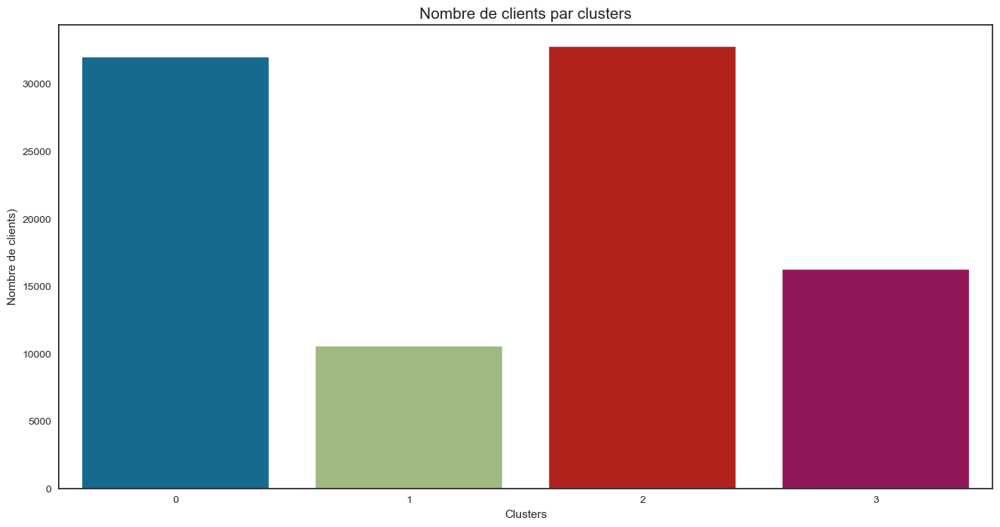

In [87]:
fonctions_segmentation.typage_clients_par_clusters(kmeans_4_labels)

**Projection 2D des clusters**

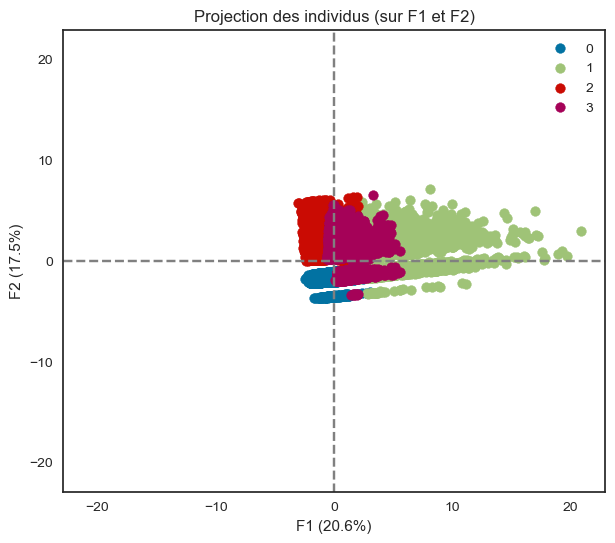

In [95]:
# Visualisation avec ACP
fonctions_data.display_factorial_planes(X_projected_log_acp, n_comp_log,
                                     pca_log, [(0, 1)], alpha=1,
                                     illustrative_var=kmeans_4_labels)

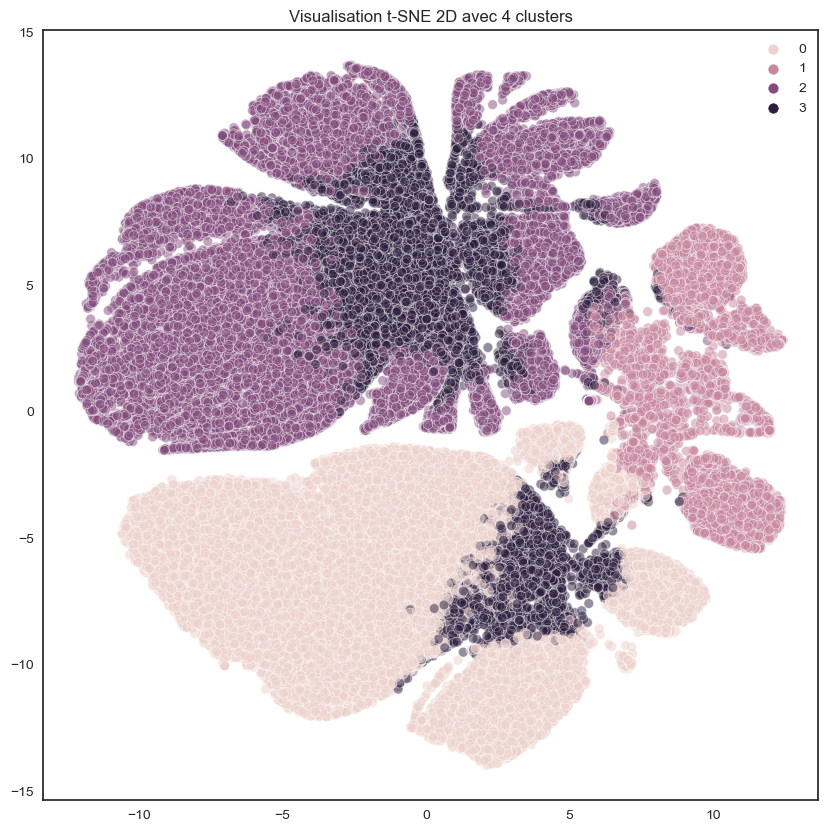

In [98]:
# Visualisation en 2D avec t-SNE

plt.figure(figsize=(10,10))
plot = sns.scatterplot(
                x=tsne_log[:,0], y=tsne_log[:,1],
                hue=kmeans_4_labels,
                legend="full",
                alpha=0.5).set(title = 'Visualisation t-SNE 2D avec 4 clusters')
    

plt.show()

**Analyse des 4 clusters**

In [99]:
summary_table_k4 = data_kmeans.groupby('Cluster_4').agg({'rfm_recence' : 'mean',
                                          'rfm_frequence' : 'mean',
                                          'rfm_montant' : 'mean',
                                          'note_avis_mean' : 'mean',
                                          'premier_achat_jour' : 'median',
                                          'dernier_achat_annee' : 'mean',
                                          'dernier_achat_mois' : 'median',
                                          'nbr_commandes' : 'mean',
                                          'nbr_articles_mean' : 'mean',
                                          'panier_moyen': 'mean',
                                          'echeance_paiement_mean' : 'median',
                                          'frais_port_mean' : 'mean'})

# Aggrégation des données par différentes fonctions
summary_table_k4.reset_index(inplace=True)
summary_table_k4.head()

,Cluster_4,rfm_recence,rfm_frequence,rfm_montant,note_avis_mean,premier_achat_jour,dernier_achat_annee,dernier_achat_mois,nbr_commandes,nbr_articles_mean,panier_moyen,echeance_paiement_mean,frais_port_mean
0,0,378.820064,1.041449,105.797111,4.243923,365.0,2016.993431,9.0,1.204054,1.000203,86.948202,1.0,17.122121
1,1,240.176252,2.758342,657.365885,3.684395,231.0,2017.549387,6.0,14.442628,1.608219,89.663236,2.0,18.485635
2,2,117.978655,1.036277,86.843740,4.249847,119.0,2018.000000,5.0,1.167552,1.001069,69.380219,1.0,15.995649
3,3,196.188671,1.044255,387.033010,4.091932,173.0,2017.749815,5.0,1.164941,1.001448,339.047367,5.0,35.937445


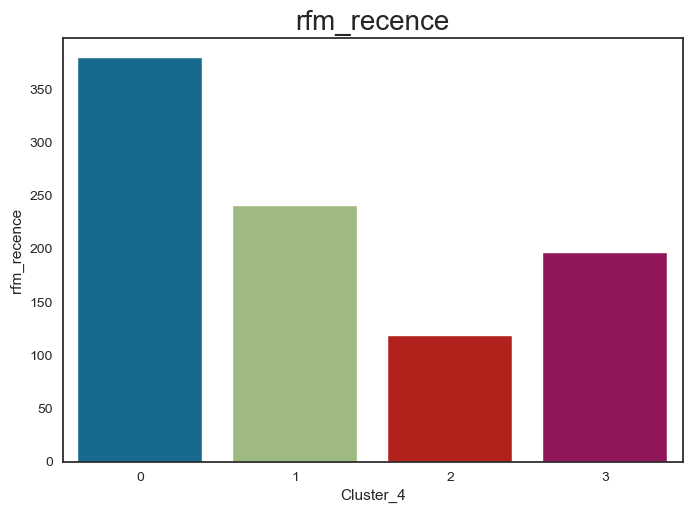

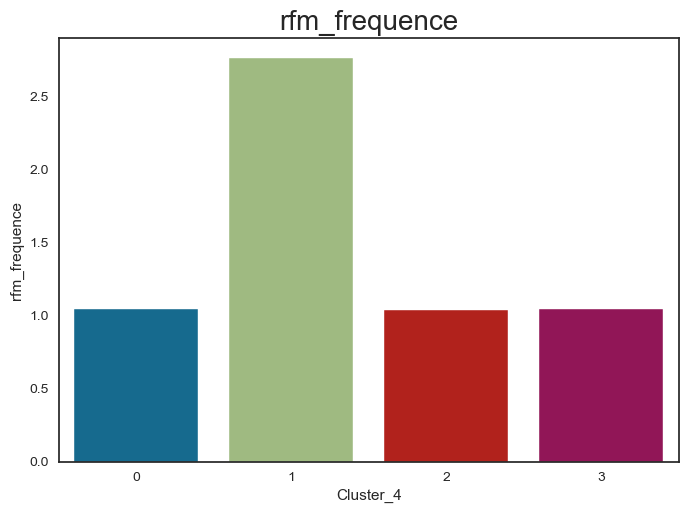

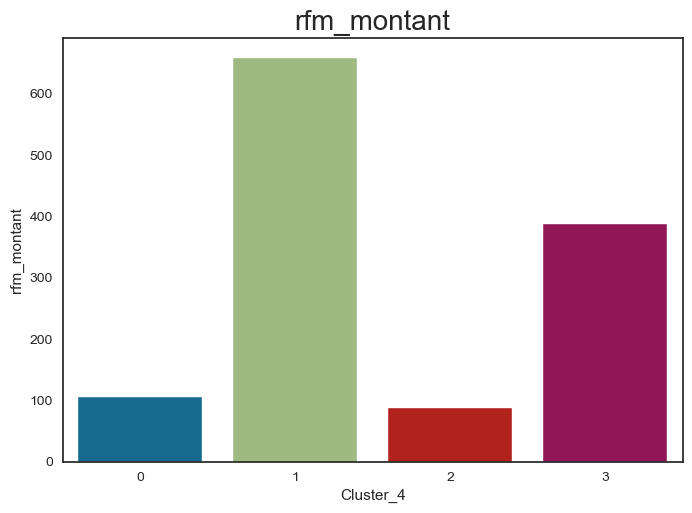

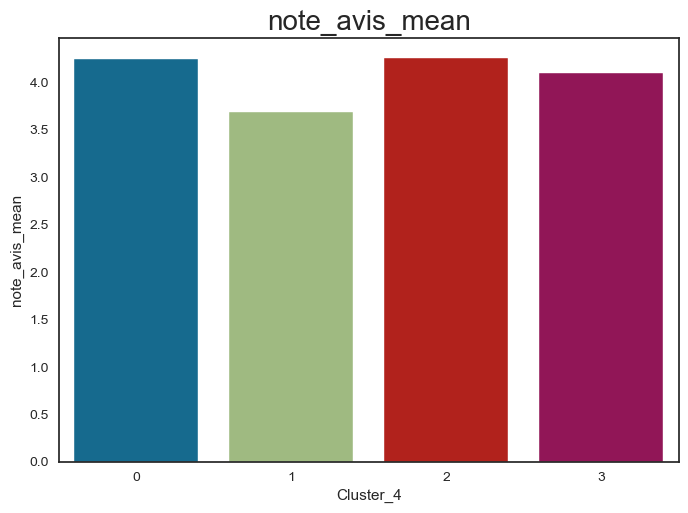

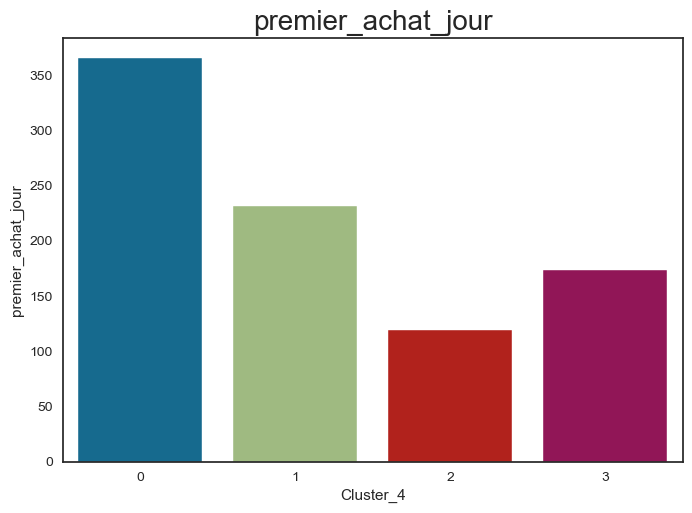

...

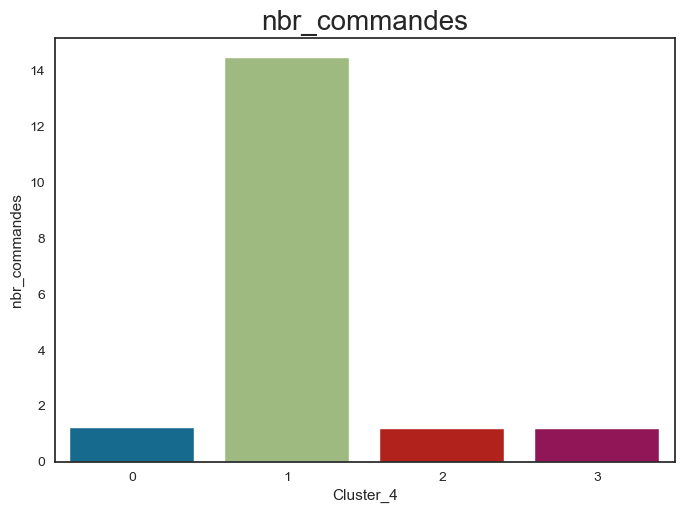

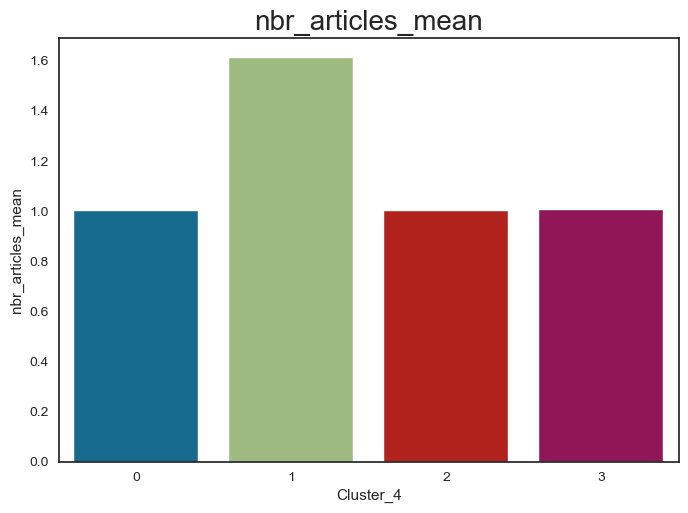

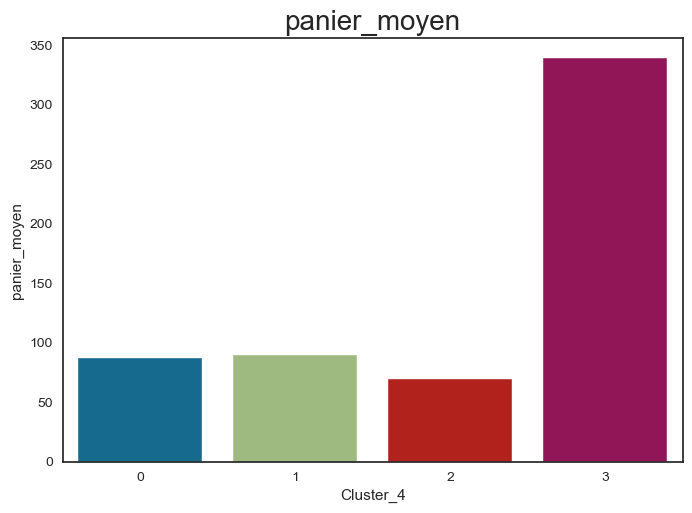

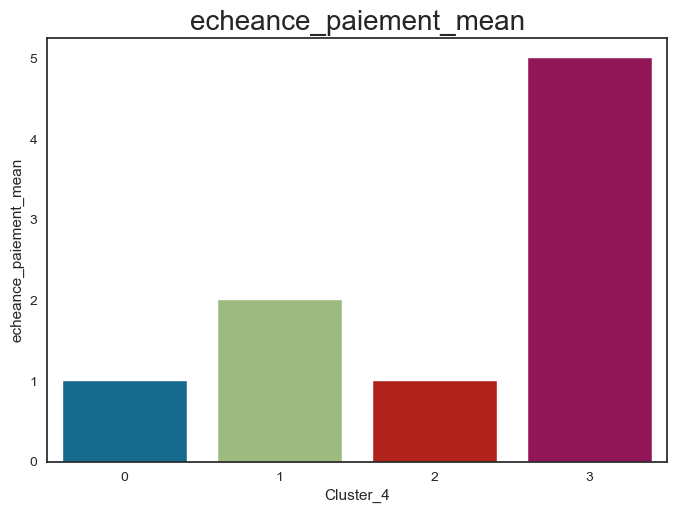

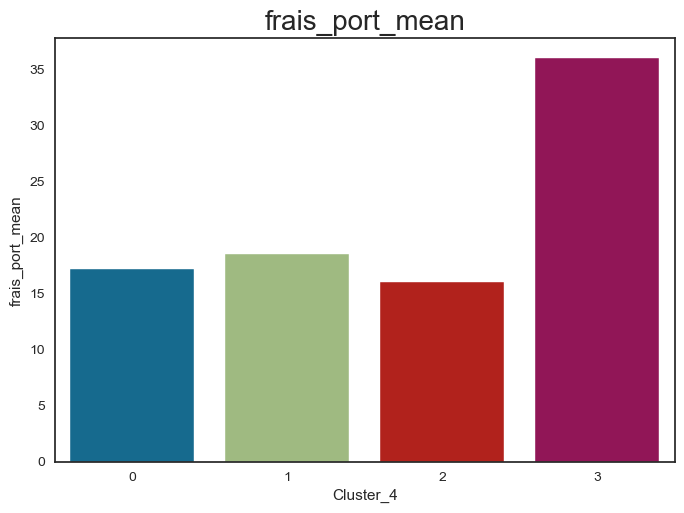

In [100]:
# Visualisation des moyennes des variables par clusters

res = summary_table_k4.columns[1:].to_list()

sns.set_style('white')

for col in res:
    
    sns.barplot(x=summary_table_k4["Cluster_4"], y=summary_table_k4[col])
    plt.title(col, fontsize=20)    
    plt.show()

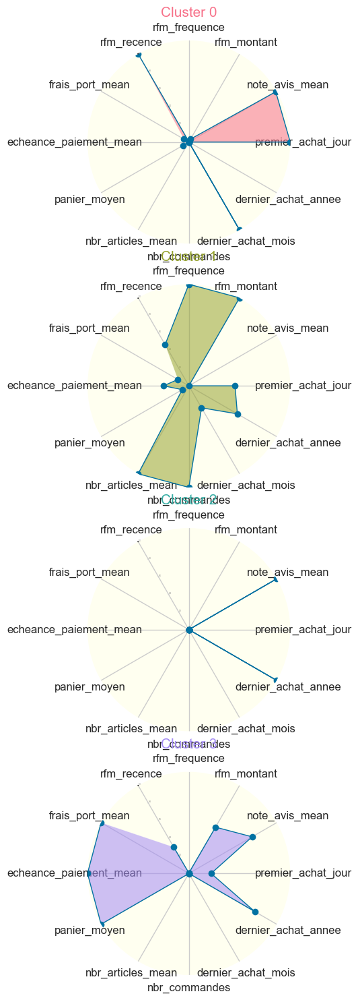

In [104]:
# Liste des couleurs pour chaque segment
palette = sns.color_palette("husl", summary_table_k4.shape[0])
colors = {label: color for label, color in zip(summary_table_k4['Cluster_4'],
                                                 palette.as_hex())}

fonctions_segmentation.affiche_radarplot_par_clusters(summary_table_k4, 'Cluster_4', 4, 1, colors,  sub_plot=[3, 3],  figsize=(30, 18))

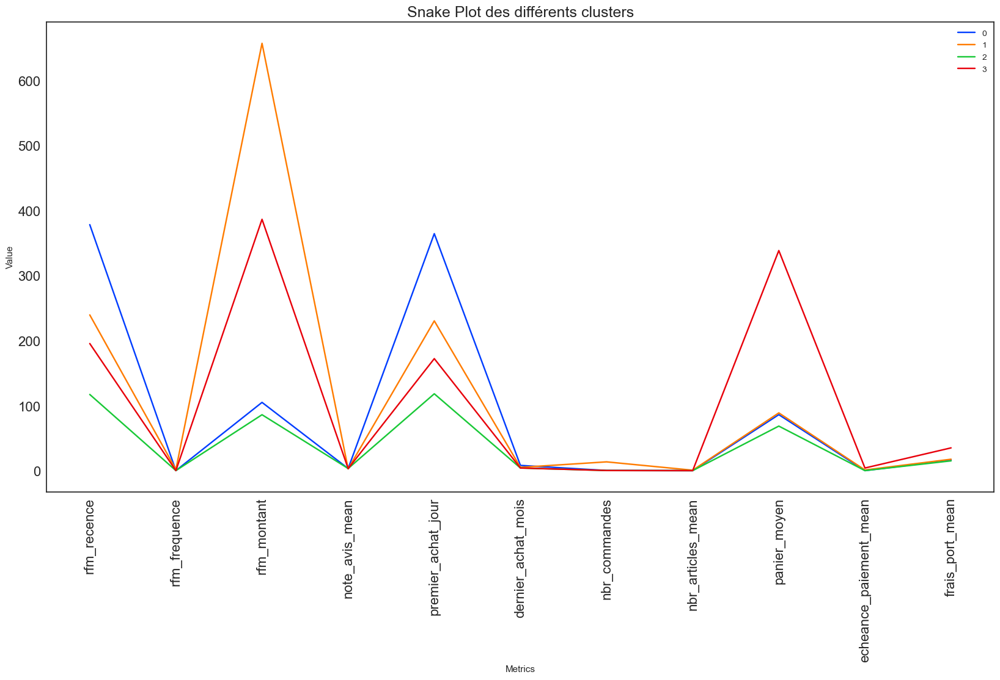

In [105]:

cols_a_interp = summary_table_k4.columns.to_list()
cols_a_interp.remove('dernier_achat_annee')
data_melt = pd.melt(frame=summary_table_k4[cols_a_interp],
                               id_vars=["Cluster_4"],
                               var_name='Metrics', value_name='Value')

# Visualisation : Snake plot des différentes variables moyennes

plt.figure(figsize=(20, 10))

sns.set_style('white')

sns.lineplot(x='Metrics', y='Value', hue='Cluster_4',
             data=data_melt, palette='bright')
plt.title('Snake Plot des différents clusters', fontsize='18')
plt.xticks(rotation=90, fontsize=16)
plt.yticks(fontsize=16)
plt.legend(loc='upper right')

plt.show()

**Constatation** :
***
- **Cluster 0** : commandes très anciennes, moyennement fréquentes et d'un montant correct, dernier achat très anciens ==> **Clients en sommeil ou perdus**. 

- **Cluster 1** : commandes récentes, fréquentes et d'un bon montant ==> **meilleurs clients**.

- **Cluster 2** : commandes très récentes, peu fréquentes et d'un faible montant ==> **nouveaux clients**.

- **Cluster 3** : Commandes moins récentes, moyennement fréquentes avec une bonne moyenne de montant ==> **Bon client sur le point de disparaitre**.

<span style='background:lavender'>**4.1.2.3 Segmentation KMeans - k=5 clusters**</span>

In [106]:
# Dataframe de sauvegarde des résultats des métriques KMeans
df_metrique_kmeans_k_5 = pd.DataFrame()

Pour n_clusters = 5 
 Le silhouette score moyen est de : 0.15801255478167758 
 Le score de Gini moyen est de : 0.3994465583473653 
 Le temps d'entrainement du modèle est de : 10.138450527191162 (s)


Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
Kmeans 5 clusters,5,10,k-means++,0.157901,844260.782824,1.748135,0.374985,3.642960
Kmeans 5 clusters,5,10,random,0.157969,844261.968818,1.749926,0.401594,2.992546
Kmeans 5 clusters,5,20,k-means++,0.157901,844260.782824,1.748135,0.374985,6.555321
Kmeans 5 clusters,5,20,random,0.158154,844260.851445,1.748242,0.411539,5.946335
Kmeans 5 clusters,5,30,k-means++,0.157901,844260.782824,1.748135,0.374985,8.601344
Kmeans 5 clusters,5,30,random,0.158154,844260.851445,1.748242,0.411539,8.628451
Kmeans 5 clusters,5,50,k-means++,0.157901,844260.782824,1.748135,0.374985,15.470588
Kmeans 5 clusters,5,50,random,0.158154,844260.851445,1.748242,0.411539,14.120226
Kmeans 5 clusters,5,70,k-means++,0.158099,844260.662215,1.749230,0.377600,15.580561
Kmeans 5 clusters,5,70,random,0.157991,844260.277665,1.748578,0.480718,19.846172


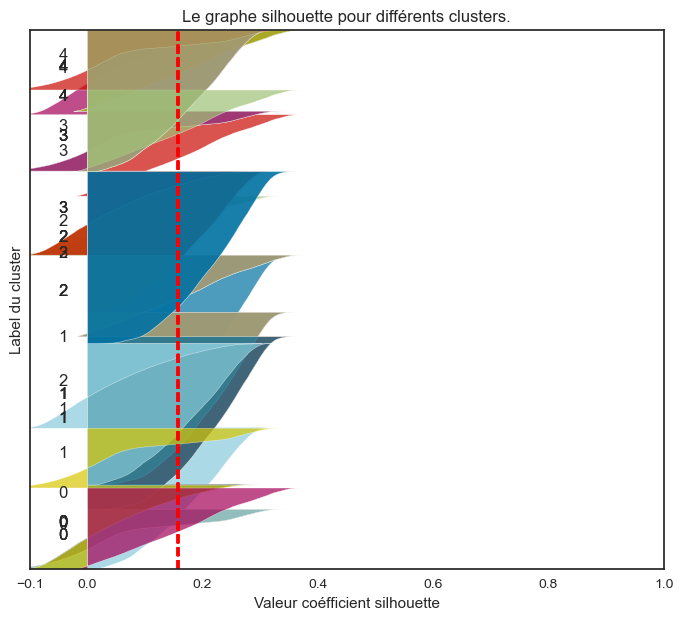

In [107]:
# Tuning hyperparametres n_init et init
# Métriques pour les données quantitatives standardisées, non transformées
# en logarithme
# Paramètres à tester
n_clusters = [5]
n_init = [10, 20, 30, 50, 70]
init = ['k-means++', 'random']
# Métriques avec les différentes combinaisons des paramètres
#fonctions_segmentation.
df_metrique_kmeans_k_5 = calcul_metrique_kmeans(X_scaled_log, df_metrique_kmeans_k_5,
                                              'Kmeans 5 clusters', seed,
                                              n_clusters, n_init, init)
df_metrique_kmeans_k_5.style.hide_index()

In [108]:
# Tri par indice de dispersion : proche de 0
df_metrique_kmeans_k_5.sort_values(by=['Type_données', 'dispersion'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
9,Kmeans 5 clusters,5,70,random,0.157991,844260.277665,1.748578,0.480718,19.846172
8,Kmeans 5 clusters,5,70,k-means++,0.158099,844260.662215,1.749230,0.377600,15.580561
0,Kmeans 5 clusters,5,10,k-means++,0.157901,844260.782824,1.748135,0.374985,3.642960
2,Kmeans 5 clusters,5,20,k-means++,0.157901,844260.782824,1.748135,0.374985,6.555321
4,Kmeans 5 clusters,5,30,k-means++,0.157901,844260.782824,1.748135,0.374985,8.601344
6,Kmeans 5 clusters,5,50,k-means++,0.157901,844260.782824,1.748135,0.374985,15.470588
3,Kmeans 5 clusters,5,20,random,0.158154,844260.851445,1.748242,0.411539,5.946335
5,Kmeans 5 clusters,5,30,random,0.158154,844260.851445,1.748242,0.411539,8.628451
7,Kmeans 5 clusters,5,50,random,0.158154,844260.851445,1.748242,0.411539,14.120226
1,Kmeans 5 clusters,5,10,random,0.157969,844261.968818,1.749926,0.401594,2.992546


In [109]:
# Tri par score de silhouette : proche de 1
df_metrique_kmeans_k_5.sort_values(by=['Type_données', 'coef_silh'],
                                  ascending=[False, False])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
3,Kmeans 5 clusters,5,20,random,0.158154,844260.851445,1.748242,0.411539,5.946335
5,Kmeans 5 clusters,5,30,random,0.158154,844260.851445,1.748242,0.411539,8.628451
7,Kmeans 5 clusters,5,50,random,0.158154,844260.851445,1.748242,0.411539,14.120226
8,Kmeans 5 clusters,5,70,k-means++,0.158099,844260.662215,1.749230,0.377600,15.580561
9,Kmeans 5 clusters,5,70,random,0.157991,844260.277665,1.748578,0.480718,19.846172
1,Kmeans 5 clusters,5,10,random,0.157969,844261.968818,1.749926,0.401594,2.992546
0,Kmeans 5 clusters,5,10,k-means++,0.157901,844260.782824,1.748135,0.374985,3.642960
2,Kmeans 5 clusters,5,20,k-means++,0.157901,844260.782824,1.748135,0.374985,6.555321
4,Kmeans 5 clusters,5,30,k-means++,0.157901,844260.782824,1.748135,0.374985,8.601344
6,Kmeans 5 clusters,5,50,k-means++,0.157901,844260.782824,1.748135,0.374985,15.470588


In [110]:
# Tri par indice de davies-bouldin : proche de 0
df_metrique_kmeans_k_5.sort_values(by=['Type_données', 'davies_bouldin'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
0,Kmeans 5 clusters,5,10,k-means++,0.157901,844260.782824,1.748135,0.374985,3.642960
2,Kmeans 5 clusters,5,20,k-means++,0.157901,844260.782824,1.748135,0.374985,6.555321
4,Kmeans 5 clusters,5,30,k-means++,0.157901,844260.782824,1.748135,0.374985,8.601344
6,Kmeans 5 clusters,5,50,k-means++,0.157901,844260.782824,1.748135,0.374985,15.470588
3,Kmeans 5 clusters,5,20,random,0.158154,844260.851445,1.748242,0.411539,5.946335
5,Kmeans 5 clusters,5,30,random,0.158154,844260.851445,1.748242,0.411539,8.628451
7,Kmeans 5 clusters,5,50,random,0.158154,844260.851445,1.748242,0.411539,14.120226
9,Kmeans 5 clusters,5,70,random,0.157991,844260.277665,1.748578,0.480718,19.846172
8,Kmeans 5 clusters,5,70,k-means++,0.158099,844260.662215,1.749230,0.377600,15.580561
1,Kmeans 5 clusters,5,10,random,0.157969,844261.968818,1.749926,0.401594,2.992546


In [111]:
# Tri par indice de Gini : proche de 0
df_metrique_kmeans_k_5.sort_values(by=['Type_données', 'indice_gini'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
0,Kmeans 5 clusters,5,10,k-means++,0.157901,844260.782824,1.748135,0.374985,3.642960
2,Kmeans 5 clusters,5,20,k-means++,0.157901,844260.782824,1.748135,0.374985,6.555321
4,Kmeans 5 clusters,5,30,k-means++,0.157901,844260.782824,1.748135,0.374985,8.601344
6,Kmeans 5 clusters,5,50,k-means++,0.157901,844260.782824,1.748135,0.374985,15.470588
8,Kmeans 5 clusters,5,70,k-means++,0.158099,844260.662215,1.749230,0.377600,15.580561
1,Kmeans 5 clusters,5,10,random,0.157969,844261.968818,1.749926,0.401594,2.992546
3,Kmeans 5 clusters,5,20,random,0.158154,844260.851445,1.748242,0.411539,5.946335
5,Kmeans 5 clusters,5,30,random,0.158154,844260.851445,1.748242,0.411539,8.628451
7,Kmeans 5 clusters,5,50,random,0.158154,844260.851445,1.748242,0.411539,14.120226
9,Kmeans 5 clusters,5,70,random,0.157991,844260.277665,1.748578,0.480718,19.846172


**Constatation** :
***
Les meilleurs scores sont trouvés pour : 
- n_init=10.
- init= k-means++ (paramètre 'random' par défaut).

In [72]:
%%time
# Instanciation du modèle KMeans pour 5 clusters et  meilleurs paramètres
kmeans_5 = KMeans(n_clusters=5, init='k-means++', random_state=seed)
clusters_km_5 = kmeans_5.fit(X_scaled_log)
kmeans_5_labels = kmeans_5.labels_

CPU times: total: 9.5 s
Wall time: 3.54 s


In [73]:
# Préparation dataframe d'interprétation
# Ajout de l'assignation du cluster au dataframe
data_kmeans = data_clients.copy()
data_kmeans['Cluster_5'] = kmeans_5.labels_

**Distribution clients par cluster**

Clusters,Nb_clients,%
0,14393,15.740000
1,29188,31.910000
2,23981,26.220000
3,10141,11.090000
4,13755,15.040000


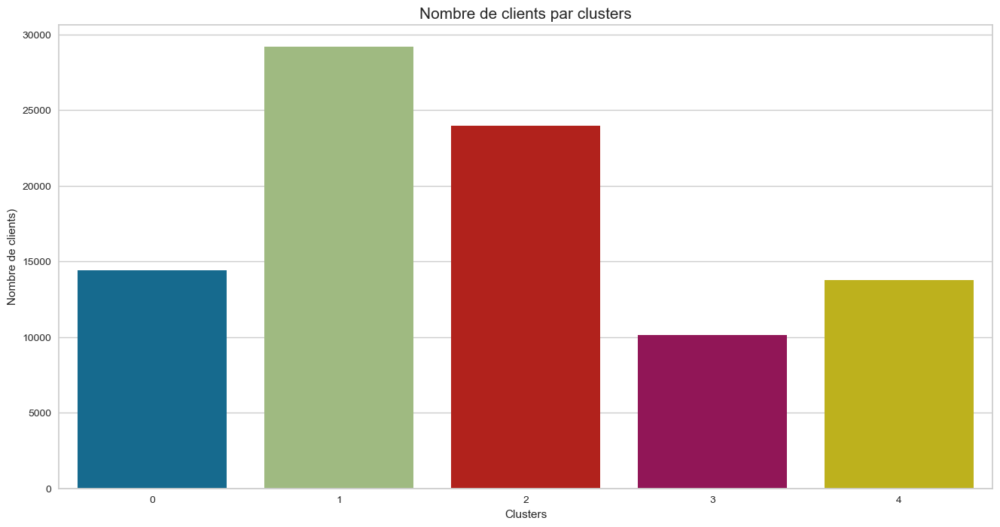

In [74]:
fonctions_segmentation.typage_clients_par_clusters(kmeans_5_labels)

**Projection 2D des clusters**

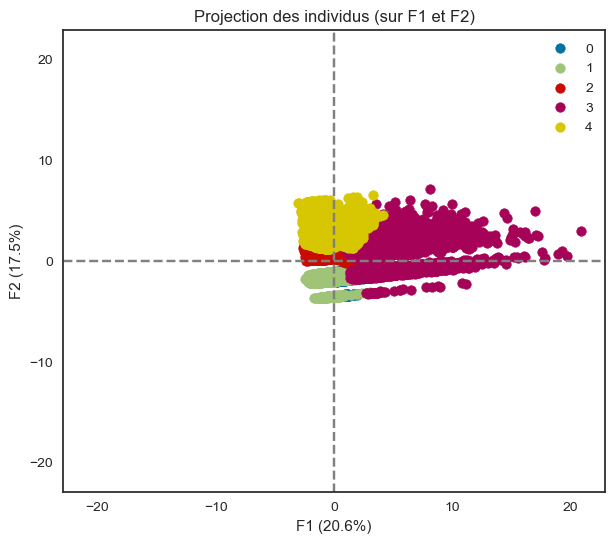

In [116]:
# Visualisation avec ACP
fonctions_data.display_factorial_planes(X_projected_log_acp, n_comp_log,
                                     pca_log, [(0, 1)], alpha=1,
                                     illustrative_var=kmeans_5_labels)

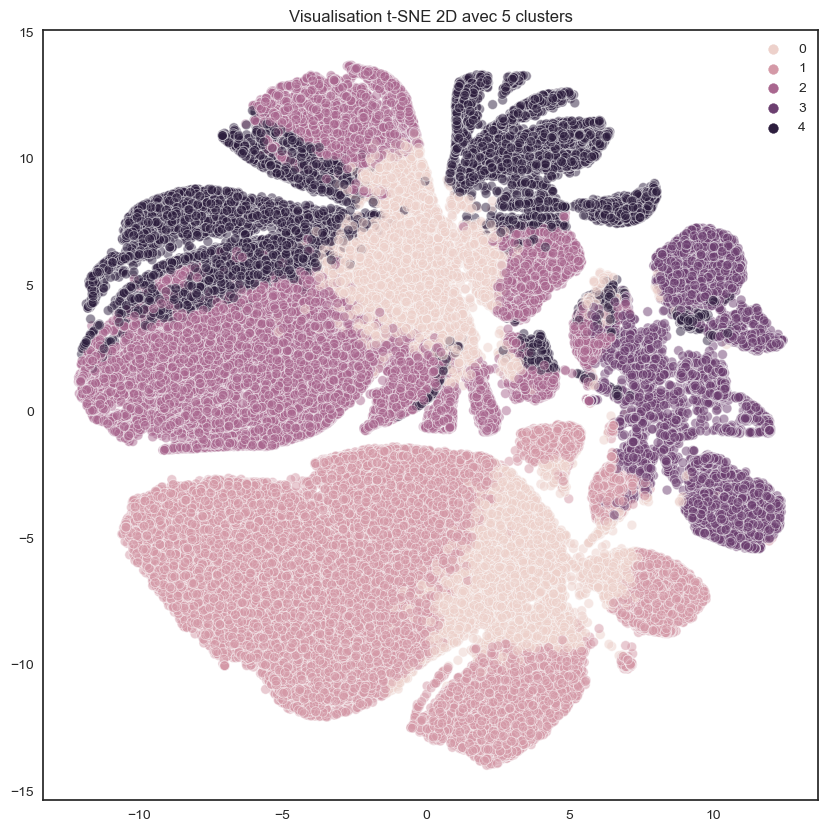

In [117]:
# Visualisation en 2D avec t-SNE

plt.figure(figsize=(10,10))
plot = sns.scatterplot(
                x=tsne_log[:,0], y=tsne_log[:,1],
                hue=kmeans_5_labels,
                legend="full",
                alpha=0.5).set(title = 'Visualisation t-SNE 2D avec 5 clusters')
    

plt.show()

In [119]:
summary_table_k5 = data_kmeans.groupby('Cluster_5').agg({'rfm_recence' : 'mean',
                                          'rfm_frequence' : 'mean',
                                          'rfm_montant' : 'mean',
                                          'note_avis_mean' : 'mean',
                                          'premier_achat_jour' : 'median',
                                          'dernier_achat_annee' : 'mean',
                                          'dernier_achat_mois' : 'median',
                                          'nbr_commandes' : 'mean',
                                          'nbr_articles_mean' : 'mean',
                                          'panier_moyen': 'mean',
                                          'echeance_paiement_mean' : 'median',
                                          'frais_port_mean' : 'mean'})

# Aggrégation des données par différentes fonctions
summary_table_k5.reset_index(inplace=True)
summary_table_k5.head()

,Cluster_5,rfm_recence,rfm_frequence,rfm_montant,note_avis_mean,premier_achat_jour,dernier_achat_annee,dernier_achat_mois,nbr_commandes,nbr_articles_mean,panier_moyen,echeance_paiement_mean,frais_port_mean
0,0,258.430487,1.045439,410.843787,4.085134,233.0,2017.521712,5.0,1.170361,1.001633,360.841220,6.0,36.066852
1,1,378.023845,1.041969,94.596344,4.252278,364.0,2016.993490,9.0,1.210052,1.000206,76.656456,1.0,16.469357
2,2,162.858847,1.038864,90.704097,4.143405,165.0,2018.000000,3.0,1.179225,1.000167,73.207589,1.0,15.830522
3,3,246.173158,2.785426,669.813273,3.667684,236.0,2017.535154,6.0,14.785031,1.617726,89.543175,2.0,18.526536
4,4,38.340603,1.058888,129.256726,4.399370,35.0,2018.000000,7.0,1.248201,1.011996,101.833793,1.0,20.453704


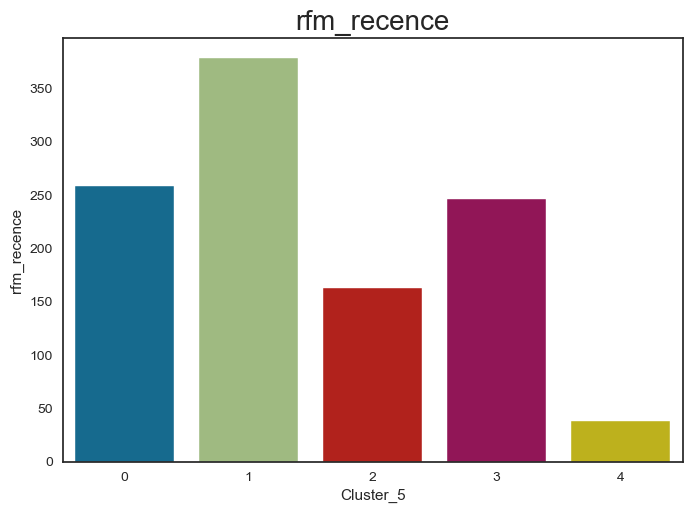

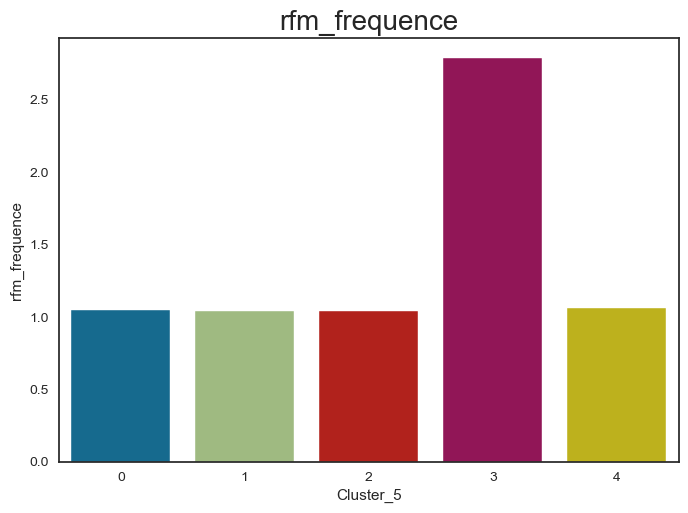

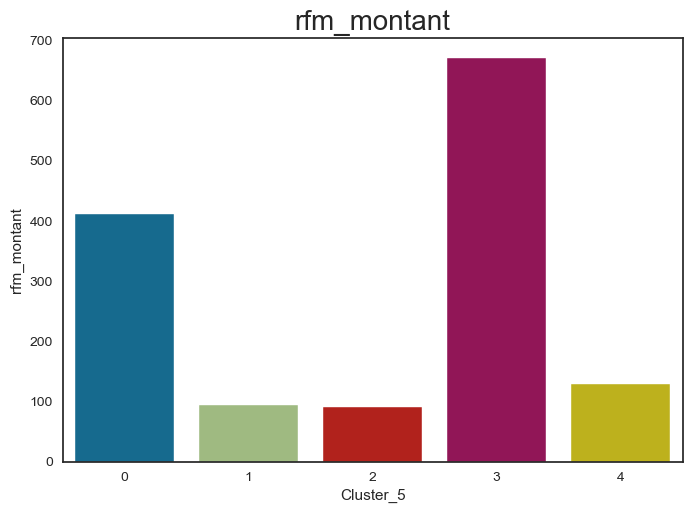

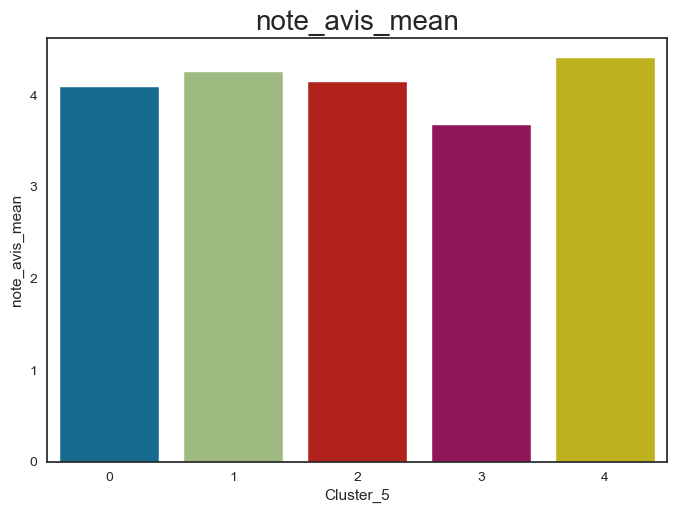

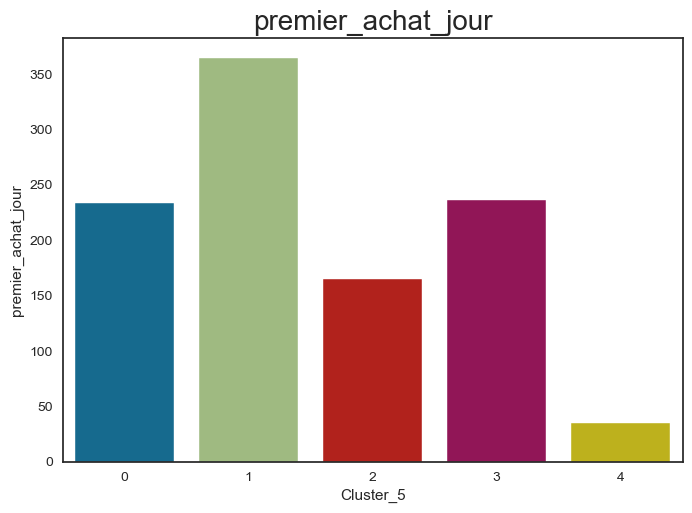

...

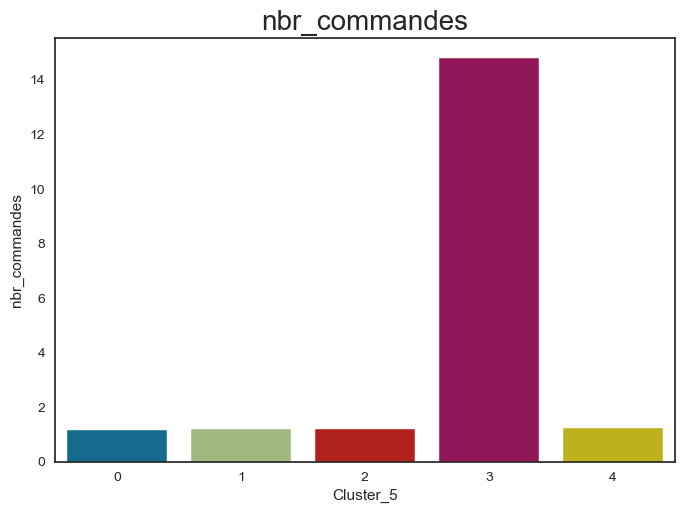

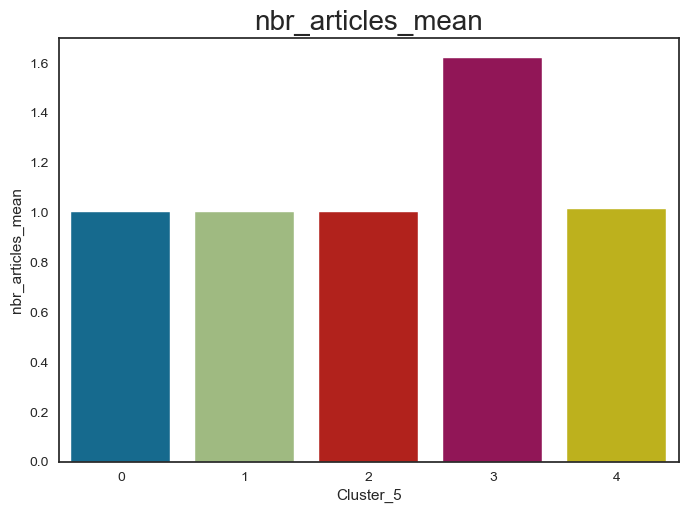

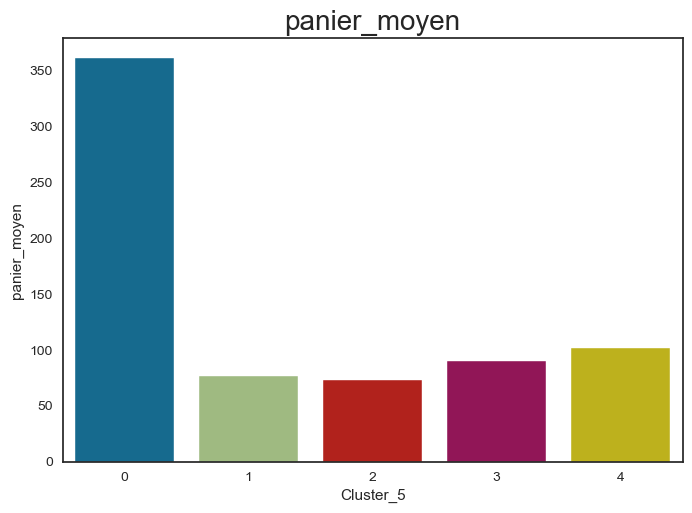

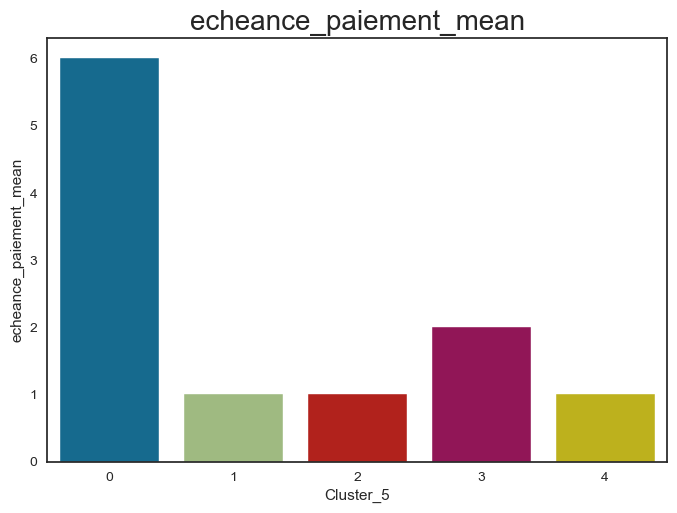

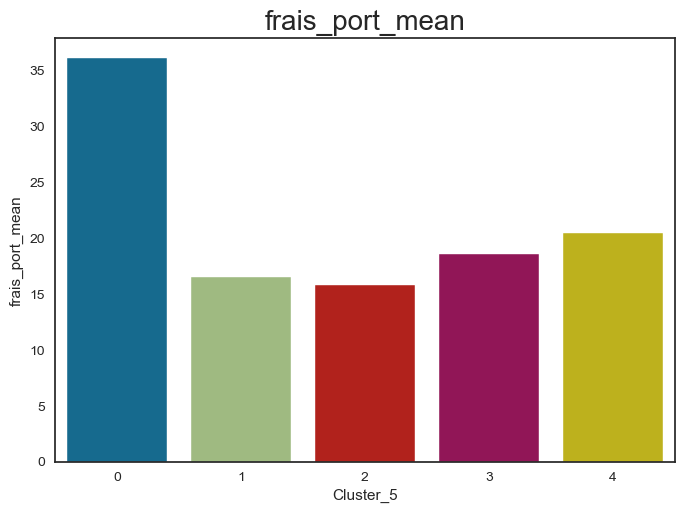

In [120]:
# Visualisation des moyennes des variables par clusters

res = summary_table_k5.columns[1:].to_list()

sns.set_style('white')

for col in res:
    
    sns.barplot(x=summary_table_k5["Cluster_5"], y=summary_table_k5[col])
    plt.title(col, fontsize=20)    
    plt.show()

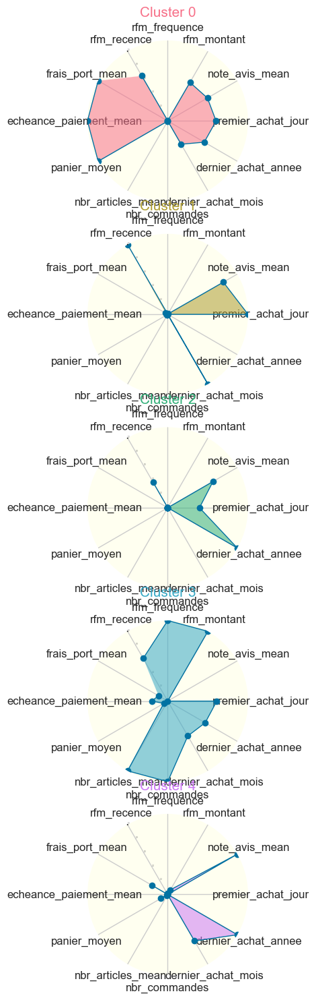

In [122]:
# Liste des couleurs pour chaque segment
palette = sns.color_palette("husl", summary_table_k5.shape[0])
colors = {label: color for label, color in zip(summary_table_k5['Cluster_5'],
                                                 palette.as_hex())}

fonctions_segmentation.affiche_radarplot_par_clusters(summary_table_k5, 'Cluster_5', 5, 1, colors,  sub_plot=[3, 3],  figsize=(36, 18))

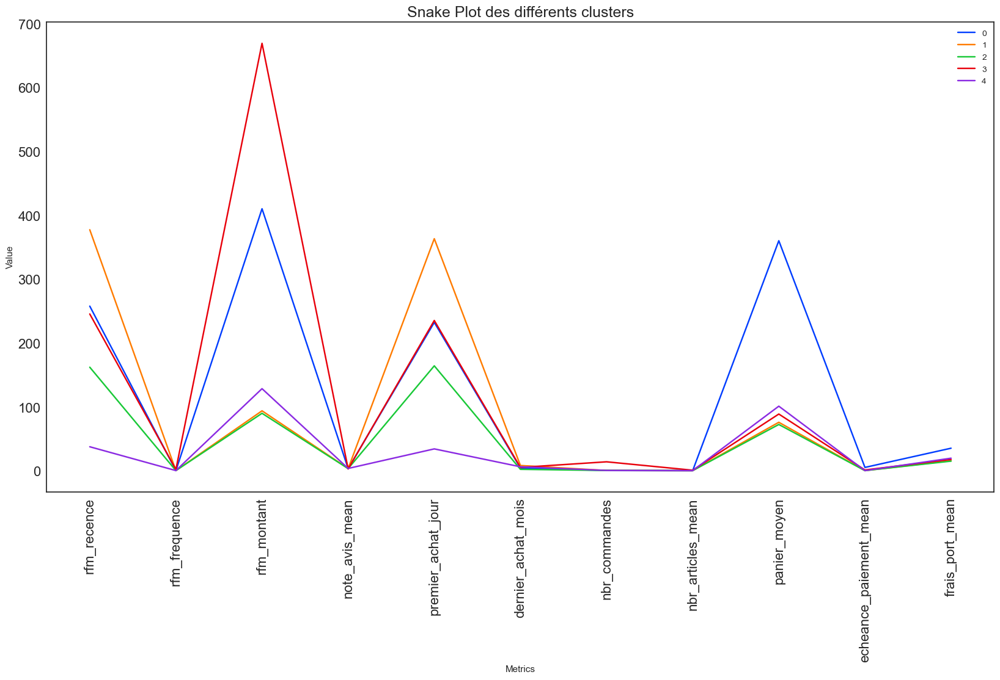

In [123]:

cols_a_interp = summary_table_k5.columns.to_list()
cols_a_interp.remove('dernier_achat_annee')
data_melt = pd.melt(frame=summary_table_k5[cols_a_interp],
                               id_vars=["Cluster_5"],
                               var_name='Metrics', value_name='Value')

# Visualisation : Snake plot des différentes variables moyennes

plt.figure(figsize=(20, 10))

sns.set_style('white')

sns.lineplot(x='Metrics', y='Value', hue='Cluster_5',
             data=data_melt, palette='bright')
plt.title('Snake Plot des différents clusters', fontsize='18')
plt.xticks(rotation=90, fontsize=16)
plt.yticks(fontsize=16)
plt.legend(loc='upper right')

plt.show()

**Constatation** :
***
- **Cluster 0** : commandes assez récentes, fréquentes et d'un montant élevé, utilisation d'un grand nombre d'échelonnement de paiement ==> **meilleurs clients utilisant des facilités de paiement.**  
- **Cluster 1** : commandes anciennes, peu fréquentes et d'un montant moyen bas, dernier achat très anciens ==> **clients presque perdus.**
- **Cluster 2** :  commandes assez récentes, fréquentes et d'un montant élevé ==> **meilleurs clients fidèles.**
- **Cluster 3** :  commandes assez récentes, peu fréquentes et d'un montant moyen ==> **Bons clients sur le point de dormir.**
- **Cluster 4** :  commandes très récentes, peu fréquentes et d'un montant moyen bas ==> **nouveaux clients.**

### <span style='background:aquamarine'>4.2 ACP + K-Means</span>

Utilisation de la projections de l'ACP avec 9 composantes sur les données quantitatives transformées en logarithme en entrée de l'algorithme KMeans.

**Recherche des hyperparamètres**

In [29]:
# Dataframe de sauvegarde des résultats des métriques KMeans
df_metrics_kmeans_acp = pd.DataFrame()

Pour n_clusters = 7 
 Le silhouette score moyen est de : 0.18232838833681156 
 Le score de Gini moyen est de : 0.4127754941404479 
 Le temps d'entrainement du modèle est de : 7.02454149723053 (s)


Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
ACP + Kmeans,3,10,k-means++,0.200197,888898.294545,1.693948,0.317798,2.461583
ACP + Kmeans,3,10,random,0.200185,888898.390320,1.694113,0.288192,2.321521
ACP + Kmeans,3,20,k-means++,0.200197,888898.294545,1.693948,0.317798,4.278312
ACP + Kmeans,3,20,random,0.200185,888898.390320,1.694113,0.288192,4.184149
ACP + Kmeans,3,30,k-means++,0.200195,888898.079386,1.693972,0.394041,6.426589
ACP + Kmeans,3,30,random,0.200197,888898.235249,1.693948,0.348869,6.153017
ACP + Kmeans,3,50,k-means++,0.200195,888898.079386,1.693972,0.394041,10.530515
ACP + Kmeans,3,50,random,0.200190,888898.088583,1.694047,0.378502,10.237245
ACP + Kmeans,3,70,k-means++,0.200195,888898.079386,1.693972,0.394041,14.784121
ACP + Kmeans,3,70,random,0.200190,888898.088583,1.694047,0.378502,14.368832


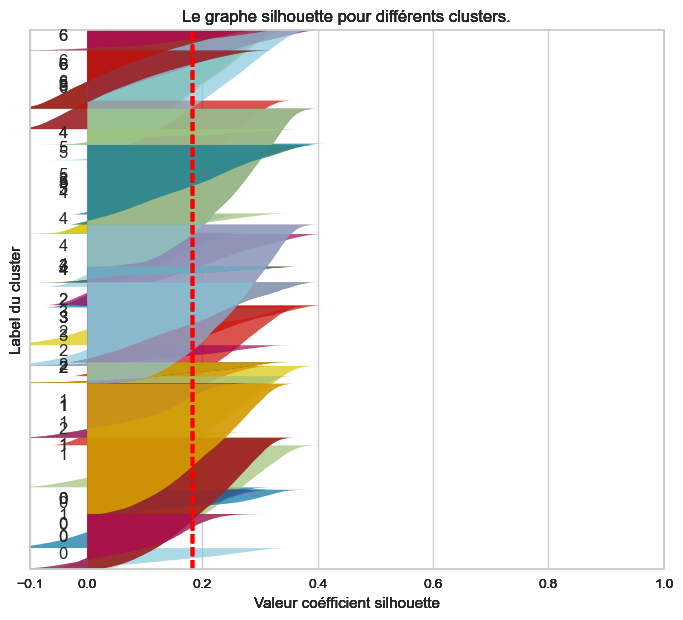

In [30]:
# Tuning hyperparametres n_init et init
# Métriques pour les données quantitatives standardisées, non transformées
# en logarithme
# Paramètres à tester
nb_clusters = [3, 4, 5, 6, 7]
n_init = [10, 20, 30, 50, 70]
init = ['k-means++', 'random']
# Métriques avec les différentes combinaisons
df_metrics_kmeans_acp = \
    fonctions_segmentation.calcul_metrique_kmeans(X_projected_log_acp,
                                              df_metrics_kmeans_acp,
                                              'ACP + Kmeans ', seed,
                                              nb_clusters, n_init, init)
df_metrics_kmeans_acp.style.hide_index()

In [31]:
# Tri par indice de dispersion : proche de 0
df_metrics_kmeans_acp.sort_values(by=['Type_données', 'dispersion'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
47,ACP + Kmeans,7,50,random,0.182717,664073.054290,1.559633,0.420688,8.382902
49,ACP + Kmeans,7,70,random,0.182717,664073.054290,1.559633,0.420688,12.089257
42,ACP + Kmeans,7,20,k-means++,0.182581,664076.616157,1.561086,0.573075,3.580370
44,ACP + Kmeans,7,30,k-means++,0.182581,664076.616157,1.561086,0.573075,5.147657
46,ACP + Kmeans,7,50,k-means++,0.182581,664076.616157,1.561086,0.573075,8.652731
48,ACP + Kmeans,7,70,k-means++,0.182581,664076.616157,1.561086,0.573075,11.786202
45,ACP + Kmeans,7,30,random,0.162890,664852.080081,1.608595,0.499903,4.940517
43,ACP + Kmeans,7,20,random,0.162426,664852.201152,1.610314,0.478932,3.513724
41,ACP + Kmeans,7,10,random,0.162783,664852.619014,1.609110,0.513587,1.861838
40,ACP + Kmeans,7,10,k-means++,0.157382,672413.315813,1.743316,0.448158,1.824975


In [32]:
# Tri par score de silhouette : proche de 1
df_metrics_kmeans_acp.sort_values(by=['Type_données', 'coef_silh'],
                                  ascending=[False, False])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
0,ACP + Kmeans,3,10,k-means++,0.200197,888898.294545,1.693948,0.317798,2.461583
2,ACP + Kmeans,3,20,k-means++,0.200197,888898.294545,1.693948,0.317798,4.278312
5,ACP + Kmeans,3,30,random,0.200197,888898.235249,1.693948,0.348869,6.153017
4,ACP + Kmeans,3,30,k-means++,0.200195,888898.079386,1.693972,0.394041,6.426589
6,ACP + Kmeans,3,50,k-means++,0.200195,888898.079386,1.693972,0.394041,10.530515
8,ACP + Kmeans,3,70,k-means++,0.200195,888898.079386,1.693972,0.394041,14.784121
7,ACP + Kmeans,3,50,random,0.200190,888898.088583,1.694047,0.378502,10.237245
9,ACP + Kmeans,3,70,random,0.200190,888898.088583,1.694047,0.378502,14.368832
1,ACP + Kmeans,3,10,random,0.200185,888898.390320,1.694113,0.288192,2.321521
3,ACP + Kmeans,3,20,random,0.200185,888898.390320,1.694113,0.288192,4.184149


In [33]:
# Tri par indice de davies-bouldin : proche de 0
df_metrics_kmeans_acp.sort_values(by=['Type_données', 'davies_bouldin'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
30,ACP + Kmeans,6,10,k-means++,0.181016,702085.529796,1.539793,0.472692,1.664622
32,ACP + Kmeans,6,20,k-means++,0.181016,702085.529796,1.539793,0.472692,3.413372
33,ACP + Kmeans,6,20,random,0.180808,702073.464113,1.542171,0.395586,3.267246
35,ACP + Kmeans,6,30,random,0.180808,702073.464113,1.542171,0.395586,4.872363
37,ACP + Kmeans,6,50,random,0.180808,702073.464113,1.542171,0.395586,7.890011
39,ACP + Kmeans,6,70,random,0.180808,702073.464113,1.542171,0.395586,10.983331
34,ACP + Kmeans,6,30,k-means++,0.180761,702077.728834,1.543401,0.492439,5.075657
36,ACP + Kmeans,6,50,k-means++,0.180761,702077.728834,1.543401,0.492439,8.641017
38,ACP + Kmeans,6,70,k-means++,0.180761,702077.728834,1.543401,0.492439,11.990415
31,ACP + Kmeans,6,10,random,0.180742,702078.700515,1.543556,0.552042,1.911143


In [34]:
# Tri par indice de Gini : proche de 0
df_metrics_kmeans_acp.sort_values(by=['Type_données', 'indice_gini'],
                                  ascending=[False, True])

,Type_données,nbr_clusters,n_init,type_init,coef_silh,dispersion,davies_bouldin,indice_gini,Durée (s)
1,ACP + Kmeans,3,10,random,0.200185,888898.390320,1.694113,0.288192,2.321521
3,ACP + Kmeans,3,20,random,0.200185,888898.390320,1.694113,0.288192,4.184149
0,ACP + Kmeans,3,10,k-means++,0.200197,888898.294545,1.693948,0.317798,2.461583
2,ACP + Kmeans,3,20,k-means++,0.200197,888898.294545,1.693948,0.317798,4.278312
14,ACP + Kmeans,4,30,k-means++,0.183962,814641.527347,1.700440,0.323210,7.218244
16,ACP + Kmeans,4,50,k-means++,0.183962,814641.527347,1.700440,0.323210,11.913852
18,ACP + Kmeans,4,70,k-means++,0.183962,814641.527347,1.700440,0.323210,16.970241
10,ACP + Kmeans,4,10,k-means++,0.184024,814647.786140,1.707327,0.324384,2.506053
12,ACP + Kmeans,4,20,k-means++,0.184024,814647.786140,1.707327,0.324384,5.139119
5,ACP + Kmeans,3,30,random,0.200197,888898.235249,1.693948,0.348869,6.153017


In [26]:
%%time
# Instanciation du modèle KMeans pour 5 clusters et  meilleurs paramètres
kmeans_acp_5 = KMeans(n_clusters=5, init='k-means++', random_state=seed)
clusters_km_5 = kmeans_acp_5.fit(X_scaled_log)
kmeans_acp_5_labels = kmeans_acp_5.labels_

CPU times: total: 9.95 s
Wall time: 3.45 s


In [36]:
# Préparation dataframe d'interprétation
# Ajout de l'assignation du cluster au dataframe
data_kmeans = data_clients.copy()
data_kmeans['Cluster_5_acp'] = kmeans_acp_5.labels_

**Répartition des clients**

Clusters,Nb_clients,%
0,14393,15.740000
1,29188,31.910000
2,23981,26.220000
3,10141,11.090000
4,13755,15.040000


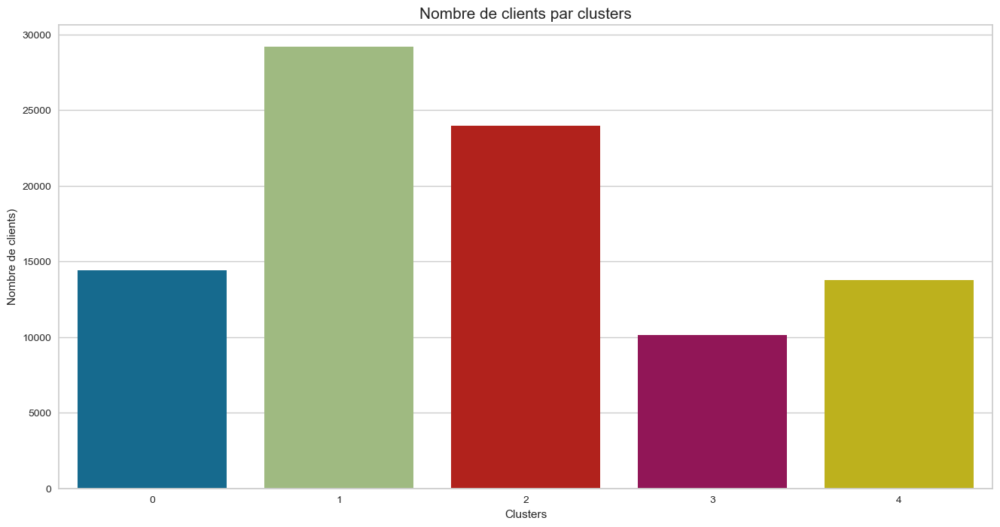

In [28]:
fonctions_segmentation.typage_clients_par_clusters(kmeans_acp_5_labels)

**Projection en 2D**

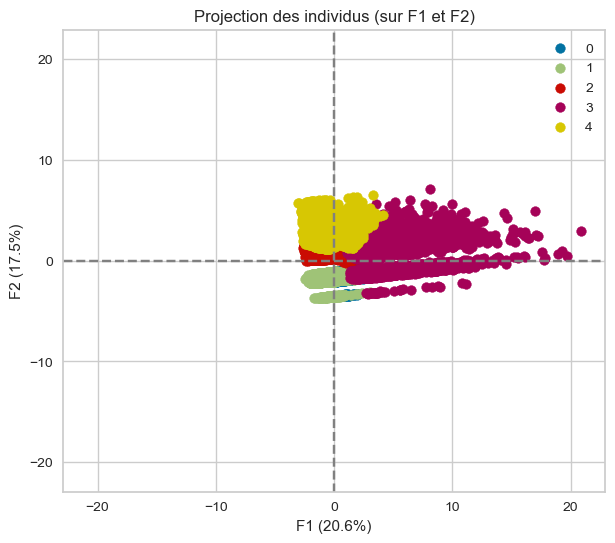

In [31]:
# Visualisation avec ACP
fonctions_data.display_factorial_planes(X_projected_log_acp, n_comp_log,
                                     pca_log, [(0, 1)], alpha=1,
                                     illustrative_var=kmeans_acp_5_labels)



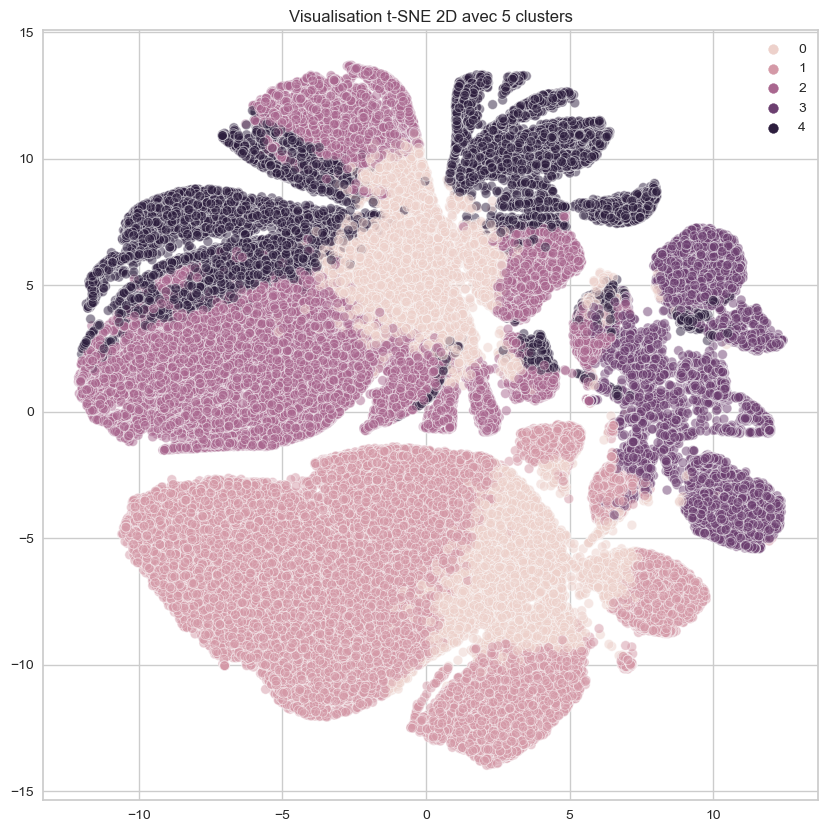

In [34]:
# Visualisation en 2D avec t-SNE

plt.figure(figsize=(10,10))
plot = sns.scatterplot(
                x=tsne_log[:,0], y=tsne_log[:,1],
                hue=kmeans_acp_5_labels,
                legend="full",
                alpha=0.5).set(title = 'Visualisation t-SNE 2D avec 5 clusters')
    

plt.show()

**Interprétation des 5 clusters**

In [37]:
summary_table_k5_acp = data_kmeans.groupby('Cluster_5_acp').agg({'rfm_recence' : 'mean',
                                          'rfm_frequence' : 'mean',
                                          'rfm_montant' : 'mean',
                                          'note_avis_mean' : 'mean',
                                          'premier_achat_jour' : 'median',
                                          'dernier_achat_annee' : 'mean',
                                          'dernier_achat_mois' : 'median',
                                          'nbr_commandes' : 'mean',
                                          'nbr_articles_mean' : 'mean',
                                          'panier_moyen': 'mean',
                                          'echeance_paiement_mean' : 'median',
                                          'frais_port_mean' : 'mean'})

# Aggrégation des données par différentes fonctions
summary_table_k5_acp.reset_index(inplace=True)
summary_table_k5_acp.head()

,Cluster_5_acp,rfm_recence,rfm_frequence,rfm_montant,note_avis_mean,premier_achat_jour,dernier_achat_annee,dernier_achat_mois,nbr_commandes,nbr_articles_mean,panier_moyen,echeance_paiement_mean,frais_port_mean
0,0,258.430487,1.045439,410.843787,4.085134,233.0,2017.521712,5.0,1.170361,1.001633,360.841220,6.0,36.066852
1,1,378.023845,1.041969,94.596344,4.252278,364.0,2016.993490,9.0,1.210052,1.000206,76.656456,1.0,16.469357
2,2,162.858847,1.038864,90.704097,4.143405,165.0,2018.000000,3.0,1.179225,1.000167,73.207589,1.0,15.830522
3,3,246.173158,2.785426,669.813273,3.667684,236.0,2017.535154,6.0,14.785031,1.617726,89.543175,2.0,18.526536
4,4,38.340603,1.058888,129.256726,4.399370,35.0,2018.000000,7.0,1.248201,1.011996,101.833793,1.0,20.453704


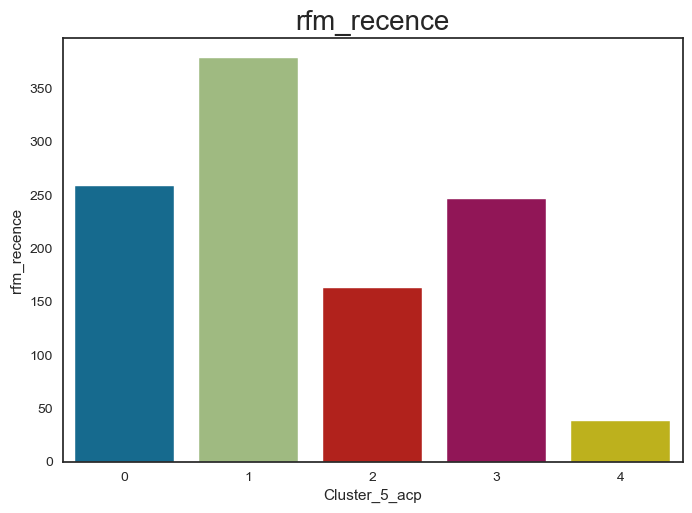

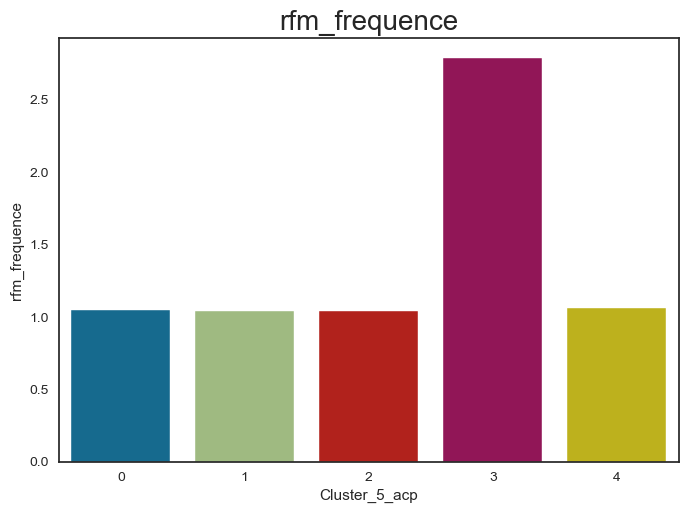

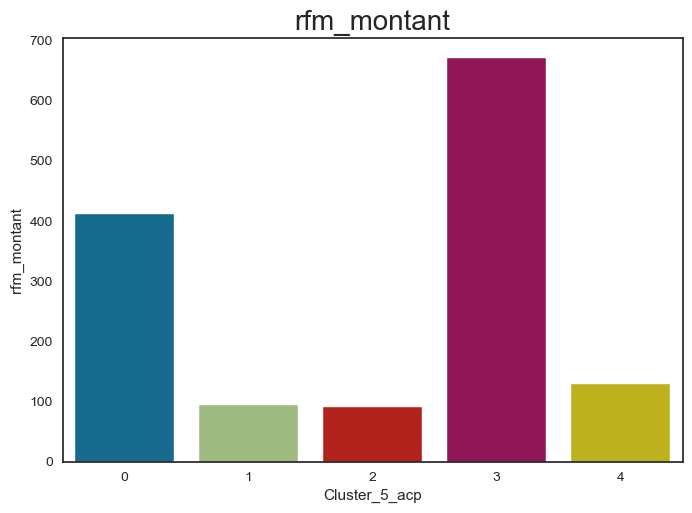

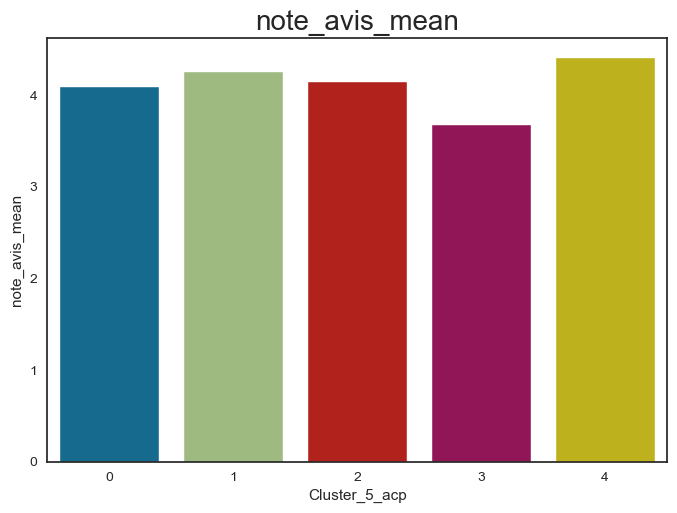

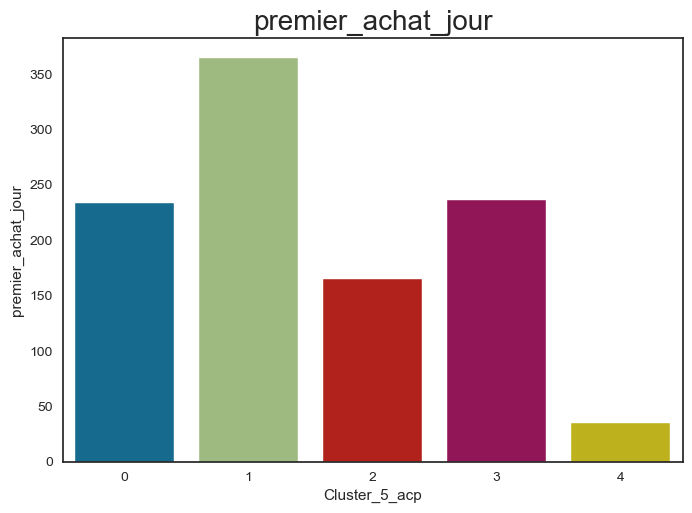

...

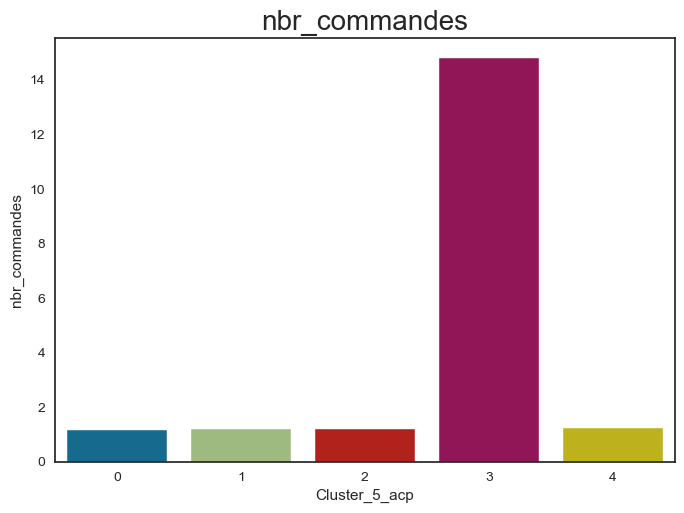

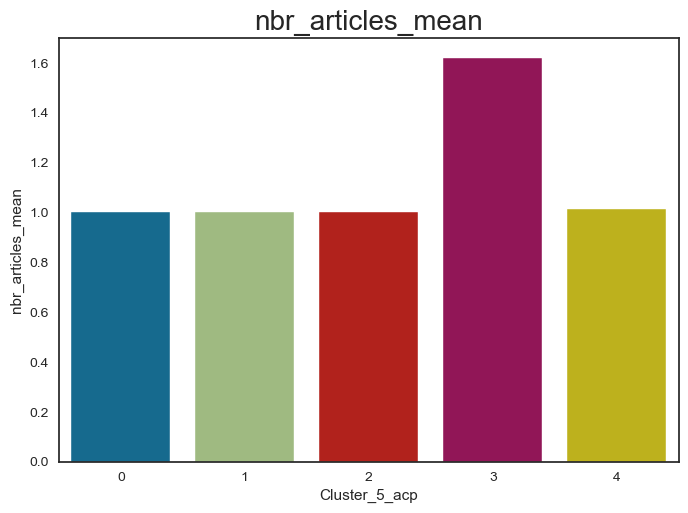

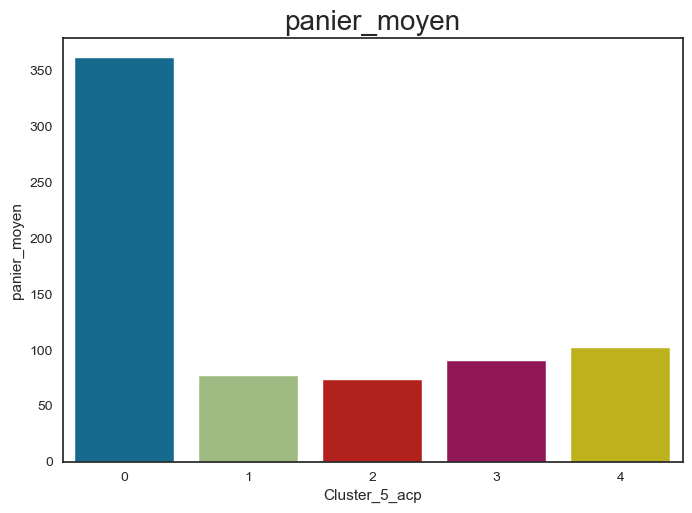

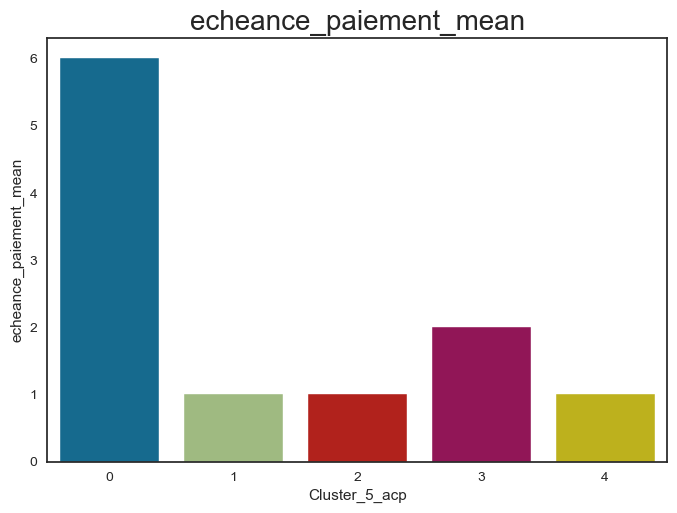

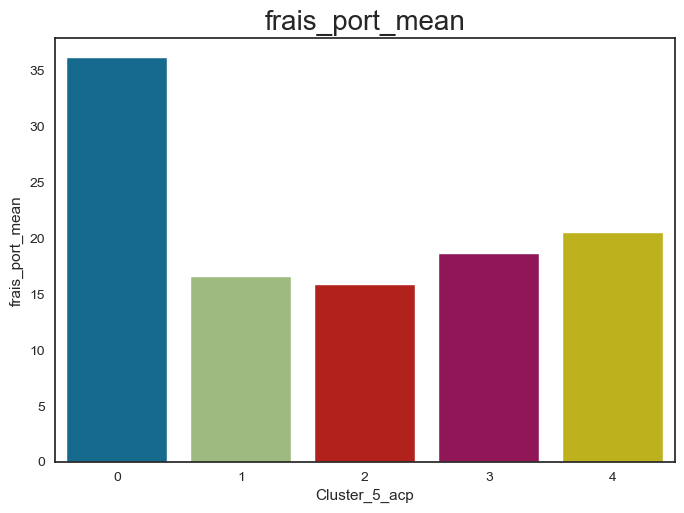

In [39]:
# Visualisation des moyennes des variables par clusters

res = summary_table_k5_acp.columns[1:].to_list()

sns.set_style('white')

for col in res:
    
    sns.barplot(x=summary_table_k5_acp["Cluster_5_acp"], y=summary_table_k5_acp[col])
    plt.title(col, fontsize=20)    
    plt.show()

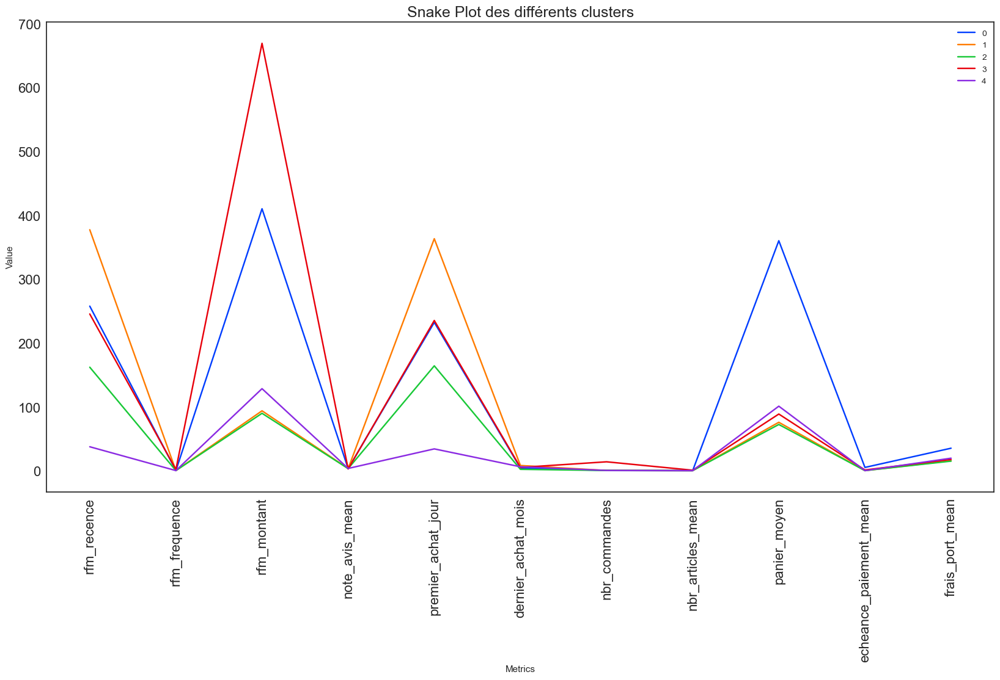

In [42]:
cols_a_interp = summary_table_k5_acp.columns.to_list()
cols_a_interp.remove('dernier_achat_annee')
data_melt = pd.melt(frame=summary_table_k5_acp[cols_a_interp],
                               id_vars=["Cluster_5_acp"],
                               var_name='Metrics', value_name='Value')

# Visualisation : Snake plot des différentes variables moyennes

plt.figure(figsize=(20, 10))

sns.set_style('white')

sns.lineplot(x='Metrics', y='Value', hue='Cluster_5_acp',
             data=data_melt, palette='bright')
plt.title('Snake Plot des différents clusters', fontsize='18')
plt.xticks(rotation=90, fontsize=16)
plt.yticks(fontsize=16)
plt.legend(loc='upper right')

plt.show()

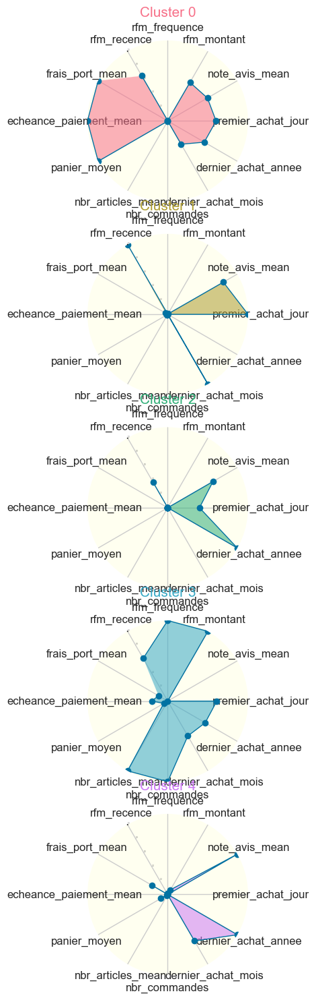

In [43]:
# Liste des couleurs pour chaque segment
palette = sns.color_palette("husl", summary_table_k5_acp.shape[0])
colors = {label: color for label, color in zip(summary_table_k5_acp['Cluster_5_acp'],
                                                 palette.as_hex())}

fonctions_segmentation.affiche_radarplot_par_clusters(summary_table_k5_acp, 'Cluster_5_acp', 5, 1, colors,  sub_plot=[3, 3],  figsize=(36, 18))

In [46]:
summary_table_k5_acp.head()

,Cluster_5_acp,rfm_recence,rfm_frequence,rfm_montant,note_avis_mean,premier_achat_jour,dernier_achat_annee,dernier_achat_mois,nbr_commandes,nbr_articles_mean,panier_moyen,echeance_paiement_mean,frais_port_mean
0,0,258.430487,1.045439,410.843787,4.085134,233.0,2017.521712,5.0,1.170361,1.001633,360.841220,6.0,36.066852
1,1,378.023845,1.041969,94.596344,4.252278,364.0,2016.993490,9.0,1.210052,1.000206,76.656456,1.0,16.469357
2,2,162.858847,1.038864,90.704097,4.143405,165.0,2018.000000,3.0,1.179225,1.000167,73.207589,1.0,15.830522
3,3,246.173158,2.785426,669.813273,3.667684,236.0,2017.535154,6.0,14.785031,1.617726,89.543175,2.0,18.526536
4,4,38.340603,1.058888,129.256726,4.399370,35.0,2018.000000,7.0,1.248201,1.011996,101.833793,1.0,20.453704


**Bilan** :
***
- **Cluster 0** : commandes assez récentes, fréquentes et d'un montant élevé, utilisation d'un grand nombre d'échelonnement de paiement ==> **meilleurs clients utilisant des facilités de paiement**.  
- **Cluster 1** : commandes anciennes, peu fréquentes et d'un montant moyen bas, dernier achat très anciens ==> **clients presque perdus**.
- **Cluster 3** : commandes assez récentes, peu fréquentes et d'un montant moyen ==> **Bons clients sur le point de dormir**.
- **Cluster 2** : commandes très récentes, peu fréquentes et d'un montant moyen bas ==> **nouveaux clients**.
- **Cluster 4** : commandes assez récentes, fréquentes et d'un montant élevé ==> **meilleurs clients fidèles**.

### <span style='background:aquamarine'>4.3 K-Prototype</span>

**Note** :
***
-  K-Prototypes est une méthode de clustering proche du K-Means et sa particularité est de travailler avec des types de données mixtes. 
- Il mesure la distance entre les caractéristiques numériques en utilisant la distance euclidienne (comme K-means) mais mesure également la distance entre les caractéristiques catégorielles en utilisant le nombre de catégories correspondantes. 
- Il a été publié pour la première fois par Huang (1998) et a été implémenté en python en utilisant ce package.
- K-Prototype est une méthode de clustering basée sur le partitionnement. 
- Son algorithme est une forme améliorée de l'algorithme de clustering K-Means et K-Mode pour gérer le clustering avec des types de données mixtes.

**Dénomination des variables catégorielles et numériques**

In [31]:
data.dtypes

customer_city                  object
rfm_recence                   float64
rfm_frequence                 float64
rfm_montant                   float64
note_avis_mean                float64
date_premier_achat             object
premier_achat_jour              int64
date_dernier_achat             object
dernier_achat_annee             int64
dernier_achat_mois              int64
dernier_achat_jour              int64
dernier_achat_heure             int64
dernier_achat_jour_prefere      int64
nbr_commandes                   int64
nbr_articles_mean             float64
panier_moyen                  float64
moyen_paiement_prefere         object
echeance_paiement_mean        float64
frais_port_mean               float64
cat_produit_prefere            object
dtype: object

In [32]:
data.select_dtypes(exclude='object').columns

Index(['rfm_recence', 'rfm_frequence', 'rfm_montant', 'note_avis_mean',
       'premier_achat_jour', 'dernier_achat_annee', 'dernier_achat_mois',
       'dernier_achat_jour', 'dernier_achat_heure',
       'dernier_achat_jour_prefere', 'nbr_commandes', 'nbr_articles_mean',
       'panier_moyen', 'echeance_paiement_mean', 'frais_port_mean'],
      dtype='object')

In [33]:
# Table de travail
data_kprt = data.copy()
# Suppression des variables date de première et dernière commande inutiles
data_kprt.drop(columns=['date_premier_achat', 'date_dernier_achat'],
                inplace=True)

# Pré-processing
scaler = StandardScaler()
for col in data_kprt.select_dtypes(exclude='object').columns:
    if col != 'geolocation_lat' :
        if col != 'geolocation_lng':
            data_kprt[col] = data_kprt[col].apply(np.log1p)
    data_kprt[col] = scaler.fit_transform(np.array(data_kprt[col])
                                          .reshape(-1, 1))

# Détermine les variables catégorielles par leurs index
cols_categorical = [0, 14, 17] 

# Instanciation du modèle de clustering
kprt = KPrototypes(n_clusters= 6, init='Cao', n_jobs = -1)
clus = kprt.fit_predict(data_kprt, categorical=cols_categorical)

In [34]:
# Assignation du cluster au dataframe
data_kprt = data.copy()
data_kprt['Cluster_Kprt_6'] = kprt.labels_

**Répartition des clients**

Clusters,Nb_clients,%
0,13341,14.590000
1,3523,3.850000
2,9833,10.750000
3,28163,30.790000
4,13651,14.930000
5,22947,25.090000


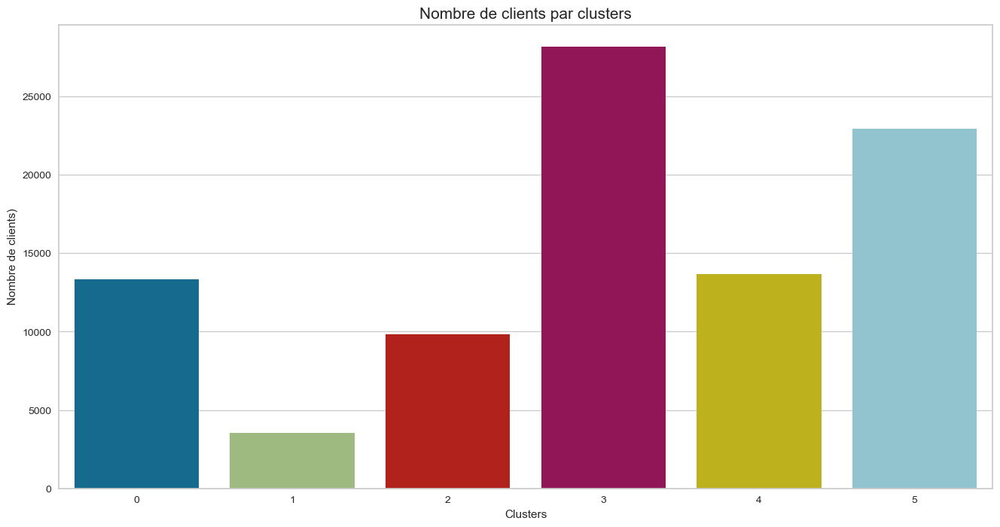

In [35]:
fonctions_segmentation.typage_clients_par_clusters(clus)

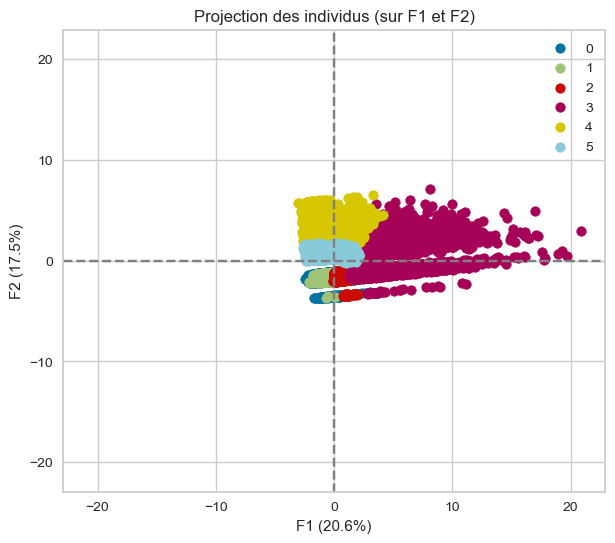

In [31]:
# Visualisation avec ACP
fonctions_data.display_factorial_planes(X_projected_log_acp, n_comp_log,
                                     pca_log, [(0, 1)], alpha=1,
                                     illustrative_var=clus)

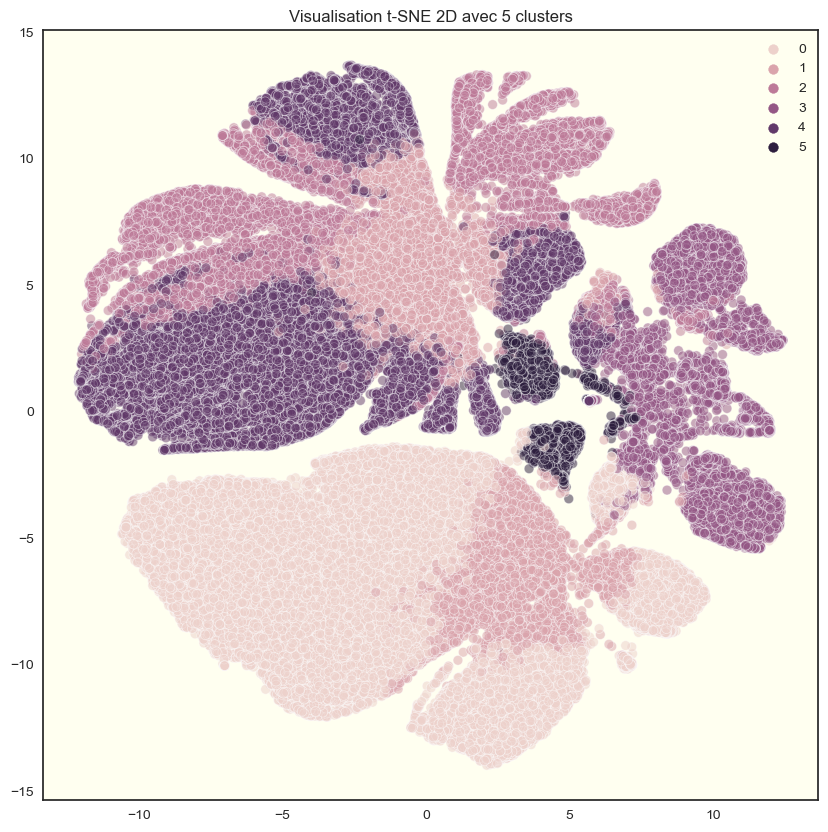

In [87]:
# Visualisation en 2D avec t-SNE

plt.figure(figsize=(10,10))
plot = sns.scatterplot(
                x=tsne_log[:,0], y=tsne_log[:,1],
                hue=clus,
                legend="full",
                alpha=0.5).set(title = 'Visualisation t-SNE 2D avec 5 clusters')
    

plt.show()

**Interprétation des 6 clusters**

In [36]:
summary_table_kprt6 = data_kprt.groupby('Cluster_Kprt_6').agg({'rfm_recence' : 'mean',
                                          'rfm_frequence' : 'mean',
                                          'rfm_montant' : 'mean',
                                          'note_avis_mean' : 'mean',
                                          'premier_achat_jour' : 'median',
                                          'dernier_achat_annee' : 'mean',
                                          'dernier_achat_mois' : 'median',
                                          'nbr_commandes' : 'mean',
                                          'nbr_articles_mean' : 'mean',
                                          'panier_moyen': 'mean',
                                          'echeance_paiement_mean' : 'median',
                                          'frais_port_mean' : 'mean'})

# Aggrégation des données par différentes fonctions
summary_table_kprt6.reset_index(inplace=True)
summary_table_kprt6.head()

,Cluster_Kprt_6,rfm_recence,rfm_frequence,rfm_montant,note_avis_mean,premier_achat_jour,dernier_achat_annee,dernier_achat_mois,nbr_commandes,nbr_articles_mean,panier_moyen,echeance_paiement_mean,frais_port_mean
0,0,38.376583,1.058841,128.759424,4.404268,35.0,2018.000000,7.0,1.248182,1.011918,101.412046,1.0,20.393365
1,1,247.304570,1.131990,155.063278,4.101192,239.0,2017.505819,6.0,1.551802,1.034346,112.411697,2.0,19.167957
2,2,246.113190,2.805654,680.199779,3.667800,236.0,2017.535747,6.0,15.063460,1.625430,89.437971,2.0,18.527775
3,3,378.697688,1.042325,95.668991,4.252707,365.0,2016.993218,9.0,1.212619,1.000195,77.643657,1.0,16.547509
4,4,254.659952,1.045711,417.375171,4.089945,227.0,2017.537323,5.0,1.172735,1.001685,366.762461,6.0,36.476375


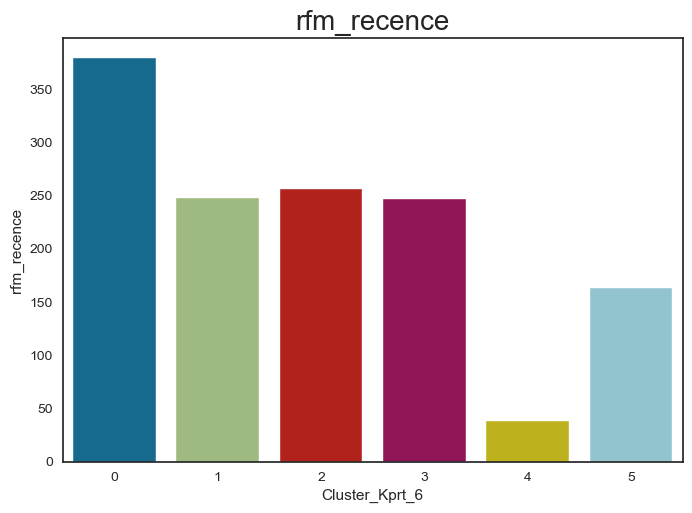

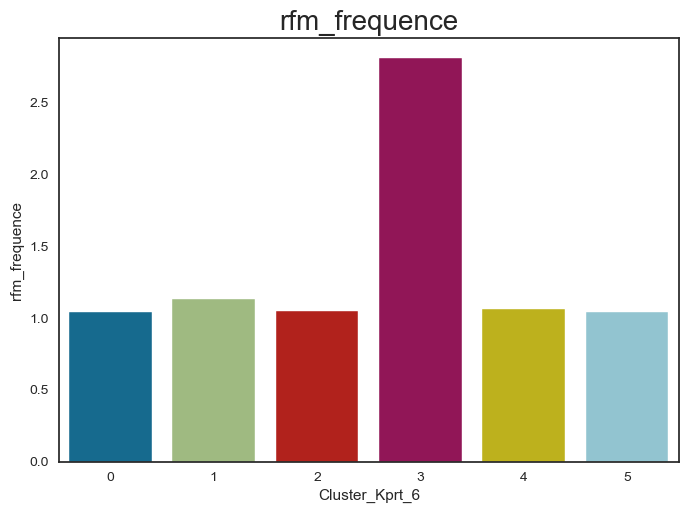

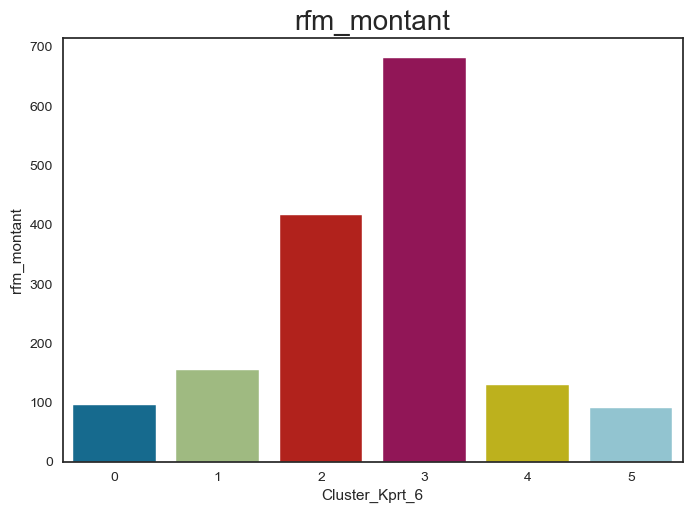

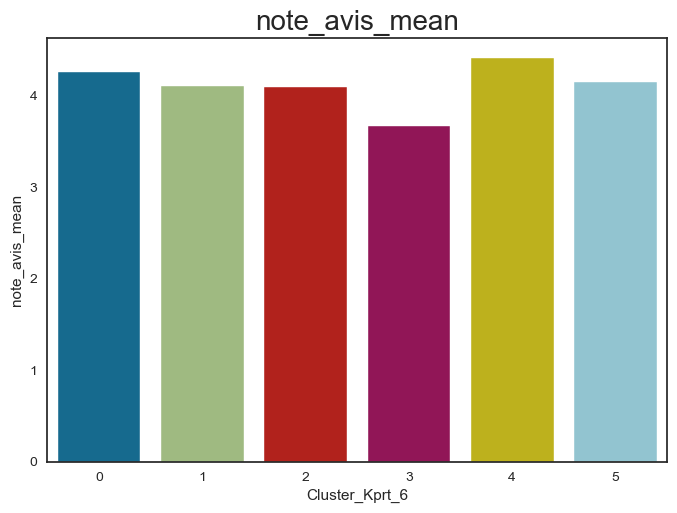

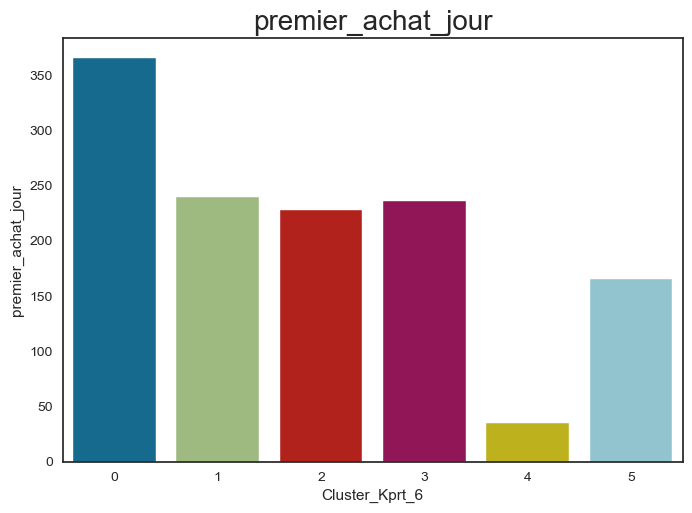

...

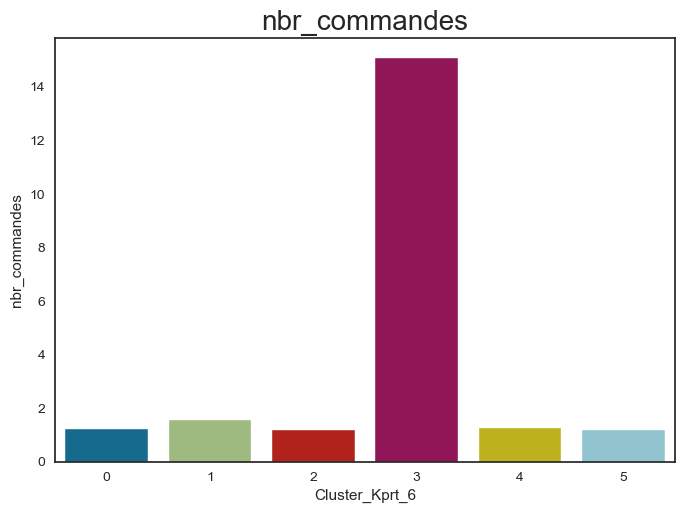

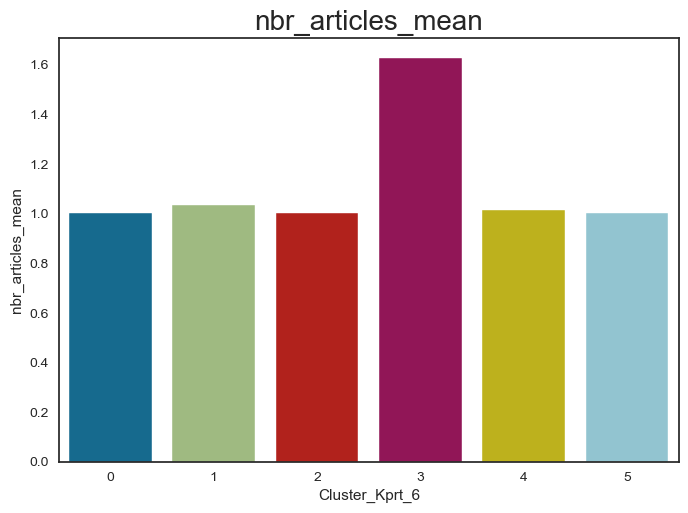

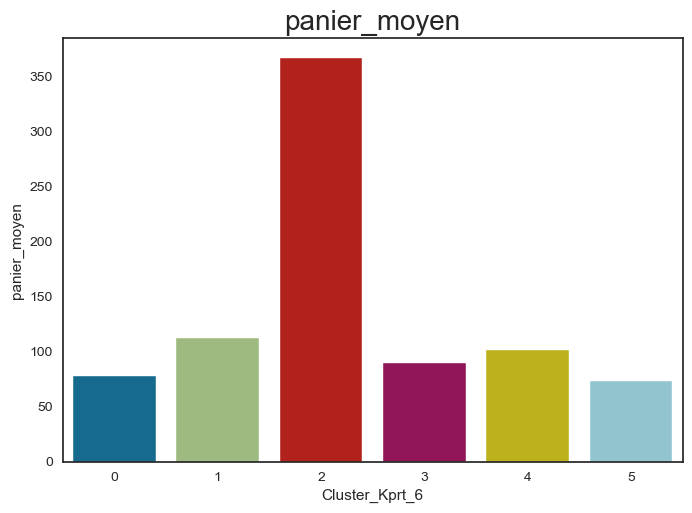

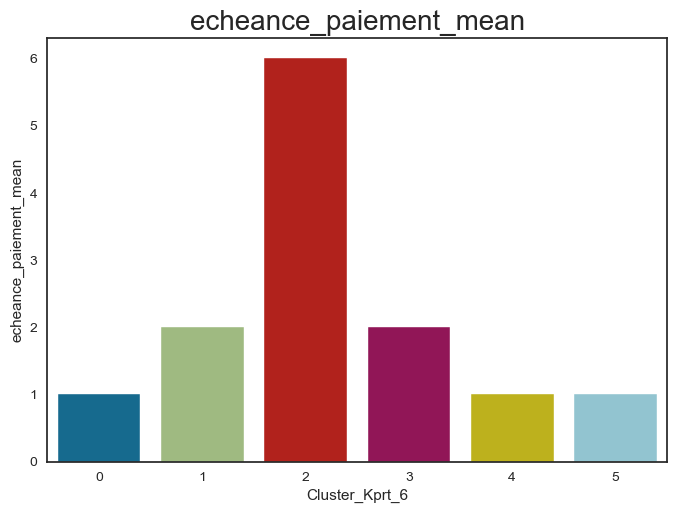

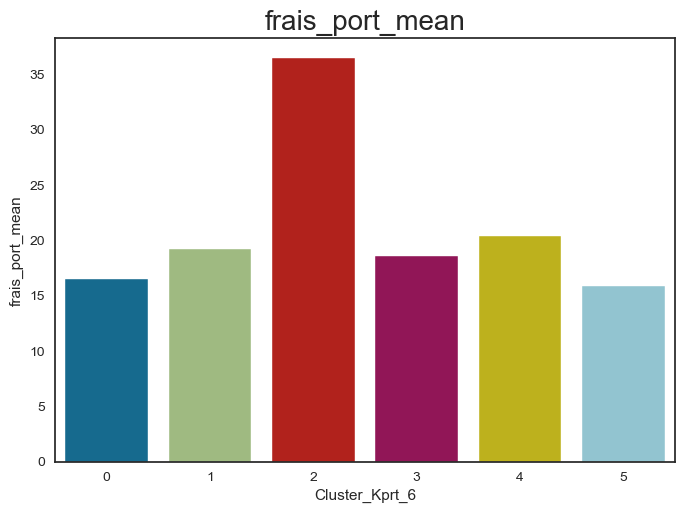

In [33]:
# Visualisation des moyennes des variables par clusters

res = summary_table_kprt6.columns[1:].to_list()

sns.set_style('white')

for col in res:
    
    sns.barplot(x=summary_table_kprt6["Cluster_Kprt_6"], y=summary_table_kprt6[col])
    plt.title(col, fontsize=20)    
    plt.show()

In [34]:
summary_table_kprt6.sort_values(by='rfm_recence', ascending=True)

,Cluster_Kprt_6,rfm_recence,rfm_frequence,rfm_montant,note_avis_mean,premier_achat_jour,dernier_achat_annee,dernier_achat_mois,nbr_commandes,nbr_articles_mean,panier_moyen,echeance_paiement_mean,frais_port_mean
4,4,38.392223,1.058740,128.902672,4.404236,35.0,2018.000000,7.0,1.247846,1.011875,101.557553,1.0,20.407396
5,5,162.883349,1.039450,90.560080,4.144387,165.0,2018.000000,3.0,1.182966,1.000196,73.035646,1.0,15.822997
3,3,246.084189,2.805491,680.200308,3.667868,236.0,2017.535841,6.0,15.061210,1.625405,89.444886,2.0,18.533617
1,1,247.165343,1.131877,154.964260,4.100255,239.0,2017.506239,6.0,1.551333,1.034317,112.340669,2.0,19.159947
2,2,255.570124,1.045508,416.557779,4.091880,228.0,2017.533528,5.0,1.172023,1.001644,366.095921,6.0,36.427773
0,0,378.692497,1.042429,95.426552,4.252545,365.0,2016.993237,9.0,1.213142,1.000196,77.416051,1.0,16.529047


**Constatation** :
***
- **Cluster 0** : commandes très anciennes, peu fréquentes et d'un montant moyen ==> **Clients perdus**.
- **Cluster 1** : commandes anciennes, assez fréquentes et d'un montant élevé, dernier achat très anciens ==> **Meilleurs clients utilisant les facilités de paiement ayant besoin d'attention**.
- **Cluster 2** : commandes très récentes, assez fréquentes et d'un montant moyen ==> **Clients fidèles (hors Nord)**.    
- **Cluster 3** : commandes assez anciennes, très fréquentes et d'un montant élevé ==> **Meilleurs clients ayant besoin d'attention**.
- **Cluster 4** : commandes assez récentes, peu fréquentes et d'un faible montant ==> **Nouveaux clients**.
- **Cluster 5** : commandes anciennes, assez fréquentes et d'un montant moyen, dernier achat très anciens ==> **Clients fidèles du Nord du Brésil achetant la catégorie 'fashion' ayant besoin d'attention**.

**Analyse des variables catégorielles (K-Means_5)**

**Distinction des groupes (Rappel)** :
***
- **Cluster 0** : commandes assez récentes, fréquentes et d'un montant élevé, utilisation d'un grand nombre d'échelonnement de paiement ==> **meilleurs clients utilisant des facilités de paiement.**  
- **Cluster 1** : commandes anciennes, peu fréquentes et d'un montant moyen bas, dernier achat très anciens ==> **clients presque perdus.**
- **Cluster 2** :  commandes assez récentes, fréquentes et d'un montant élevé ==> **meilleurs clients fidèles.**
- **Cluster 3** :  commandes assez récentes, peu fréquentes et d'un montant moyen ==> **Bons clients sur le point de dormir.**
- **Cluster 4** :  commandes très récentes, peu fréquentes et d'un montant moyen bas ==> **nouveaux clients.**

In [75]:
df_cat_pref = data_kmeans[['Cluster_5', 'cat_produit_prefere']]

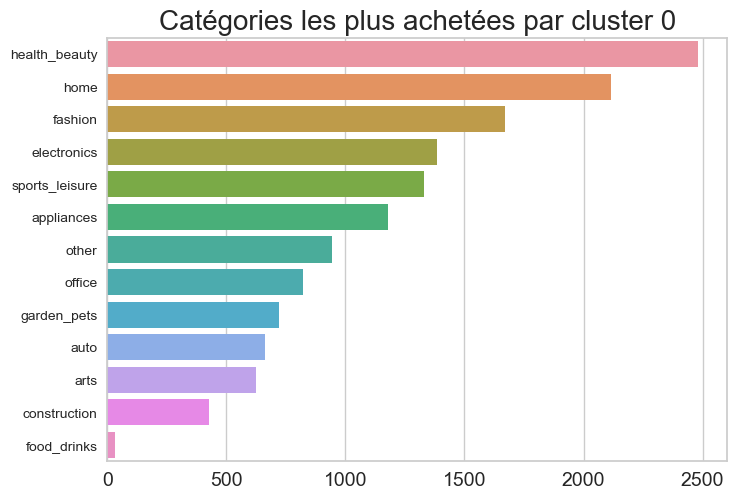

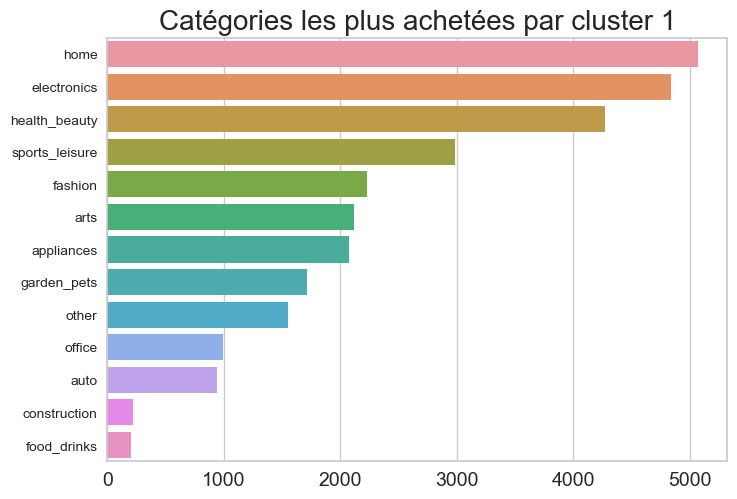

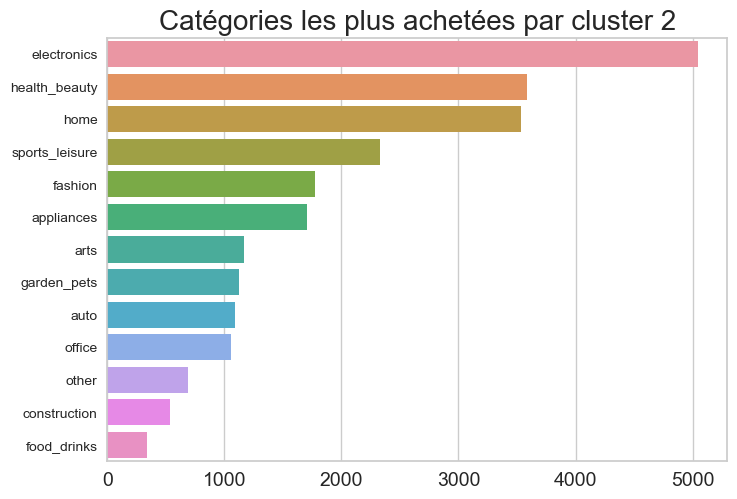

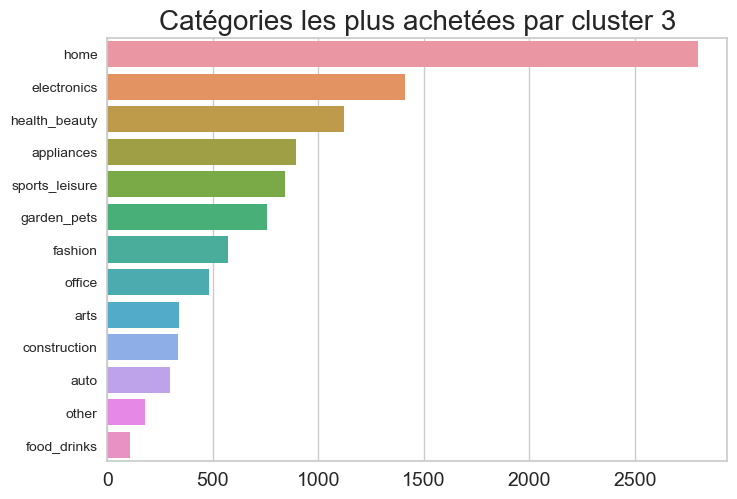

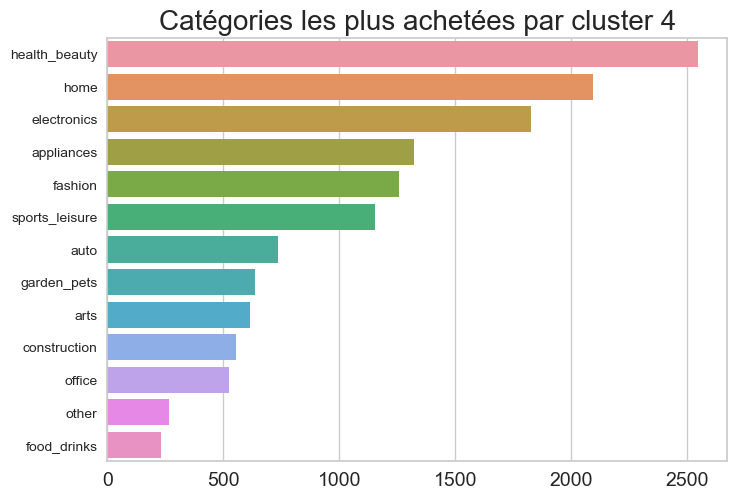

In [107]:
# Catégories de produits les plus achetées par cluster
for i in range(0, 5):
    df = df_cat_pref[df_cat_pref['Cluster_5'] == i] \
        .groupby('cat_produit_prefere') \
        .count().sort_values(by='Cluster_5', ascending=False)
    df = df.reset_index()
    g = sns.barplot(data=df,
                    x=df['Cluster_5'].values,
                    y=df['cat_produit_prefere'].unique())
    plt.xticks(fontsize=14)
    plt.title('Catégories les plus achetées par cluster {}'.format(i),
              fontsize=20)
    plt.show()

- Les meilleurs clients ont plus tendance à acheter plus fortement la catégorie 'home', 'electronics', et 'health_beauty' et très peu 'food'.
- Les meilleurs clients fidèles et nouveaux se laissent tenter par la catégorie 'food'.
- Les clients presque perdus fortement des catégories 'home', suivi de 'electronics' et peu de catégorie 'food'. Ceux -ci ciblent des produits de qualité durable, avec une faible fréquence d'achat.

**Moyen de paiement préféré par clusters**

In [111]:
df_paiement = data_kmeans[['Cluster_5', 'moyen_paiement_prefere']]

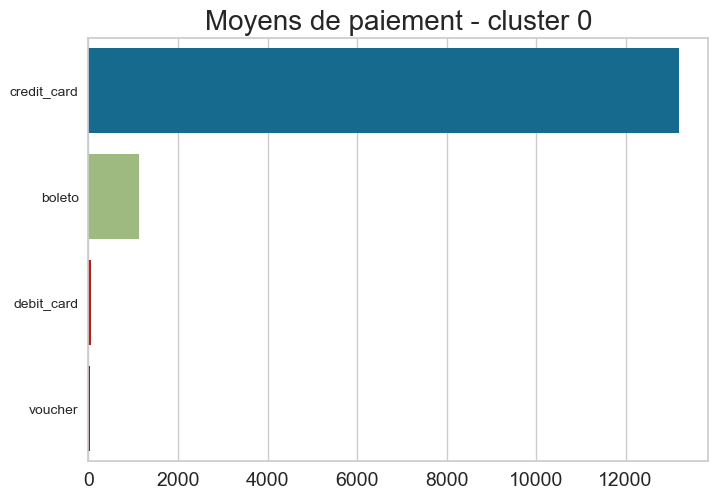

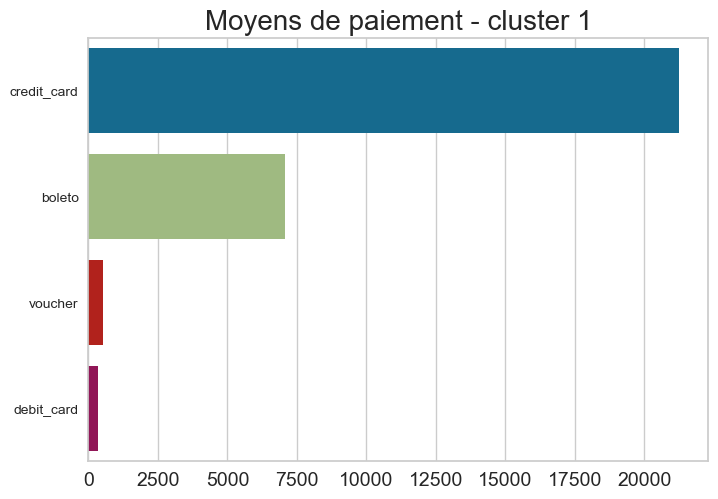

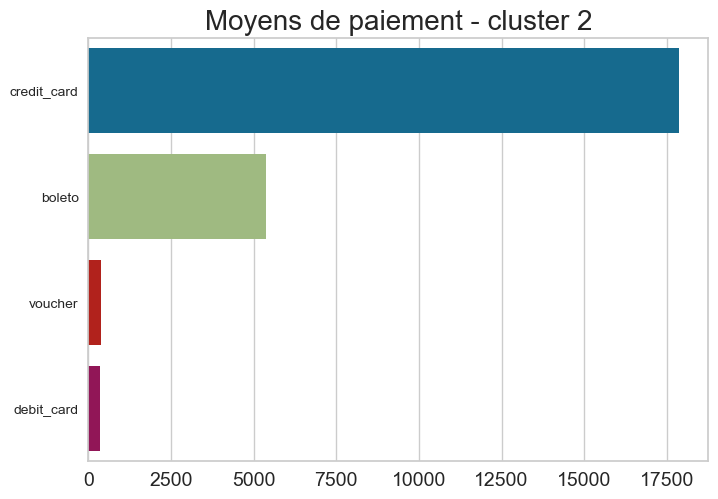

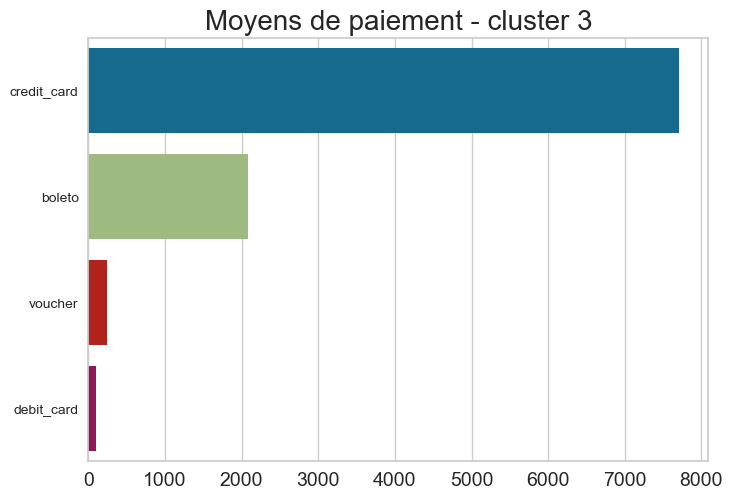

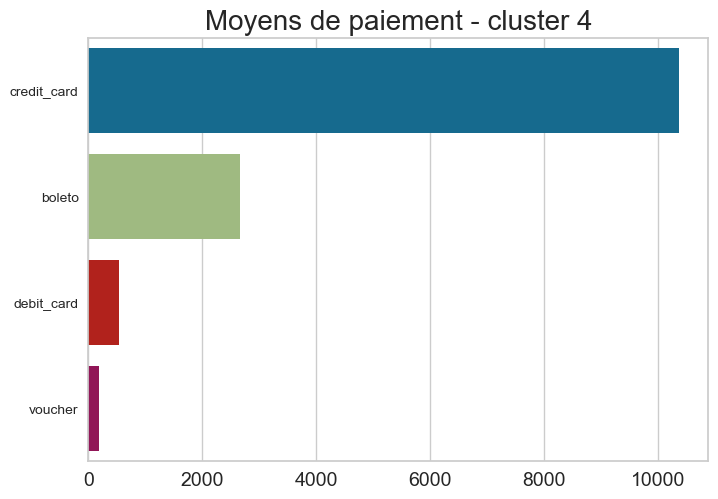

In [113]:
# Catégories de produits les plus achetées par cluster
for i in range(0, 5):
    df = df_paiement[df_paiement['Cluster_5'] == i] \
        .groupby('moyen_paiement_prefere') \
        .count().sort_values(by='Cluster_5', ascending=False)
    df = df.reset_index()
    g = sns.barplot(data=df,
                    x=df['Cluster_5'].values,
                    y=df['moyen_paiement_prefere'].unique())
    plt.xticks(fontsize=14)
    plt.title('Moyens de paiement - cluster {}'.format(i),
              fontsize=20)
    plt.show()

- Les clients nouveaux et meilleurs clients avec échéances utilisent plus la carte de crédit et la majorité des autres clients paient en carte de crédit et en argent.

**Bilan** :
***
- K-Means permet de segmenter les clients en 5 groupes distinctifs et informatifs. La majorité des clients paient en carte de crédit et la répartition de la catégorie des produits est différentes selon les groupes de clients.

**Analyse des variables catégorielles (K-Prototype)**

**Constatation** :
***
- **Cluster 0** : commandes très anciennes, peu fréquentes et d'un montant moyen ==> **Clients perdus**.
- **Cluster 1** : commandes anciennes, assez fréquentes et d'un montant élevé, dernier achat très anciens ==> **Meilleurs clients utilisant les facilités de paiement ayant besoin d'attention**.
- **Cluster 2** : commandes très récentes, assez fréquentes et d'un montant moyen ==> **Clients fidèles (hors Nord)**.    
- **Cluster 3** : commandes assez anciennes, très fréquentes et d'un montant élevé ==> **Meilleurs clients ayant besoin d'attention**.
- **Cluster 4** : commandes assez récentes, peu fréquentes et d'un faible montant ==> **Nouveaux clients**.
- **Cluster 5** : commandes anciennes, assez fréquentes et d'un montant moyen, dernier achat très anciens ==> **Clients fidèles du Nord du Brésil achetant la catégorie 'fashion' ayant besoin d'attention**.

In [116]:
df_cat_pref_kprt = data_kprt[['Cluster_Kprt_6',
                                  'cat_produit_prefere']]

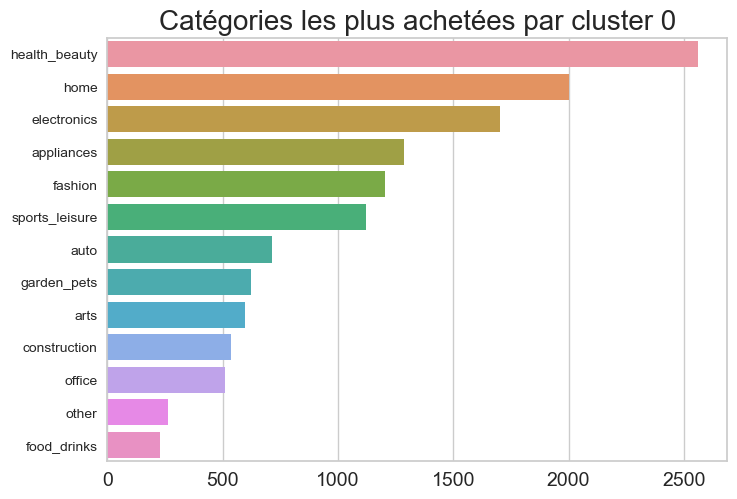

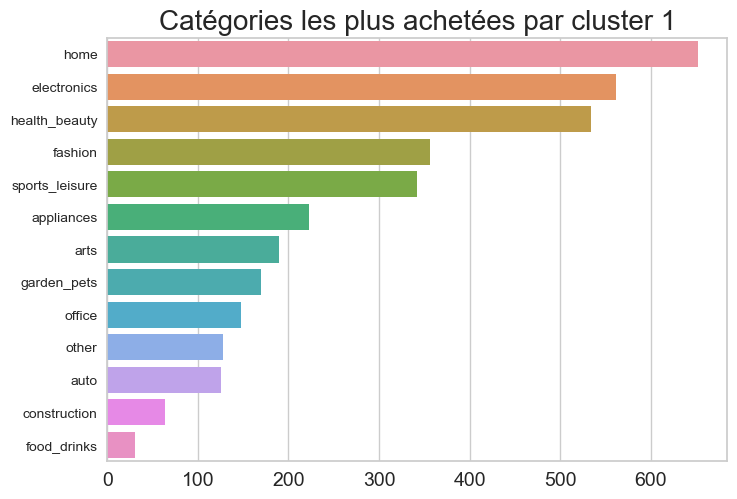

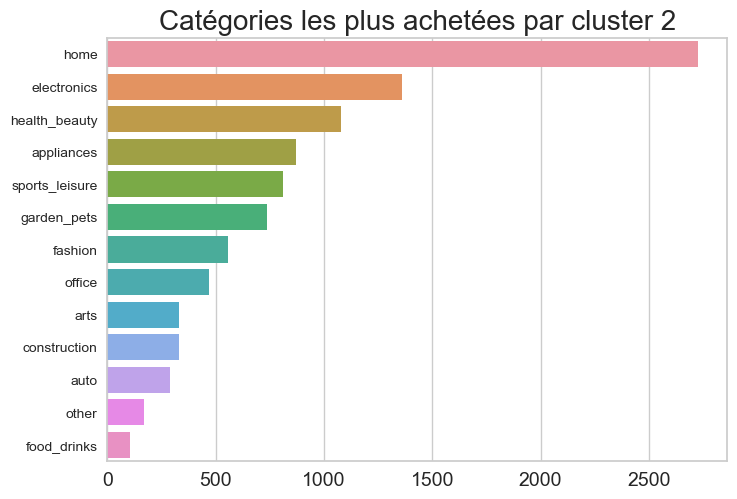

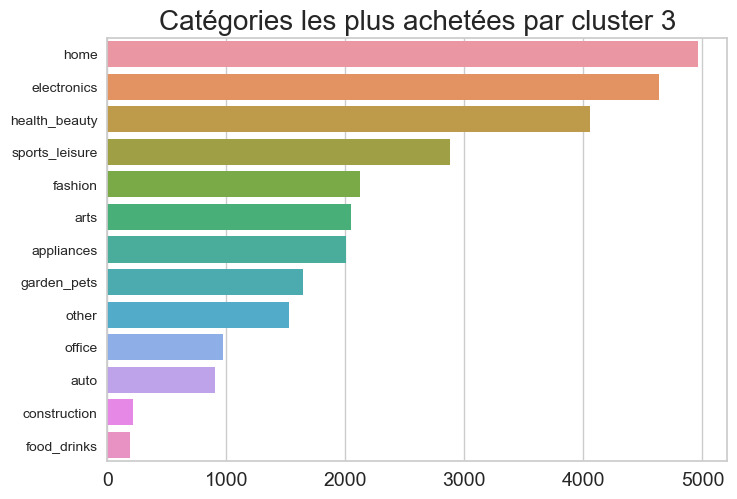

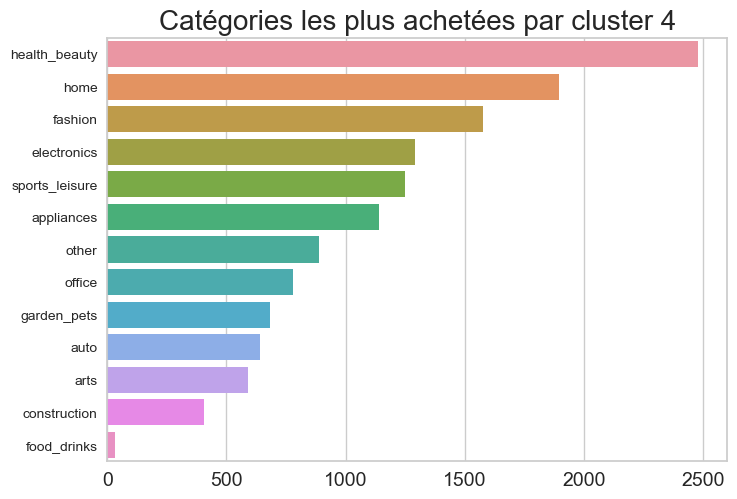

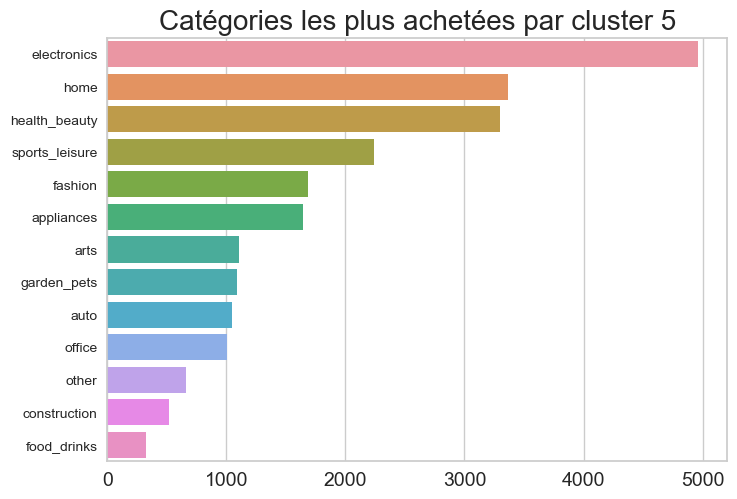

In [120]:
# Catégories de produits les plus achetées par cluster
for i in range(0, 6):
    df = df_cat_pref_kprt[df_cat_pref_kprt['Cluster_Kprt_6'] == i] \
        .groupby('cat_produit_prefere') \
        .count().sort_values(by='Cluster_Kprt_6', ascending=False)
    df = df.reset_index()
    g = sns.barplot(data=df,
                    x=df['Cluster_Kprt_6'].values,
                    y=df['cat_produit_prefere'].unique())
    plt.xticks(fontsize=14)
    plt.title('Catégories les plus achetées par cluster {}'.format(i),
              fontsize=20)
    plt.show()

- Les meilleurs clients ont plus tendance à acheter plus fortement la catégorie 'home', 'electronics', et 'health_beauty' et très peu 'food'.
- Les clients fidèles et nouveaux se laissent tenter par la catégorie 'food'.
- Les clients fidèles du Nord commandent autant de catégories 'home' que 'health_beauty' et beaucoup de 'high-tech'.

**Moyen de paiement préféré par clusters**

In [122]:
df_paiement_kprt = data_kprt[['Cluster_Kprt_6', 'moyen_paiement_prefere']]

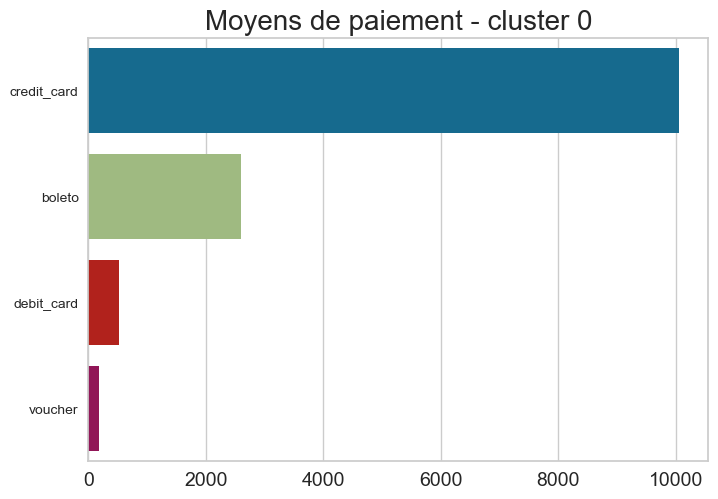

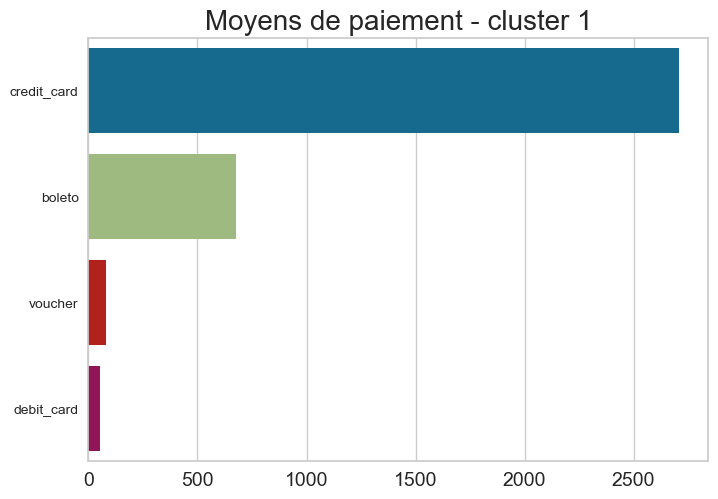

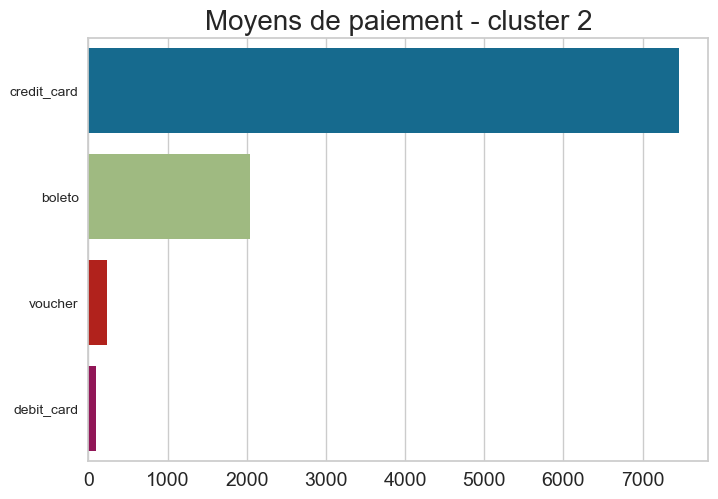

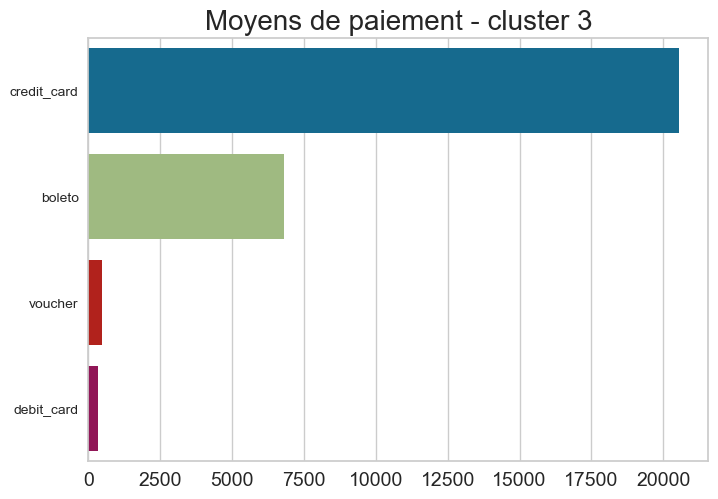

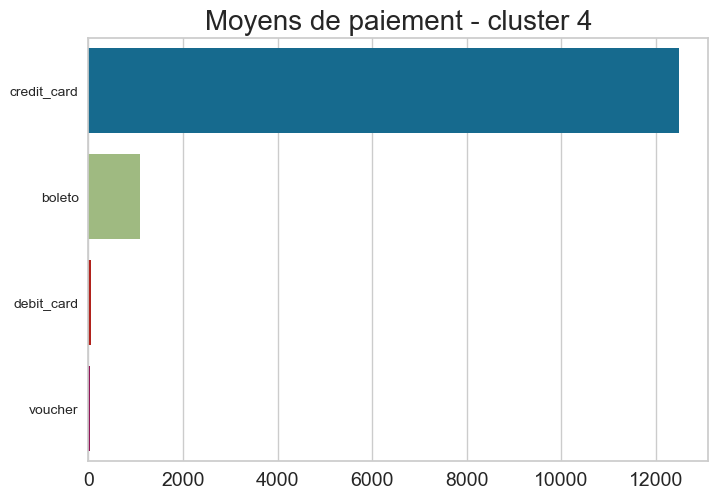

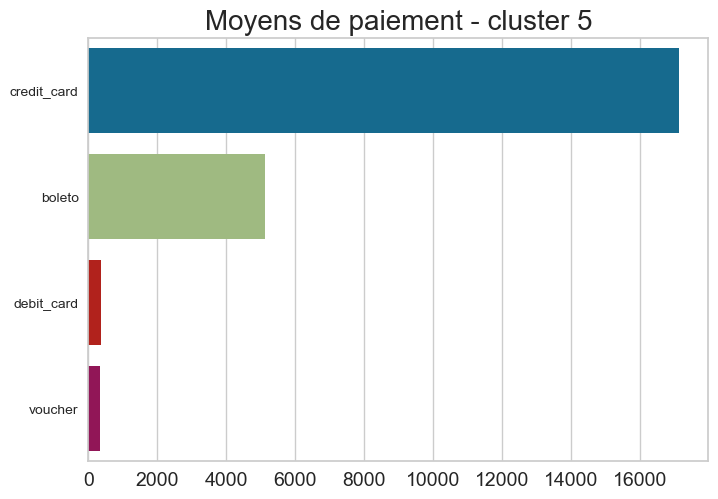

In [123]:
# Catégories de produits les plus achetées par cluster
for i in range(0, 6):
    df = data_kprt[data_kprt['Cluster_Kprt_6'] == i] \
        .groupby('moyen_paiement_prefere') \
        .count().sort_values(by='Cluster_Kprt_6', ascending=False)
    df = df.reset_index()
    g = sns.barplot(data=df,
                    x=df['Cluster_Kprt_6'].values,
                    y=df['moyen_paiement_prefere'].unique())
    plt.xticks(fontsize=14)
    plt.title('Moyens de paiement - cluster {}'.format(i),
              fontsize=20)
    plt.show()

- Les meilleurs clients avec échéances utilisent plus la carte de crédit et la majorité des autres clients paient en carte de crédit et en argent.

**Bilan** :
***
- K-Prototype permet de segmenter les clients en 6 groupes distinctifs et informatifs. La majorité des clients paient en carte de crédit et la répartition de la catégorie des produits pour chaque cluster est légèrement différentes selon les groupes de patient.

## <span style='background:lightblue'>5. Comparaison des performances des algorithmes</span>

In [37]:
# Réduction du jeu de données à 15000 clients
# Préparation des jeux de données réduits à partir de X_scaled_log
data_comp = X_scaled_log.sample(15000, random_state=seed).copy()
X_comp = data_comp.values

# Préparation des jeux de données réduits à partir de X_scaled_cat
data_comp_cat = X_scaled_cat.sample(15000, random_state=seed).copy()
X_comp_cat = data_comp_cat.values

# Préparation des jeux de données réduits à partir de X_projected_log_acp
df = pd.DataFrame(X_projected_log_acp)
data_comp_acp = df.sample(15000, random_state=seed).copy()
X_comp_acp = data_comp_acp.values

# Préparation des jeux de données réduits à partir de data_kprot
data_comp_kproto = data_kprt.sample(15000, random_state=seed).copy()
data_comp_kproto.drop(columns=['date_premier_achat', 'date_dernier_achat'],
                inplace=True)
X_comp_kproto = data_comp_kproto.values
X_comp_kproto_num = data_comp_kproto.drop(['moyen_paiement_prefere',
                                           'cat_produit_prefere','customer_city'],
                                          axis=1)

In [38]:
data_comp_kproto.columns

Index(['customer_city', 'rfm_recence', 'rfm_frequence', 'rfm_montant',
       'note_avis_mean', 'premier_achat_jour', 'dernier_achat_annee',
       'dernier_achat_mois', 'dernier_achat_jour', 'dernier_achat_heure',
       'dernier_achat_jour_prefere', 'nbr_commandes', 'nbr_articles_mean',
       'panier_moyen', 'moyen_paiement_prefere', 'echeance_paiement_mean',
       'frais_port_mean', 'cat_produit_prefere', 'Cluster_Kprt_6'],
      dtype='object')

In [39]:
data_comp_kproto.dtypes

customer_city                  object
rfm_recence                   float64
rfm_frequence                 float64
rfm_montant                   float64
note_avis_mean                float64
premier_achat_jour              int64
dernier_achat_annee             int64
dernier_achat_mois              int64
dernier_achat_jour              int64
dernier_achat_heure             int64
dernier_achat_jour_prefere      int64
nbr_commandes                   int64
nbr_articles_mean             float64
panier_moyen                  float64
moyen_paiement_prefere         object
echeance_paiement_mean        float64
frais_port_mean               float64
cat_produit_prefere            object
Cluster_Kprt_6                 uint16
dtype: object

In [35]:
data['customer_city'].dtypes

dtype('O')

In [68]:
data_kprt.select_dtypes('object')

,customer_city,date_premier_achat,date_dernier_achat,moyen_paiement_prefere,cat_produit_prefere
customer_unique_id,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,cajamar,2018-05-10 10:56:27,2018-05-10 10:56:27,credit_card,home
0000b849f77a49e4a4ce2b2a4ca5be3f,osasco,2018-05-07 11:11:27,2018-05-07 11:11:27,credit_card,health_beauty
0000f46a3911fa3c0805444483337064,sao jose,2017-03-10 21:05:03,2017-03-10 21:05:03,credit_card,office
0000f6ccb0745a6a4b88665a16c9f078,belem,2017-10-12 20:29:41,2017-10-12 20:29:41,credit_card,electronics
0004aac84e0df4da2b147fca70cf8255,sorocaba,2017-11-14 19:45:42,2017-11-14 19:45:42,credit_card,electronics
...,...,...,...,...,...
fffcf5a5ff07b0908bd4e2dbc735a684,sanharo,2017-06-08 21:00:36,2017-06-08 21:00:36,credit_card,health_beauty
fffea47cd6d3cc0a88bd621562a9d061,feira de santana,2017-12-10 20:07:56,2017-12-10 20:07:56,credit_card,health_beauty
ffff371b4d645b6ecea244b27531430a,sinop,2017-02-07 15:49:16,2017-02-07 15:49:16,credit_card,auto


In [53]:
data_comp_kproto.select_dtypes('object')

,customer_city,moyen_paiement_prefere,cat_produit_prefere
customer_unique_id,,,
db63e879524ddfd185cbadd019c367ca,rio de janeiro,credit_card,electronics
9a2f8f0dc52f88ea53161973498b6987,goiania,boleto,health_beauty
51855c3f2ea880a51f27afc4b49f660a,capivari,boleto,home
398d0e6af5ad81e3cf33223483f0b967,sao francisco de paula,credit_card,garden_pets
f22558a5d21473973ec3b6ab6f050bd2,bauru,credit_card,electronics
...,...,...,...
89525cbc59ab4a7622ca666aee16560f,niteroi,credit_card,fashion
d73e81a912155e04272bdd81f25a66b3,campinas,boleto,home
21a0245a37a2ab9d020db08b1ec03616,santo andre,credit_card,health_beauty


In [40]:
# Dataframe de comparaisons des performances des algorithmes
df_resultats_comp = pd.DataFrame()

### <span style='background:aquamarine'>5.1 K-Means</span>

In [44]:
# Variables quantitatives transformées en log
# -----------------------------------------------------------------------
# Instanciation du modèle KMeans pour 3 clusters et  meilleurs paramètres
# Top début d'exécution
time_start = time.time()
kmeans_3 = KMeans(n_clusters=3,
                  init='k-means++').fit_predict(X_comp)
# Top fin d'exécution
time_end = time.time()
# Durée d'exécution
time_execution = time_end - time_start
df_resultats_comp = \
    fonctions_segmentation.calcul_comp_clustering('K-Means-3',
                                               X_comp,
                                               kmeans_3,
                                               df_resultats_comp,
                                               time_execution)
df_resultats_comp.style.hide_index()

Algos,Nb_clusters,coef_silh,indice_gini,davies_bouldin,Durée
K-Means-3,3,0.183374,0.500832,1.795064,1.122206


In [45]:
# Variables quantitatives transformées en log
# -----------------------------------------------------------------------
# Instanciation du modèle KMeans pour 4 clusters + meilleurs paramètres
# Top début d'exécution
time_start = time.time()
kmeans_4 = KMeans(n_clusters=4,
                  init='k-means++',
                  random_state=seed).fit_predict(X_comp)
# Top fin d'exécution
time_end = time.time()
# Durée d'exécution
time_execution = time_end - time_start
df_resultats_comp = \
    fonctions_segmentation.calcul_comp_clustering('K-Means-4',
                                                       X_comp,
                                                       kmeans_4,
                                                       df_resultats_comp,
                                                       time_execution)
df_resultats_comp.style.hide_index()

Algos,Nb_clusters,coef_silh,indice_gini,davies_bouldin,Durée
K-Means-3,3,0.183374,0.500832,1.795064,1.122206
K-Means-4,4,0.164147,0.502767,1.906098,1.416472


In [46]:
# Variables quantitatives transformées en log
# -----------------------------------------------------------------------
# Instanciation du modèle KMeans pour 5 clusters  + meilleurs paramètres
# Top début d'exécution
time_start = time.time()
kmeans_5 = KMeans(n_clusters=5,
                  init='k-means++').fit_predict(X_comp)
# Top fin d'exécution
time_end = time.time()
# Durée d'exécution
time_execution = time_end - time_start
df_resultats_comp = \
    fonctions_segmentation.calcul_comp_clustering('K-Means-5',
                                               X_comp,
                                               kmeans_5,
                                               df_resultats_comp,
                                               time_execution)
df_resultats_comp.style.hide_index()

Algos,Nb_clusters,coef_silh,indice_gini,davies_bouldin,Durée
K-Means-3,3,0.183374,0.500832,1.795064,1.122206
K-Means-4,4,0.164147,0.502767,1.906098,1.416472
K-Means-5,5,0.157083,0.500314,1.754551,1.534997


In [47]:
# Variables quantitatives transformées en log + quantitatives
# -----------------------------------------------------------------------
# Instanciation du modèle KMeans pour 6 clusters et  meilleurs paramètres
# Top début d'exécution
time_start = time.time()
kmeans_6 = KMeans(n_clusters=6,
                  n_init=20,
                  init='k-means++').fit_predict(X_comp_cat)
# Top fin d'exécution
time_end = time.time()
# Durée d'exécution
time_execution = time_end - time_start
df_resultats_comp = \
    fonctions_segmentation.calcul_comp_clustering('K-Means-6',
                                               X_comp_cat,
                                               kmeans_6,
                                               df_resultats_comp,
                                               time_execution)
df_resultats_comp.style.hide_index()

Algos,Nb_clusters,coef_silh,indice_gini,davies_bouldin,Durée
K-Means-3,3,0.183374,0.500832,1.795064,1.122206
K-Means-4,4,0.164147,0.502767,1.906098,1.416472
K-Means-5,5,0.157083,0.500314,1.754551,1.534997
K-Means-6,6,0.142179,0.500684,1.763558,3.244884


In [48]:
# ACP + Variables quantitatives transformées en log
# -----------------------------------------------------------------------
# Instanciation du modèle KMeans pour 5 clusters
# Top début d'exécution
time_start = time.time()
kmeans_acp_5 = KMeans(n_clusters=5,
                      init='k-means++').fit_predict(X_comp_acp)
# Top fin d'exécution
time_end = time.time()
# Durée d'exécution
time_execution = time_end - time_start
df_resultats_comp = \
    fonctions_segmentation.calcul_comp_clustering('K-Means-5-acp',
                                               X_comp_acp,
                                               kmeans_acp_5,
                                               df_resultats_comp,
                                               time_execution)
df_resultats_comp.style.hide_index()

Algos,Nb_clusters,coef_silh,indice_gini,davies_bouldin,Durée
K-Means-3,3,0.183374,0.500832,1.795064,1.122206
K-Means-4,4,0.164147,0.502767,1.906098,1.416472
K-Means-5,5,0.157083,0.500314,1.754551,1.534997
K-Means-6,6,0.142179,0.500684,1.763558,3.244884
K-Means-5-acp,5,0.172035,0.501220,1.666351,1.339390


### <span style='background:aquamarine'>5.2 K-Prototype</span>

In [49]:
# Instanciation du modèle de clustering
# Top début d'exécution
cols_categorical = [0, 14, 17]
time_start = time.time()
kproto = KPrototypes(n_clusters=6,
                     init='Cao',
                     n_jobs=-1).fit_predict(X_comp_kproto,
                                            categorical=cols_categorical)
# Top fin d'exécution
time_end = time.time()
# Durée d'exécution
time_execution = time_end - time_start
df_resultats_comp = \
    fonctions_segmentation.calcul_comp_clustering('K-Proto-6',
                                               X_comp_kproto_num,
                                               kproto,
                                               df_resultats_comp,
                                               time_execution)
df_resultats_comp.style.hide_index()

Algos,Nb_clusters,coef_silh,indice_gini,davies_bouldin,Durée
K-Means-3,3,0.183374,0.500832,1.795064,1.122206
K-Means-4,4,0.164147,0.502767,1.906098,1.416472
K-Means-5,5,0.157083,0.500314,1.754551,1.534997
K-Means-6,6,0.142179,0.500684,1.763558,3.244884
K-Means-5-acp,5,0.172035,0.501220,1.666351,1.339390
K-Proto-6,6,0.440022,0.498638,0.856477,239.296571


### <span style='background:aquamarine'>5.3 Visualisation des performances</span>

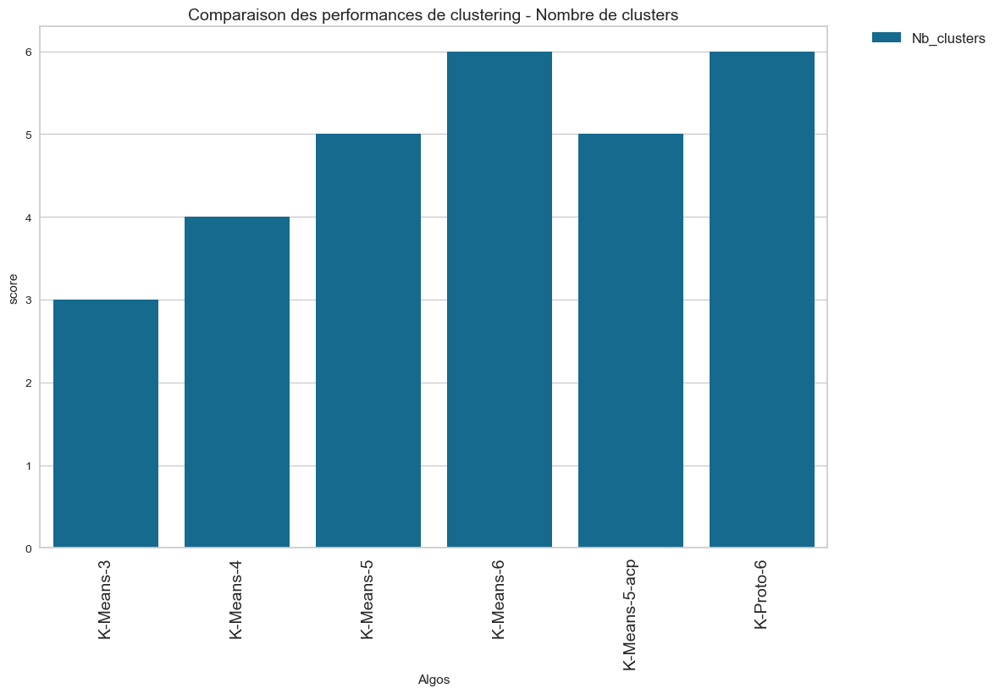

In [50]:
# Visualisation des nombres de clusters
# --------------------------------------------------------------------
# Comparaison visuelle des 7 algorithmes
comparaison_perf_melt = pd.melt(df_resultats_comp, id_vars=['Algos'],
                                value_name='score',
                                value_vars=['Nb_clusters'])
# Visualisation
plt.figure(figsize=(12, 8))
sns.barplot(x=comparaison_perf_melt['Algos'],
            y=comparaison_perf_melt['score'],
            hue=comparaison_perf_melt['variable'])
plt.title('Comparaison des performances de clustering - Nombre de clusters',
          fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=12)
plt.xticks(rotation=90, fontsize=14)
plt.show()

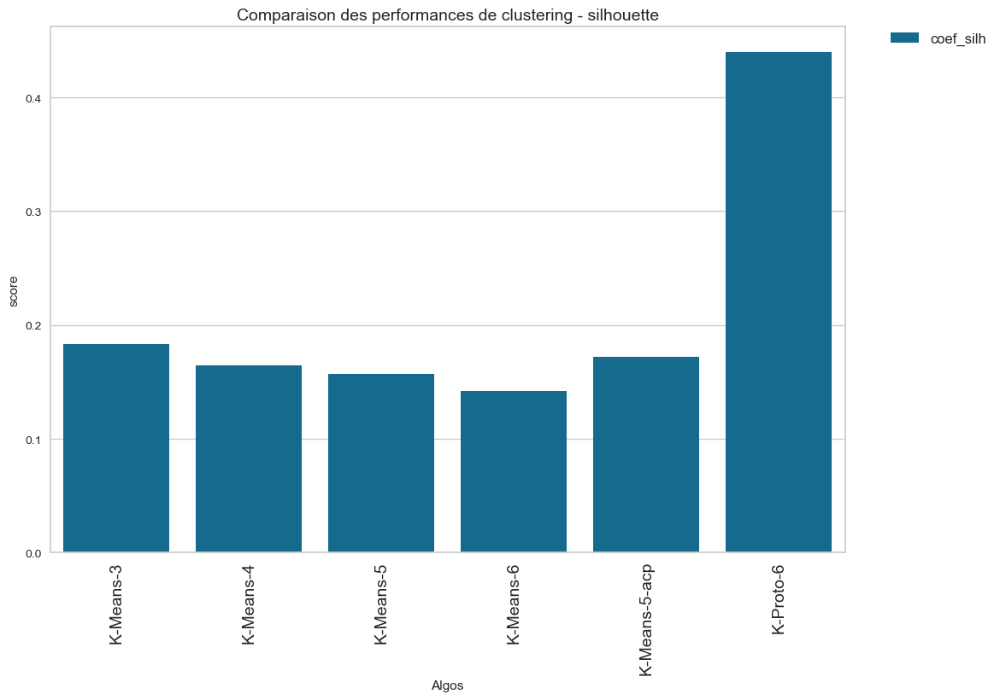

In [51]:
# Visualisation du score de silhouette
# ---------------------------------------------------------------------
# Comparaison visuelle des algorithmes
comparaison_perf_melt = pd.melt(df_resultats_comp, id_vars=['Algos'],
                                value_name='score',
                                value_vars=['coef_silh'])
# Visualisation
plt.figure(figsize=(12, 8))
sns.barplot(x=comparaison_perf_melt['Algos'],
            y=comparaison_perf_melt['score'],
            hue=comparaison_perf_melt['variable'])
plt.title('Comparaison des performances de clustering - silhouette',
          fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=12)
plt.xticks(rotation=90, fontsize=14)
plt.show()

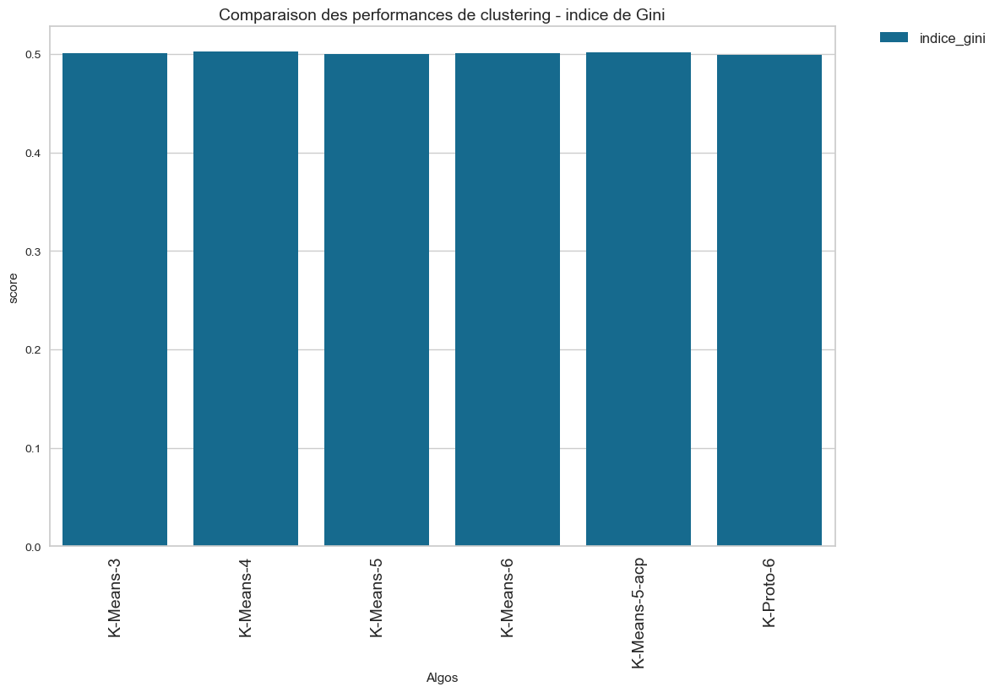

In [53]:
# Visualisation de l'indice de Gini
# ---------------------------------------------------------------------
# Comparaison visuelle des algorithmes
comparaison_perf_melt = pd.melt(df_resultats_comp, id_vars=['Algos'],
                                value_name='score',
                                value_vars=['indice_gini'])
# Visualisation
plt.figure(figsize=(12, 8))
sns.barplot(x=comparaison_perf_melt['Algos'],
            y=comparaison_perf_melt['score'],
            hue=comparaison_perf_melt['variable'])
plt.title('Comparaison des performances de clustering - indice de Gini',
          fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=12)
plt.xticks(rotation=90, fontsize=14)
plt.show()

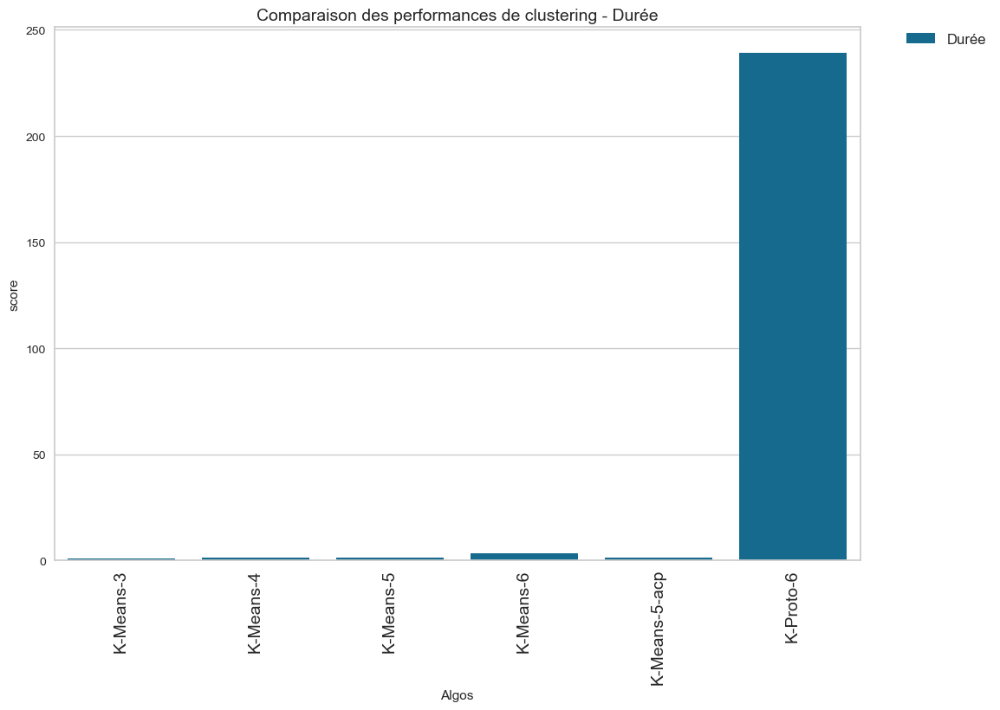

In [54]:
# Visualisation de la durée entraînement + prédiction
# ---------------------------------------------------------------------
# Comparaison visuelle des 7 algorithmes
comparaison_perf_melt = pd.melt(df_resultats_comp, id_vars=['Algos'],
                                value_name='score',
                                value_vars=['Durée'])
# Visualisation
plt.figure(figsize=(12, 8))
sns.barplot(x=comparaison_perf_melt['Algos'],
            y=comparaison_perf_melt['score'],
            hue=comparaison_perf_melt['variable'])
plt.title('Comparaison des performances de clustering - Durée',
          fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=12)
plt.xticks(rotation=90, fontsize=14)
plt.show()

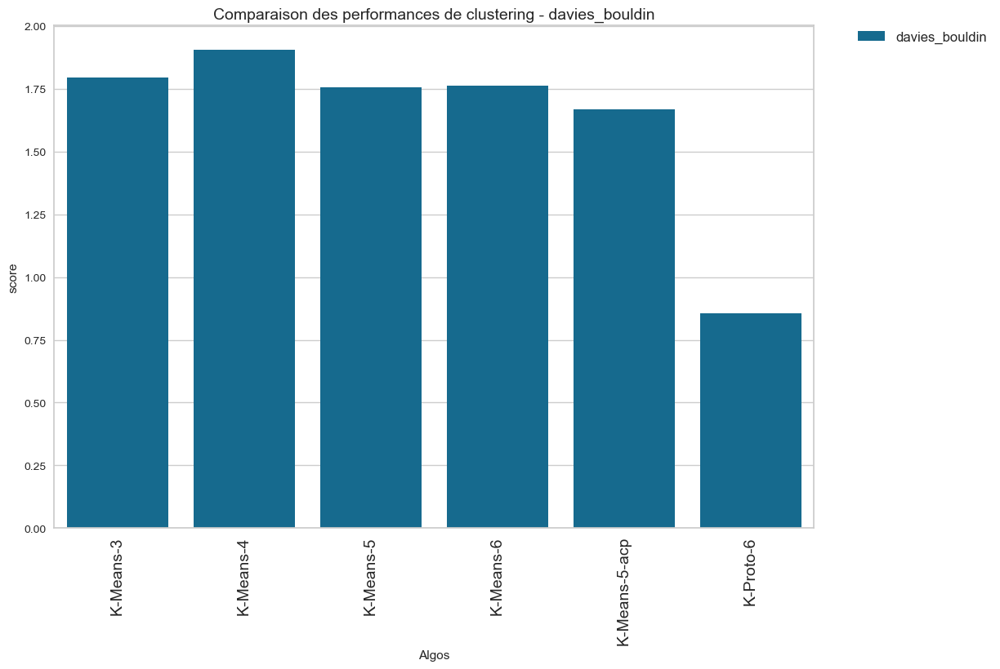

In [57]:
# Visualisation de la durée entraînement + prédiction
# ---------------------------------------------------------------------
# Comparaison visuelle des 7 algorithmes
comparaison_perf_melt = pd.melt(df_resultats_comp, id_vars=['Algos'],
                                value_name='score',
                                value_vars=['davies_bouldin'])
# Visualisation
plt.figure(figsize=(12, 8))
sns.barplot(x=comparaison_perf_melt['Algos'],
            y=comparaison_perf_melt['score'],
            hue=comparaison_perf_melt['variable'])
plt.title('Comparaison des performances de clustering - davies_bouldin',
          fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=12)
plt.xticks(rotation=90, fontsize=14)
plt.show()

## <span style='background:lightblue'>6. Stabilité d'initialisation du partitionnement</span>

In [58]:
# Dataframe de sauvegarde des scores ARI de stabilité d'initialisation
df_stabilite_init = pd.DataFrame()

In [60]:
model = KMeans(n_clusters=3,
               init='k-means++')
# Score de stabilité d'initialisation
df_stabilite_init = \
    fonctions_segmentation.calcul_stabilite_initialisation('K-Means-3',
                                                        model,
                                                        X_scaled_log,
                                                        df_stabilite_init)
df_stabilite_init.style.hide_index()

Algos,ARI_mean,ARI_std
K-Means-3,1.000000,0.000000


In [61]:
model = KMeans(n_clusters=4,
               init='k-means++',
               random_state=seed)
# Score de stabilité d'initialisation
df_stabilite_init = \
    fonctions_segmentation.calcul_stabilite_initialisation('K-Means-4',
                                                        model,
                                                        X_scaled_log,
                                                        df_stabilite_init)
df_stabilite_init.style.hide_index()

Algos,ARI_mean,ARI_std
K-Means-3,1.000000,0.000000
K-Means-4,1.000000,0.000000


In [62]:
model = KMeans(n_clusters=5,
               init='k-means++',
               random_state=seed)
# Score de stabilité d'initialisation
df_stabilite_init = \
    fonctions_segmentation.calcul_stabilite_initialisation('K-Means-5',
                                                        model,
                                                        X_scaled_log,
                                                        df_stabilite_init)
df_stabilite_init.style.hide_index()

Algos,ARI_mean,ARI_std
K-Means-3,1.000000,0.000000
K-Means-4,1.000000,0.000000
K-Means-5,1.000000,0.000000


In [63]:
model = KMeans(n_clusters=6,
               n_init = 20,
               init='k-means++',
               random_state=seed)
# Score de stabilité d'initialisation
df_stabilite_init = \
    fonctions_segmentation.calcul_stabilite_initialisation('K-Means-6',
                                                        model,
                                                        X_scaled_cat,
                                                        df_stabilite_init)
df_stabilite_init.style.hide_index()

Algos,ARI_mean,ARI_std
K-Means-3,1.000000,0.000000
K-Means-4,1.000000,0.000000
K-Means-5,1.000000,0.000000
K-Means-6,1.000000,0.000000


In [64]:
model = KMeans(n_clusters=5,
               init='k-means++')
# Score de stabilité d'initialisation
df_stabilite_init = \
    fonctions_segmentation.calcul_stabilite_initialisation('K-Means-5-acp',
                                                        model,
                                                        df_clients_acp,
                                                        df_stabilite_init)
df_stabilite_init.style.hide_index()

Algos,ARI_mean,ARI_std
K-Means-3,1.000000,0.000000
K-Means-4,1.000000,0.000000
K-Means-5,1.000000,0.000000
K-Means-6,1.000000,0.000000
K-Means-5-acp,0.994410,0.005584


In [70]:
model = KPrototypes(n_clusters=6,
                    init='Cao',
                    n_jobs=-1)
# Score de stabilité d'initialisation
df_stabilite_init = \
     fonctions_segmentation.calcul_stabilite_init_kproto('K-Proto-6',
                                                      model,
                                                      cols_categorical,
                                                      data_comp_kproto,
                                                      df_stabilite_init)
df_stabilite_init.style.hide_index()

Evaluation of stability upon random initialization:        100.0%  ± 0.0% 


Algos,ARI_mean,ARI_std
K-Means-3,1.000000,0.000000
K-Means-4,1.000000,0.000000
K-Means-5,1.000000,0.000000
K-Means-6,1.000000,0.000000
K-Means-5-acp,0.994410,0.005584
K-Proto-6,0.976857,0.029878
K-Proto-6,1.000000,0.000000


### <span style='background:aquamarine'>6.1 Visualisations des stabilités de partitionnement </span>

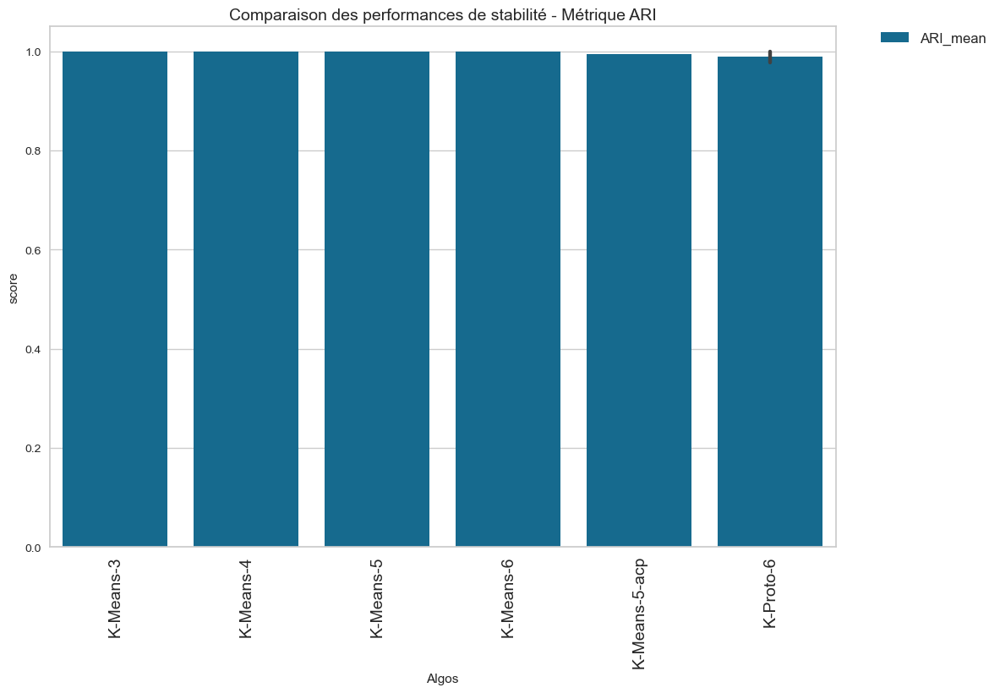

In [71]:
# Visualisation des nombres de clusters
# --------------------------------------------------------------------
# Comparaison visuelle des 7 algorithmes
comparaison_perf_melt = pd.melt(df_stabilite_init, id_vars=['Algos'],
                                value_name='score',
                                value_vars=['ARI_mean'])
# Visualisation
plt.figure(figsize=(12, 8))
sns.barplot(x=comparaison_perf_melt['Algos'],
            y=comparaison_perf_melt['score'],
            hue=comparaison_perf_melt['variable'])
plt.title('Comparaison des performances de stabilité - Métrique ARI',
          fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=12)
plt.xticks(rotation=90, fontsize=14)
plt.show()

## <span style='background:lightblue'>7. Stabilité des clusters au cours du temps</span>

In [38]:
# Copie du jeu de données
df_stab = data.copy()
df_stab = df_stab.reset_index()

In [39]:
# Détermination des dates de référence
# ---------------------------------------------------------------------
# Date de référence de la période complète ?
date_reference = df_stab['date_dernier_achat'].max()
print(f'Data de référence période complète : {date_reference}')
# Data de référence transformée
date_reference = pd.to_datetime(date_reference,
                                format='%Y-%m-%d %H:%M:%S')
# Data de référence de la première période historique - 1 mois
data_ref_1mois = date_reference - pd.DateOffset(months=1)
print(f'Data de référence histo - 1 mois : {data_ref_1mois}')
# Data de référence de la première période historique - 2 mois
data_ref_2mois = date_reference - pd.DateOffset(months=2)
print(f'Data de référence histo - 2 mois : {data_ref_2mois}')
# Data de référence de la première période historique - 3 mois
data_ref_3mois = date_reference - pd.DateOffset(months=3)
print(f'Data de référence histo - 3 mois : {data_ref_3mois}')
# Data de référence de la première période historique - 4 mois
data_ref_4mois = date_reference - pd.DateOffset(months=4)
print(f'Data de référence histo - 4 mois : {data_ref_2mois}')
# Data de référence de la première période historique - 5 mois
data_ref_5mois = date_reference - pd.DateOffset(months=5)
print(f'Data de référence histo - 5 mois : {data_ref_2mois}')
# Data de référence de la première période historique - 6 mois
data_ref_6mois = date_reference - pd.DateOffset(months=6)
print(f'Data de référence histo - 6 mois : {data_ref_6mois}')
# Data de référence de la première période historique - 7 mois
data_ref_7mois = date_reference - pd.DateOffset(months=7)
print(f'Data de référence histo - 7 mois : {data_ref_7mois}')
# Data de référence de la première période historique - 8 mois
data_ref_8mois = date_reference - pd.DateOffset(months=8)
print(f'Data de référence histo - 8 mois : {data_ref_8mois}')
# Data de référence de la première période historique - 9 mois
data_ref_9mois = date_reference - pd.DateOffset(months=9)
print(f'Data de référence histo - 9 mois : {data_ref_9mois}')
# Data de référence de la première période historique - 10 mois
data_ref_10mois = date_reference - pd.DateOffset(months=10)
print(f'Data de référence histo - 10 mois : {data_ref_10mois}')
# Data de référence de la première période historique - 11 mois
data_ref_11mois = date_reference - pd.DateOffset(months=11)
print(f'Data de référence histo - 11 mois : {data_ref_11mois}')
# Data de référence de la première période historique - 1 an
data_ref_12mois = date_reference - pd.DateOffset(months=12)
print(f'Data de référence histo - 1 an : {data_ref_12mois}')

Data de référence période complète : 2018-08-29 15:00:37
Data de référence histo - 1 mois : 2018-07-29 15:00:37
Data de référence histo - 2 mois : 2018-06-29 15:00:37
Data de référence histo - 3 mois : 2018-05-29 15:00:37
Data de référence histo - 4 mois : 2018-06-29 15:00:37
Data de référence histo - 5 mois : 2018-06-29 15:00:37
Data de référence histo - 6 mois : 2018-02-28 15:00:37
Data de référence histo - 7 mois : 2018-01-29 15:00:37
Data de référence histo - 8 mois : 2017-12-29 15:00:37
Data de référence histo - 9 mois : 2017-11-29 15:00:37
Data de référence histo - 10 mois : 2017-10-29 15:00:37
Data de référence histo - 11 mois : 2017-09-29 15:00:37
Data de référence histo - 1 an : 2017-08-29 15:00:37


### <span style='background:aquamarine'>7.1 Stabilité KMeans 6 clusters sur 1 an</span>

In [40]:
# Dataframe de sauvegarde des métriques de stabilité du dataframe
df_resultats_km = pd.DataFrame({})

In [42]:
# Score de stabilité ARI sur la période juillet-août 2018 - 1 mois
df_resultats_km, df_hist_1mois, df_ref_1mois = \
    fonctions_segmentation.segmentation_kmean_periode(df_stab,
                               df_resultats_km,
                               data_ref_1mois,
                               '1 mois_Juillet_août',
                               6)

In [43]:
# Score de stabilité ARI sur la période juin-août 2018 - 2 mois
df_resultats_km, df_hist_2mois, df_ref_2mois = \
    fonctions_segmentation.segmentation_kmean_periode(df_stab,
                               df_resultats_km,
                               data_ref_2mois,
                               '2 mois_Juin_août',
                               6)

In [44]:
# Score de stabilité ARI sur la période mai-août 2018 - 3 mois
df_resultats_km, df_hist_3mois, df_ref_3mois = \
    fonctions_segmentation.segmentation_kmean_periode(df_stab,
                               df_resultats_km,
                               data_ref_3mois,
                               '3 mois_Mai_août',
                               6)

In [45]:
# Score de stabilité ARI sur la période Avril-août 2018 - 4 mois
df_resultats_km, df_hist_4mois, df_ref_4mois = \
    fonctions_segmentation.segmentation_kmean_periode(df_stab,
                               df_resultats_km,
                               data_ref_4mois,
                               '4 mois_Avril_août',
                               6)

In [46]:
# Score de stabilité ARI sur la période mars-août 2018 - 5 mois
df_resultats_km, df_hist_5mois, df_ref_5mois = \
    fonctions_segmentation.segmentation_kmean_periode(df_stab,
                               df_resultats_km,
                               data_ref_5mois,
                               '5 mois_Mars_août',
                               6)

In [47]:
# Score de stabilité ARI sur la période février-août 2018 - 6 mois
df_resultats_km, df_hist_6mois, df_ref_6mois = \
    fonctions_segmentation.segmentation_kmean_periode(df_stab,
                               df_resultats_km,
                               data_ref_6mois,
                               '6 mois_Février_août',
                               6)

In [48]:
# Score de stabilité ARI sur la période janvier-août 2018 - 7 mois
df_resultats_km, df_hist_7mois, df_ref_7mois = \
    fonctions_segmentation.segmentation_kmean_periode(df_stab,
                               df_resultats_km,
                               data_ref_7mois,
                               '7 mois_Janvier_août',
                                6)

In [49]:
# Score de stabilité ARI sur la période décembre-août 2018 - 8 mois
df_resultats_km, df_hist_8mois, df_ref_8mois = \
    fonctions_segmentation.segmentation_kmean_periode(df_stab,
                               df_resultats_km,
                               data_ref_8mois,
                               '8 mois_Décembre_août',
                               6)

In [50]:
# Score de stabilité ARI sur la période novembre-août 2018 - 9 mois
df_resultats_km, df_hist_9mois, df_ref_9mois = \
    fonctions_segmentation.segmentation_kmean_periode(df_stab,
                               df_resultats_km,
                               data_ref_9mois,
                               '9 mois_Novembre_août',
                               6)

In [51]:
# Score de stabilité ARI sur la période octobre-août 2018 - 10 mois
df_resultats_km, df_hist_10mois, df_ref_10mois = \
    fonctions_segmentation.segmentation_kmean_periode(df_stab,
                               df_resultats_km,
                               data_ref_10mois,
                               '10 mois_Octobre_août',
                               6)

In [52]:
# Score de stabilité ARI sur la période septembre-août 2018 - 11 mois
df_resultats_km, df_hist_11mois, df_ref_11mois = \
    fonctions_segmentation.segmentation_kmean_periode(df_stab,
                               df_resultats_km,
                               data_ref_11mois,
                               '11 mois_Septembre_août',
                               6)

In [53]:
# Score de stabilité ARI sur la période septembre 2017 -août 2018 - 1
df_resultats_km, df_hist_1an, df_ref_1an = \
    fonctions_segmentation.segmentation_kmean_periode(df_stab,
                               df_resultats_km,
                               data_ref_12mois,
                               '1an_aout17_août18',
                               6)

In [54]:
df_resultats_km.style.hide_index()

Periode,Date,ARI (%)
1 mois_Juillet_août,2018-07-29 15:00:37,99.432000
2 mois_Juin_août,2018-06-29 15:00:37,85.332000
3 mois_Mai_août,2018-05-29 15:00:37,92.047000
4 mois_Avril_août,2018-04-29 15:00:37,95.910000
5 mois_Mars_août,2018-03-29 15:00:37,98.972000
6 mois_Février_août,2018-02-28 15:00:37,89.950000
7 mois_Janvier_août,2018-01-29 15:00:37,98.872000
8 mois_Décembre_août,2017-12-29 15:00:37,68.342000
9 mois_Novembre_août,2017-11-29 15:00:37,98.375000
10 mois_Octobre_août,2017-10-29 15:00:37,90.061000


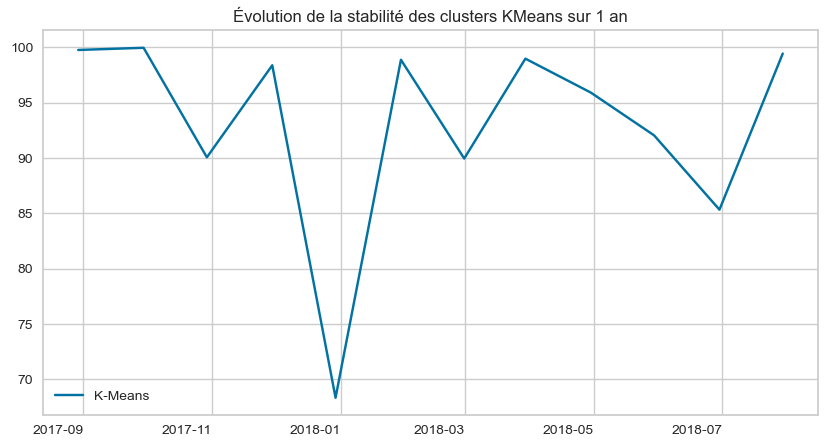

In [56]:
# Visualisation graphique
plt.figure(figsize=(10, 5))
x = df_resultats_km['Date']
plt.plot(df_resultats_km['Date'], df_resultats_km['ARI (%)'], label='K-Means')
plt.legend()
plt.title('Évolution de la stabilité des clusters KMeans sur 1 an')
plt.xticks(rotation='horizontal', horizontalalignment="right")

plt.show()

**Bilan** :
***
- KMeans est moins stable sur les 4 premiers mois et plus stable sur les 6 mois suivants

### <span style='background:aquamarine'>7.2  Stabilité K-Prototype 6 clusters sur 1 an</span>

In [89]:
# Dataframe de sauvegarde des métriques de stabilité du dataframe
df_resultats_kp = pd.DataFrame({})

In [92]:
# Score de stabilité ARI sur la période juillet-août 2018 - 1 mois
df_resultats_kp, df_hist_1mois_kp, df_ref_1mois_kp = \
    fonctions_segmentation.segmentation_kproto_periode(df_stab,
                                df_resultats_kp,
                                data_ref_1mois,
                                '1 mois_Juillet_août',
                                6)

In [93]:
# Score de stabilité ARI sur la période juin-août 2018 - 2 mois
df_resultats_kp, df_hist_2mois_kp, df_ref_2mois_kp = \
    fonctions_segmentation.segmentation_kproto_periode(df_stab,
                                df_resultats_kp,
                                data_ref_2mois,
                                '2 mois_Juin_août',
                                6)

In [94]:
# Score de stabilité ARI sur la période mai-août 2018 - 3 mois
df_resultats_kp, df_hist_3mois_kp, df_ref_3mois_kp = \
    fonctions_segmentation.segmentation_kproto_periode(df_stab,
                                df_resultats_kp,
                                data_ref_3mois,
                                '3 mois_Mai_août',
                                6)

In [95]:
# Score de stabilité ARI sur la période Avril-août 2018 - 4 mois
df_resultats_kp, df_hist_4mois_kp, df_ref_4mois_kp = \
    fonctions_segmentation.segmentation_kproto_periode(df_stab,
                                df_resultats_kp,
                                data_ref_4mois,
                                '4 mois_Avril_août',
                                6)

In [96]:
# Score de stabilité ARI sur la période mars-août 2018 - 5 mois
df_resultats_kp, df_hist_5mois_kp, df_ref_5mois_kp = \
    fonctions_segmentation.segmentation_kproto_periode(df_stab,
                                df_resultats_kp,
                                data_ref_5mois,
                                '5 mois_Mars_août',
                                6)

In [97]:
# Score de stabilité ARI sur la période février-août 2018 - 6 mois
df_resultats_kp, df_hist_6mois_kp, df_ref_6mois_kp = \
    fonctions_segmentation.segmentation_kproto_periode(df_stab,
                                df_resultats_kp,
                                data_ref_6mois,
                                '6 mois_Février_août',
                                6)

In [98]:
# Score de stabilité ARI sur la période janvier-août 2018 - 7 mois
df_resultats_kp, df_hist_7mois_kp, df_ref_7mois_kp = \
    fonctions_segmentation.segmentation_kproto_periode(df_stab,
                                df_resultats_kp,
                                data_ref_7mois,
                                '7 mois_Janvier_août',
                                6)

In [99]:
# Score de stabilité ARI sur la période décembre-août 2018 - 8 mois
df_resultats_kp, df_hist_8mois_kp, df_ref_8mois_kp = \
    fonctions_segmentation.segmentation_kproto_periode(df_stab,
                                df_resultats_kp,
                                data_ref_8mois,
                                '8 mois_Décembre_août',
                                6)

In [100]:
# Score de stabilité ARI sur la période novembre-août 2018 - 9 mois
df_resultats_kp, df_hist_9mois_kp, df_ref_9mois_kp = \
    fonctions_segmentation.segmentation_kproto_periode(df_stab,
                                df_resultats_kp,
                                data_ref_9mois,
                                '9 mois_Novembre_août',
                                6)

In [101]:
# Score de stabilité ARI sur la période octobre-août 2018 - 10 mois
df_resultats_kp, df_hist_10mois_kp, df_ref_10mois_kp = \
    fonctions_segmentation.segmentation_kproto_periode(df_stab,
                                df_resultats_kp,
                                data_ref_10mois,
                                '10 mois_Octobre_août',
                                6)

In [102]:
# Score de stabilité ARI sur la période septembre-août 2018 - 11 mois
df_resultats_kp, df_hist_11mois_kp, df_ref_11mois_kp = \
    fonctions_segmentation.segmentation_kproto_periode(df_stab,
                                df_resultats_kp,
                                data_ref_11mois,
                                '11 mois_Septembre_août',
                                6)

In [103]:
# Score de stabilité ARI sur la période septembre 2017 -août 2018 - 1
df_resultats_kp, df_hist_1an_kp, df_ref_1an_kp = \
    fonctions_segmentation.segmentation_kproto_periode(df_stab,
                                df_resultats_kp,
                                data_ref_12mois,
                                '1an_aout17_août18',
                                6)

In [104]:
df_resultats_kp.style.hide_index()

Periode,Date,ARI (%)
1 mois_Juillet_août,2018-07-29 15:00:37,62.309000
1 mois_Juillet_août,2018-07-29 15:00:37,74.499000
2 mois_Juin_août,2018-06-29 15:00:37,88.276000
3 mois_Mai_août,2018-05-29 15:00:37,99.047000
4 mois_Avril_août,2018-04-29 15:00:37,87.515000
5 mois_Mars_août,2018-03-29 15:00:37,65.326000
6 mois_Février_août,2018-02-28 15:00:37,99.343000
7 mois_Janvier_août,2018-01-29 15:00:37,100.000000
8 mois_Décembre_août,2017-12-29 15:00:37,93.425000
9 mois_Novembre_août,2017-11-29 15:00:37,69.563000


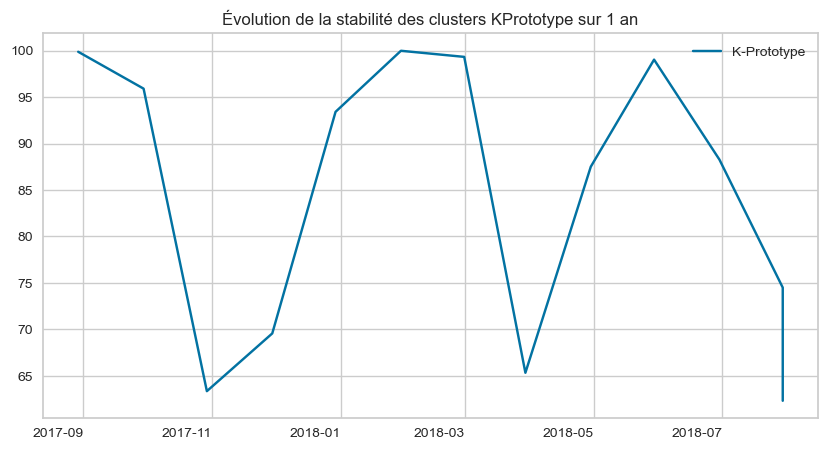

In [105]:
# Visualisation graphique
plt.figure(figsize=(10, 5))
x = df_resultats_km['Date']
plt.plot(df_resultats_kp['Date'], df_resultats_kp['ARI (%)'],
         label='K-Prototype')
plt.legend()
plt.title('Évolution de la stabilité des clusters KPrototype sur 1 an')
plt.xticks(rotation='horizontal', horizontalalignment="right")

plt.show()

- L'algo K-Prototype est moins stable que le K-Means sur l'ensemble de la période, hormis les 3 derniers mois.

### <span style='background:aquamarine'>7.3  Stabilité Clustering RFM sur 1 an</span>

In [57]:
# Dataframe de sauvegarde des métriques de stabilité du dataframe
df_resultats_rfm = pd.DataFrame({})

In [58]:
rfm = pd.read_csv('OLIST_data_RFM.csv')

In [59]:
# Création du datframe de segmentation RFM
df_segm_rfm = rfm.copy()

In [60]:
qtiles = df_segm_rfm[['rfm_recence', 'rfm_frequence','rfm_montant']].quantile([.2, .4, .6, .8]).to_dict()
qtiles

{'rfm_recence': {0.2: 91.0, 0.4: 176.0, 0.6: 268.0, 0.8: 381.0},
 'rfm_frequence': {0.2: 1.0, 0.4: 1.0, 0.6: 1.0, 0.8: 1.0},
 'rfm_montant': {0.2: 56.01,
  0.4: 89.74599999999998,
  0.6: 139.96400000000003,
  0.8: 238.4}}

In [62]:
df_segm_rfm['R'] = df_segm_rfm['rfm_recence'].apply(fonctions_segmentation.r_score, args=('rfm_recence', qtiles))
df_segm_rfm['F'] = df_segm_rfm['rfm_frequence'].apply(fonctions_segmentation.fm_score, args=('rfm_frequence', qtiles))
df_segm_rfm['M'] = df_segm_rfm['rfm_montant'].apply(fonctions_segmentation.fm_score, args=('rfm_montant', qtiles))

In [63]:
# Concaténation des groupes R, F et M ==> segment du client
# ------------------------------------------------------------------------
df_segm_rfm['RFM_Segment'] = df_segm_rfm.apply(lambda x: str(x['R']) +
                                               str(x['F']) + str(x['M']),
                                               axis=1)

In [64]:
df_segm_rfm['RFM Score'] = df_segm_rfm['R'].map(str) + df_segm_rfm['F'].map(str) + df_segm_rfm['M'].map(str)
df_segm_rfm.head()

,customer_unique_id,rfm_recence,rfm_frequence,rfm_montant,R,F,M,RFM_Segment,RFM Score
0,0000366f3b9a7992bf8c76cfdf3221e2,112,1,141.90,4,1,4,414,414
1,0000b849f77a49e4a4ce2b2a4ca5be3f,115,1,27.19,4,1,1,411,411
2,0000f46a3911fa3c0805444483337064,537,1,86.22,1,1,2,112,112
3,0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62,2,1,1,211,211
4,0004aac84e0df4da2b147fca70cf8255,288,1,196.89,2,1,4,214,214


In [65]:
# Calcul du score
# ------------------------------------------------------------------------
df_segm_rfm['RFM_Score'] = df_segm_rfm[['R', 'F', 'M']].sum(axis=1)
df_segm_rfm.head()

,customer_unique_id,rfm_recence,rfm_frequence,rfm_montant,R,F,M,RFM_Segment,RFM Score,RFM_Score
0,0000366f3b9a7992bf8c76cfdf3221e2,112,1,141.90,4,1,4,414,414,9
1,0000b849f77a49e4a4ce2b2a4ca5be3f,115,1,27.19,4,1,1,411,411,6
2,0000f46a3911fa3c0805444483337064,537,1,86.22,1,1,2,112,112,4
3,0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62,2,1,1,211,211,4
4,0004aac84e0df4da2b147fca70cf8255,288,1,196.89,2,1,4,214,214,7


In [66]:
# Calcul de la moyenne de chacune des variables RFM par RFM_Score
# ------------------------------------------------------------------------

df_segm_rfm_agg = df_segm_rfm.groupby('RFM_Score').agg({
    'rfm_recence' : 'mean',
    'rfm_frequence' : 'mean',
    'rfm_montant' : ['mean', 'count']
})
display(df_segm_rfm_agg)

rfm_recence rfm_frequence rfm_montant       
                 mean          mean        mean  count
RFM_Score                                             
3          475.164519      1.000000   39.847159   3647
4          395.474037      1.000000   56.841349   6856
5          329.249836      1.000000   73.079503  10667
6          279.052147      1.000000   98.358778  13155
7          216.075939      1.012862  151.607204  15394
8          168.019609      1.040515  181.412054  12341
9          135.550915      1.091637  208.510518   9123
10         129.072562      1.227084  280.560156   6491
11         230.066608      1.887668  511.185390   4549
12         263.060245      2.598736  653.637531   2689
13         181.442370      2.532062  580.491903   2464
14         111.655141      2.635833  712.515882   2227
15          47.242066      2.813939  848.951493   1607

In [69]:
# RFM Score
df_segm_rfm["Segment"] = df_segm_rfm.apply(fonctions_segmentation.calculate_segments, axis=1)

In [70]:
df_segm_rfm.head()

,customer_unique_id,rfm_recence,rfm_frequence,rfm_montant,R,F,M,RFM_Segment,RFM Score,RFM_Score,Segment
0,0000366f3b9a7992bf8c76cfdf3221e2,112,1,141.90,4,1,4,414,414,9,Recent Customers
1,0000b849f77a49e4a4ce2b2a4ca5be3f,115,1,27.19,4,1,1,411,411,6,Potential Loyalist
2,0000f46a3911fa3c0805444483337064,537,1,86.22,1,1,2,112,112,4,Lost customers
3,0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62,2,1,1,211,211,4,About to Sleep
4,0004aac84e0df4da2b147fca70cf8255,288,1,196.89,2,1,4,214,214,7,Others


In [2]:
# Score de stabilité ARI sur la période juillet-août 2018 - 1 mois
df_resultats_rfm, df_hist_1mois_rfm, df_ref_1mois_rfm = \
    fonctions_segmentation.segmentation_rfm_periode(df_stab, 
                               df_segm_rfm,
                               df_resultats_rfm,
                               'date_dernier_achat',
                               'rfm_frequence',
                               'rfm_montant',
                                df_ref_1mois,
                               '1 mois_Juillet_août')

In [74]:
# Score de stabilité ARI sur la période juin-août 2018 - 2 mois
df_resultats_rfm, df_hist_2mois_rfm, df_ref_2mois_rfm = \
    fonctions_segmentation.segmentation_rfm_periode(df_stab,
                               df_segm_rfm,
                               df_resultats_rfm,
                               'date_dernier_achat',
                               'rfm_frequence',
                               'rfm_montant',
                                data_ref_2mois,
                               '2 mois_Juin_août')

In [75]:
# Score de stabilité ARI sur la période mai-août 2018 - 3 mois
df_resultats_rfm, df_hist_3mois_rfm, df_ref_3mois_rfm = \
    fonctions_segmentation.segmentation_rfm_periode(df_stab,
                               df_segm_rfm,
                               df_resultats_rfm,
                               'date_dernier_achat',
                               'rfm_frequence',
                               'rfm_montant',
                                data_ref_3mois,
                               '3 mois_Mai_août')

In [76]:
# Score de stabilité ARI sur la période Avril-août 2018 - 4 mois
df_resultats_rfm, df_hist_4mois_rfm, df_ref_4mois_rfm = \
    fonctions_segmentation.segmentation_rfm_periode(df_stab,
                               df_segm_rfm,
                               df_resultats_rfm,
                               'date_dernier_achat',
                               'rfm_frequence',
                               'rfm_montant',
                                data_ref_4mois,
                               '4 mois_Avril_août')

In [77]:
# Score de stabilité ARI sur la période Mars-août 2018 - 5 mois
df_resultats_rfm, df_hist_5mois_rfm, df_ref_5mois_rfm = \
    fonctions_segmentation.segmentation_rfm_periode(df_stab,
                               df_segm_rfm,
                               df_resultats_rfm,
                               'date_dernier_achat',
                               'rfm_frequence',
                               'rfm_montant',
                                data_ref_5mois,
                               '5 mois_Mars_août')

In [78]:
# Score de stabilité ARI sur la période Fevrier-août 2018 - 6 mois
df_resultats_rfm, df_hist_6mois_rfm, df_ref_6mois_rfm = \
    fonctions_segmentation.segmentation_rfm_periode(df_stab,
                               df_segm_rfm,
                               df_resultats_rfm,
                               'date_dernier_achat',
                               'rfm_frequence',
                               'rfm_montant',
                                data_ref_6mois,
                               '6 mois_Fevrier_août')

In [79]:
# Score de stabilité ARI sur la période Janvier-août 2018 - 7 mois
df_resultats_rfm, df_hist_7mois_rfm, df_ref_7mois_rfm = \
    fonctions_segmentation.segmentation_rfm_periode(df_stab,
                               df_segm_rfm,
                               df_resultats_rfm,
                               'date_dernier_achat',
                               'rfm_frequence',
                               'rfm_montant',
                                data_ref_7mois,
                               '7 mois_Janvier_août')

In [80]:
# Score de stabilité ARI sur la période Décembre-août 2018 - 8 mois
df_resultats_rfm, df_hist_8mois_rfm, df_ref_8mois_rfm = \
    fonctions_segmentation.segmentation_rfm_periode(df_stab,
                               df_segm_rfm,
                               df_resultats_rfm,
                               'date_dernier_achat',
                               'rfm_frequence',
                               'rfm_montant',
                                data_ref_8mois,
                               '8 mois_Décembre_août')

In [81]:
# Score de stabilité ARI sur la période Novembre-août 2018 - 9 mois
df_resultats_rfm, df_hist_9mois_rfm, df_ref_9mois_rfm = \
    fonctions_segmentation.segmentation_rfm_periode(df_stab,
                               df_segm_rfm,
                               df_resultats_rfm,
                               'date_dernier_achat',
                               'rfm_frequence',
                               'rfm_montant',
                                data_ref_9mois,
                               '9 mois_Novembre_août')

In [82]:
# Score de stabilité ARI sur la période Octobre-août 2018 - 10 mois
df_resultats_rfm, df_hist_10mois_rfm, df_ref_10mois_rfm = \
    fonctions_segmentation.segmentation_rfm_periode(df_stab,
                               df_segm_rfm,
                               df_resultats_rfm,
                               'date_dernier_achat',
                               'rfm_frequence',
                               'rfm_montant',
                                data_ref_10mois,
                               '10 mois_Octobre_août')

In [83]:
# Score de stabilité ARI sur la période Septembre-août 2018 - 11 mois
df_resultats_rfm, df_hist_10mois_rfm, df_ref_10mois_rfm = \
    fonctions_segmentation.segmentation_rfm_periode(df_stab,
                               df_segm_rfm,
                               df_resultats_rfm,
                               'date_dernier_achat',
                               'rfm_frequence',
                               'rfm_montant',
                                data_ref_10mois,
                               '10 mois_Septembre_août')

In [84]:
# Score de stabilité ARI sur la période Septembre 2017 - août 2018 - 1 an 
df_resultats_rfm, df_hist_1an_rfm, df_ref_1an_rfm = \
    fonctions_segmentation.segmentation_rfm_periode(df_stab,
                               df_segm_rfm,
                               df_resultats_rfm,
                               'date_dernier_achat',
                               'rfm_frequence',
                               'rfm_montant',
                                data_ref_12mois,
                               '1an_aout17_août18')

In [85]:
df_resultats_rfm.style.hide_index()

Periode,Date,ARI (%)
2 mois_Juin_août,2018-06-29 15:00:37,54.741000
2 mois_Juin_août,2018-06-29 15:00:37,54.741000
3 mois_Mai_août,2018-05-29 15:00:37,57.396000
4 mois_Avril_août,2018-04-29 15:00:37,58.648000
5 mois_Mars_août,2018-03-29 15:00:37,53.952000
6 mois_Fevrier_août,2018-02-28 15:00:37,51.795000
7 mois_Janvier_août,2018-01-29 15:00:37,58.795000
8 mois_Décembre_août,2017-12-29 15:00:37,44.756000
9 mois_Novembre_août,2017-11-29 15:00:37,43.309000
10 mois_Octobre_août,2017-10-29 15:00:37,41.470000


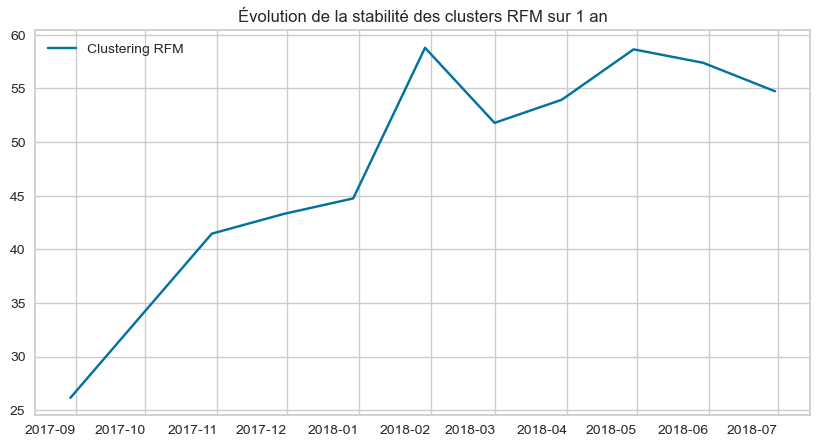

In [86]:
# Visualisation graphique
plt.figure(figsize=(10, 5))
x = df_resultats_rfm['Date']
plt.plot(df_resultats_rfm['Date'], df_resultats_rfm['ARI (%)'],
         label='Clustering RFM')
plt.legend()
plt.title('Évolution de la stabilité des clusters RFM sur 1 an')
plt.xticks(rotation='horizontal', horizontalalignment="right")

plt.show()

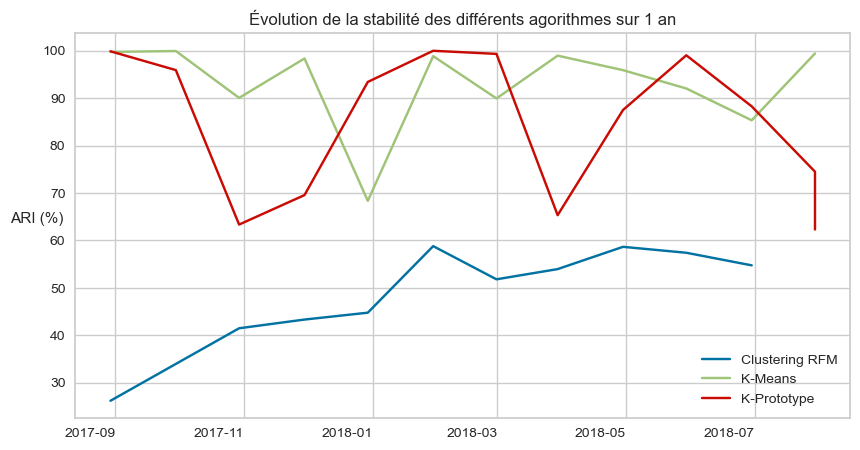

In [112]:
# Visualisation graphique
plt.figure(figsize=(10, 5))
x = df_resultats_rfm['Date']
plt.plot(df_resultats_rfm['Date'], df_resultats_rfm['ARI (%)'], label='Clustering RFM')
plt.plot(df_resultats_km['Date'], df_resultats_km['ARI (%)'], label='K-Means')
plt.plot(df_resultats_kp['Date'], df_resultats_kp['ARI (%)'], label='K-Prototype')
plt.legend()
plt.title('Évolution de la stabilité des différents agorithmes sur 1 an')
plt.xticks(rotation='horizontal', horizontalalignment="right")
plt.ylabel('ARI (%)', rotation='horizontal')
plt.show()

**Constat:**

  > - L'algorithme le plus stable est celui du **K-Means (6 clusters)**, par rapport au **K-Prototype**, et celui du du **clustering RFM** traditionnel;
  > - Proposition d'un **contrat de maintenance**, avec une mise à jour des fréquences trimestrielle **(3 mois)**. 